In [3]:
# 导入数据处理相关的库
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# 导入Sklearn相关的库和模块
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc, roc_auc_score
from sklearn.model_selection import GridSearchCV, cross_val_score, train_test_split, cross_validate, StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.exceptions import DataConversionWarning
from sklearn.utils import shuffle

# 导入其他工具
import joblib
import warnings

# 忽略特定类型的警告
warnings.filterwarnings("ignore", category=DataConversionWarning)

In [4]:
# 导入Pandas库用于数据处理（前面已经导入）
import pandas as pd
from sklearn.model_selection import StratifiedKFold

# 读取训练集数据
data = pd.read_csv('MGAM-train-ECFP4.csv')
# 读取测试集数据
data2 = pd.read_csv('MGAM-test-ECFP4.csv')

# 从训练数据中分离出特征（从第三列开始的所有列）
x_mor_train = data.iloc[:,2:]  # Python中索引从0开始，所以这里是第三列及之后的所有列
# 从训练数据中分离出标签（第二列）
y_mor_train = data.iloc[:,1:2] # 这里使用1:2是为了获取DataFrame格式的输出，而不是Series

# 保存训练集提取出的数据
y_mor_train.to_csv("y_mor_train.csv")
x_mor_train.to_csv("x_mor_train.csv")

# 从测试数据中分离出特征（同样是从第三列开始的所有列）
x_mor_test = data2.iloc[:,2:]
# 从测试数据中分离出标签（第二列）
y_mor_test = data2.iloc[:,1:2]

# 将分离出的训练数据特征和标签分别赋值给X和Y变量
X = x_mor_train # 输入特征
Y = y_mor_train # 对应的目标变量（标签）

# 设置变量存储ECFPs列名，此处似乎没有在后续代码中使用
columns = "ECFP4"

# 初始化StratifiedKFold，进行分层K折交叉验证的设置
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=0)    
# n_splits=5 表示将数据分为5折
# shuffle=True 表示在每次分割前都会对数据进行随机洗牌，以确保数据的随机性
# random_state=0 设置随机种子，确保每次程序执行时划分的结果一致，提高结果的可重复性

### AdaBoost参数搜索

In [27]:
# 导入AdaBoost分类器
from sklearn.ensemble import AdaBoostClassifier # 导入AdaBoost分类器

# 设置AdaBoost分类器的n_estimators参数的搜索范围
n_estimators_range=[int(x) for x in np.linspace(start=10,stop=510,num=100)]

# 定义函数来训练AdaBoost模型，并进行网格搜索寻找最佳参数
def AdaBoostClassifier_model(X,Y):
    # 实例化AdaBoost分类器
    AdaBoostClassifier_auto = AdaBoostClassifier(random_state=0)
    # 定义参数网格
    param_dict = { 
        "n_estimators":n_estimators_range,
        "learning_rate":[0, 0.5, 1, 1.5, 2],
        "algorithm":['SAMME', 'SAMME.R']
    }
    # 实例化GridSearchCV，使用roc_auc作为评分标准
    estimator = GridSearchCV(estimator = AdaBoostClassifier_auto, param_grid=param_dict, cv=cv, n_jobs=-1, scoring = "roc_auc")
    # 训练模型
    estimator.fit(X,Y)
    # 返回最佳参数、最佳分数和最佳模型
    return estimator.best_params_, estimator.best_score_, estimator.best_estimator_

# 调用函数，训练模型，并打印最佳参数和分数
tmp_1, tmp_2, AdaBoostClassifier_auto = AdaBoostClassifier_model(X,Y)
print(tmp_1, tmp_2, AdaBoostClassifier_auto)

{'algorithm': 'SAMME', 'learning_rate': 1.5, 'n_estimators': 474} 0.9587347499495866 AdaBoostClassifier(algorithm='SAMME', learning_rate=1.5, n_estimators=474,
                   random_state=0)


#### 最优参数的混淆矩阵

训练集准确度是0.9652892561983472
测试集准确度是0.9210526315789473


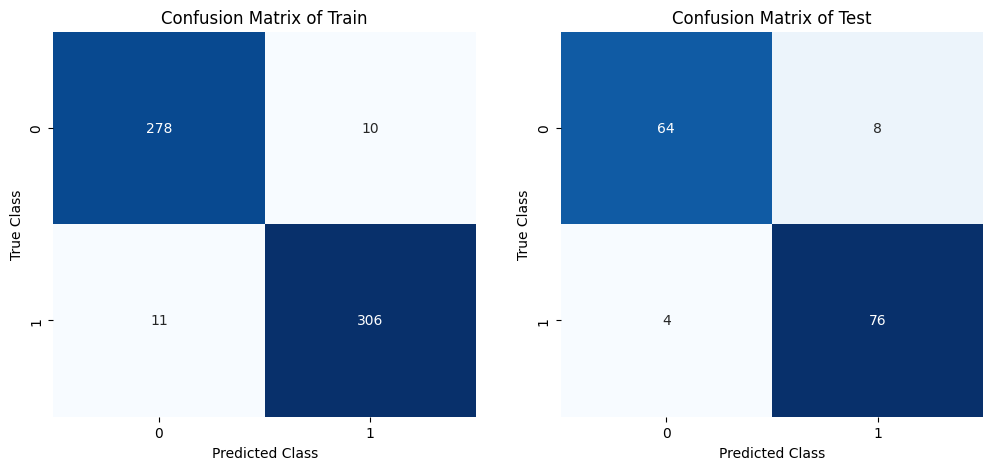

In [28]:
# 设置训练集和测试集的特征和标签
train_X = x_mor_train
train_Y = y_mor_train
test_X = x_mor_test
test_Y = y_mor_test

# 使用找到的最佳参数实例化AdaBoost分类器
Ada = AdaBoostClassifier(random_state = 0,
                         algorithm = 'SAMME',
                         learning_rate = 1.5,
                         n_estimators = 474)

# 训练模型
estimator = Ada
estimator.fit(train_X, train_Y)
# 预测训练集和测试集
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)
# 打印训练集和测试集的准确率
print(f"训练集准确度是{accuracy_score(train_Y, clf_train)}")
print(f"测试集准确度是{accuracy_score(test_Y, clf_test)}")

# 计算训练集和测试集的混淆矩阵
train_matrix = confusion_matrix(train_Y, clf_train)
test_matrix = confusion_matrix(test_Y, clf_test)

# 绘制训练集和测试集的混淆矩阵热图
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)  #创建了一个包含两个子图的图形，排列方式为一行两列
sns.heatmap(train_matrix, annot=True, cmap="Blues", 
            cbar=None, fmt="d")  #cbar=None 就会不显示色条,fmt="d"确保中间现实数字
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Train")

plt.subplot(1, 2, 2)
sns.heatmap(test_matrix, annot=True, cmap="Blues", 
            cbar=None, fmt="d")  #cbar=None 就会不显示色条,fmt="d"确保中间现实数字
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")
plt.savefig("混淆矩阵_Ada.svg", dpi = 600)
plt.show()

#### ROC曲线部分

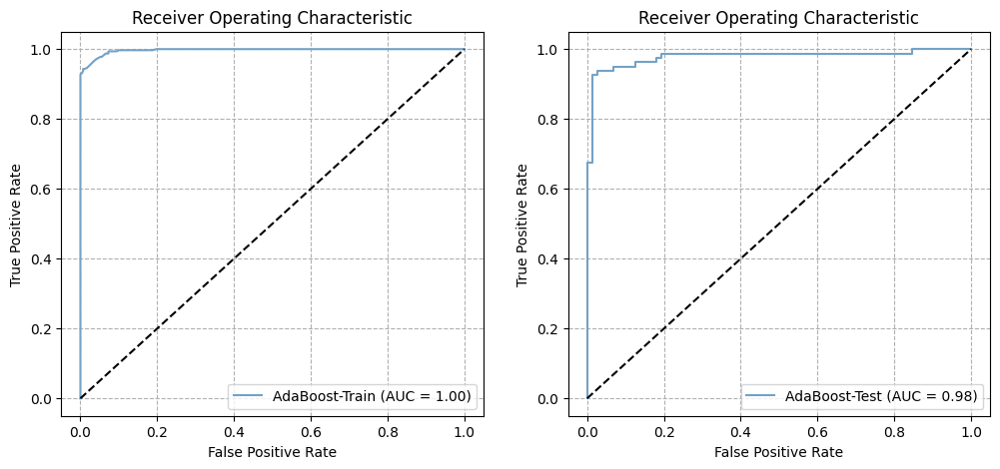

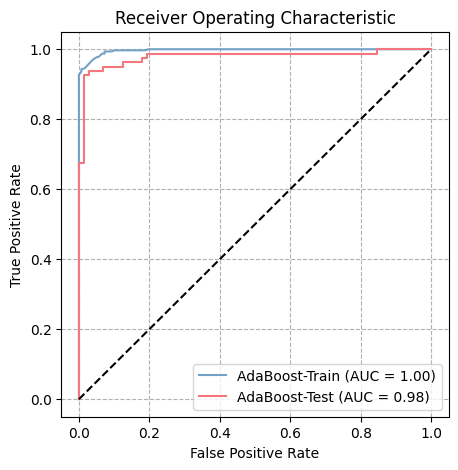

In [29]:
# 绘制ROC曲线，前面已经导入相关包
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc


# 设置图形大小
plt.figure(figsize=(12, 5))

# 创建第一个子图，用于绘制训练集的ROC曲线
plt.subplot(1, 2, 1)
# 通过模型的predict_proba方法获取训练集上的预测概率，绘制训练集ROC图
y_pro_train = estimator.predict_proba(train_X)[:, 1]
#计算训练集的真阳性率（TPR）和假阳性率（FPR）
fpr_train, tpr_train, thresholds = roc_curve(train_Y, y_pro_train)
# 计算AUC值
roc_auc_train = auc(fpr_train, tpr_train) # 也可以使用roc_auc_score(y_test, y_pro)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic') # 设置标题
plt.plot(fpr_train, tpr_train, label='AdaBoost-Train (AUC = %0.2f)' % roc_auc_train) # 训练集ROC曲线
plt.plot([0, 1], [0, 1], '--',  color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 创建第二个子图，用于绘制测试集的ROC曲线
plt.subplot(1, 2, 2)
# 通过模型的predict_proba方法获取测试集上的预测概率
y_pro_test = estimator.predict_proba(test_X)[:, 1]
# 计算测试集的真阳性率（TPR）和假阳性率（FPR）
fpr_test, tpr_test, thresholds = roc_curve(test_Y, y_pro_test)
# 计算AUC值
roc_auc_test = auc(fpr_test, tpr_test)  #也可以使用roc_auc_score(y_test, y_pro)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')
plt.plot(fpr_test, tpr_test, label='AdaBoost-Test (AUC = %0.2f)' % roc_auc_test) # 测试集ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 保存训练集和测试集的ROC曲线图
plt.savefig("ROC_Ada.svg", dpi = 600)  # 保存图形为 SVG 格式文件
plt.show() # 显示图形


# 绘制训练集和测试集的ROC组合图
plt.figure(figsize=(5, 5))
# 绘制 ROC 曲线
plt.plot(fpr_train, tpr_train, label='AdaBoost-Train (AUC = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, label='AdaBoost-Test (AUC = %0.2f)' % roc_auc_test)
# 绘制对角线
plt.plot([0, 1], [0, 1], '--', color='black')  #颜色
# 添加背景网格
plt.grid(True, linestyle='--')
# 设置标题和标签
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的ROC组合图
plt.savefig("ROC_Ada_组合.svg", dpi=600)
plt.show()

#### PR_AUC曲线部分

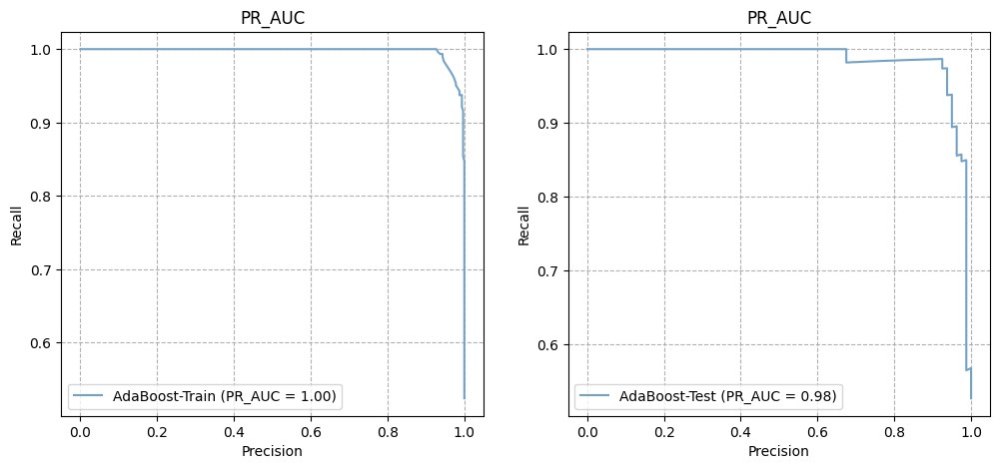

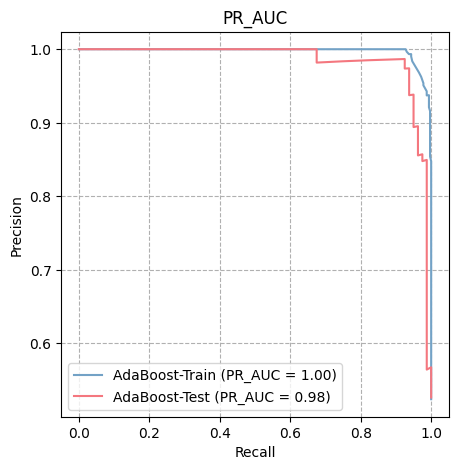

In [30]:
# 绘制PR（Precision-Recall）曲线
import matplotlib.pyplot as plt # 确保导入了matplotlib.pyplot
import sklearn as sk
from sklearn import metrics
from sklearn.metrics import precision_recall_curve, average_precision_score, auc
import warnings
warnings.filterwarnings("ignore")

# 设置绘图的大小
fig = plt.figure(figsize=(12, 5))

# 训练集PR_AUC曲线
plt.subplot(1, 2, 1)
# 通过模型预测训练集上的概率
y_pro_train = estimator.predict_proba(train_X)[:, 1]
# 计算精确度和召回率
precision_train, recall_train, thresholds = precision_recall_curve(train_Y, y_pro_train, pos_label=1)
average_precision_train = average_precision_score(train_Y, y_pro_train)
pr_auc_train = metrics.auc(recall_train, precision_train)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_train, precision_train, label='AdaBoost-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 测试集PR_AUC曲线
plt.subplot(1, 2, 2)
# 通过模型预测测试集上的概率
y_pro_test = estimator.predict_proba(test_X)[:, 1]
# 计算精确度和召回率
precision_test, recall_test, thresholds = precision_recall_curve(test_Y, y_pro_test, pos_label=1)
average_precision_test = average_precision_score(test_Y, y_pro_test)
pr_auc_test = metrics.auc(recall_test, precision_test)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_test, precision_test, label='AdaBoost-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left')  # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 保存训练集和测试集的PR_AUCC曲线图
plt.savefig("PR_Ada.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的PR_AUC组合图
plt.figure(figsize=(5, 5))
# 绘制训练集PR_AUC图
plt.plot(recall_train, precision_train, label='AdaBoost-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# 绘制测试集PR_AUC图
plt.plot(recall_test, precision_test, label='AdaBoost-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
# 设置标题和标签
plt.title('PR_AUC')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc="lower left") # 设置图例位置
plt.grid(True, linestyle='--') # 添加背景网格
# 设置图形边框
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的PR_AUC组合图
plt.savefig("PR_Ada_组合.svg", dpi=600)
plt.show()


#### 模型评估与性能指标的计算

In [31]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import average_precision_score

estimator = Ada
estimator.fit(train_X, train_Y)
clf_test = estimator.predict(test_X)
acc_test = accuracy_score(test_Y,clf_test)
roc_test = roc_auc_score(test_Y,clf_test)
pre_test = precision_score(test_Y,clf_test)
rec_test = recall_score(test_Y,clf_test)
f1_test = f1_score(test_Y,clf_test)
mcc_test = matthews_corrcoef(test_Y,clf_test)
matrix_test = confusion_matrix(test_Y,clf_test)
ap_test = average_precision_score(test_Y,clf_test)

algorithm_model = [Ada]
algorithm_name = ["AdaBoost"]
tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_test
Acc_data.loc[algorithm_name]  = acc_test
Recall_data.loc[algorithm_name] = rec_test
Precision_data.loc[algorithm_name] = pre_test
F1_data.loc[algorithm_name]  = f1_test
MCC_data.loc[algorithm_name]  = mcc_test
Ap_data.loc[algorithm_name]  = ap_test

Auc_data.to_csv("test_ROC.csv")
Acc_data.to_csv("test_ACC.csv")
Recall_data.to_csv("test_REC.csv")
Precision_data.to_csv("test_PRE.csv")
F1_data.to_csv("test_F1.csv")
MCC_data.to_csv("test_MCC.csv")
Ap_data.to_csv("test_AP.csv")

clf_train = estimator.predict(train_X)
acc_train = accuracy_score(train_Y,clf_train)
roc_train = roc_auc_score(train_Y,clf_train)
pre_train = precision_score(train_Y,clf_train)
rec_train = recall_score(train_Y,clf_train)
f1_train = f1_score(train_Y,clf_train)
mcc_train = matthews_corrcoef(train_Y,clf_train)
matrix_train = confusion_matrix(train_Y,clf_train)
ap_train = average_precision_score(train_Y,clf_train)

tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_train
Acc_data.loc[algorithm_name]  = acc_train
Recall_data.loc[algorithm_name] = rec_train
Precision_data.loc[algorithm_name] = pre_train
F1_data.loc[algorithm_name]  = f1_train
MCC_data.loc[algorithm_name]  = mcc_train
Ap_data.loc[algorithm_name]  = ap_train

Auc_data.to_csv("train_ROC.csv")
Acc_data.to_csv("train_ACC.csv")
Recall_data.to_csv("train_REC.csv")
Precision_data.to_csv("train_PRE.csv")
F1_data.to_csv("train_F1.csv")
MCC_data.to_csv("train_MCC.csv")
Ap_data.to_csv("train_AP.csv")

#### 原始脚本没有修改的输出结果

In [32]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test

# 使用找到的最佳参数实例化AdaBoost分类器
Ada = AdaBoostClassifier(random_state = 0,
                         algorithm = 'SAMME',
                         learning_rate = 1.5,
                         n_estimators = 474)

# 训练模型
estimator = Ada
model = estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=Ada, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="accuracy", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

#### score打分值是怎么得来的呢？

In [41]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.8881578947368421
基模型显著性: 显著
打乱模型平均得分: 0.5089473684210526
打乱模型最高得分: 0.6513157894736842
显著的打乱次数/总打乱次数: 1/100 (1.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.48026315789473684, z分数=-0.45291034539604463, p值=0.6506133011313888, 显著性=不显著
打乱模型 2: 得分=0.39473684210526316, z分数=-1.64702938857879, p值=0.09955200533821347, 显著性=不显著
打乱模型 3: 得分=0.4868421052631579, z分数=-0.361055034381987, p值=0.718058306434092, 显著性=不显著
打乱模型 4: 得分=0.4605263157894737, z分数=-0.7284762784382168, p值=0.4663220845782514, 显著性=不显著
打乱模型 5: 得分=0.4868421052631579, z分数=-0.361055034381987, p值=0.718058306434092, 显著性=不显著


#### 修改原始scramble.py所返回的结果

In [9]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.ensemble import AdaBoostClassifier # 导入AdaBoost分类器

# 设置训练集和测试集的特征和标签
X_train = train_X = x_mor_train #这里的train和test表示方式和前面代码略有区别
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test

# 使用找到的最佳参数实例化AdaBoost分类器
Ada = AdaBoostClassifier(random_state = 0,
                         algorithm = 'SAMME',
                         learning_rate = 1.5,
                         n_estimators = 474)

# 训练模型
estimator = Ada
estimator.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=Ada, iterations=100)

# 使用Scrambler验证模型
results = scrambler.validate(
    X, Y, 
    scoring="accuracy", # 注意：根据Scrambler类的具体实现，这里可能需要调整以同时处理多个评分指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [11]:
# 解包返回的结果
accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results

# 输出结果
print(f"准确率得分列表: {accuracy_scores}")
print(f"召回率得分列表: {recall_scores}")
print(f"精确率得分列表: {precision_scores}")
print(f"z分数列表: {zscores}")
print(f"p值列表: {pvalues}")
print(f"显著性列表: {significances}")

# 输出打乱模型得分的平均值
print(f"模型扰乱后平均准确率: {np.mean(accuracy_scores[1:])}")
print(f"模型扰乱后平均召回率: {np.mean(recall_scores[1:])}")
print(f"模型扰乱后平均精确率: {np.mean(precision_scores[1:])}")

准确率得分列表: [0.8289473684210527, 0.6052631578947368, 0.4342105263157895, 0.42105263157894735, 0.5394736842105263, 0.4605263157894737, 0.4868421052631579, 0.5263157894736842, 0.46710526315789475, 0.5131578947368421, 0.5723684210526315, 0.45394736842105265, 0.5789473684210527, 0.40789473684210525, 0.48026315789473684, 0.4342105263157895, 0.5789473684210527, 0.4407894736842105, 0.48026315789473684, 0.5723684210526315, 0.5657894736842105, 0.5197368421052632, 0.5921052631578947, 0.5394736842105263, 0.5328947368421053, 0.5328947368421053, 0.5986842105263158, 0.48026315789473684, 0.46710526315789475, 0.4605263157894737, 0.5328947368421053, 0.5131578947368421, 0.5, 0.48026315789473684, 0.618421052631579, 0.4934210526315789, 0.47368421052631576, 0.4934210526315789, 0.5263157894736842, 0.4605263157894737, 0.4144736842105263, 0.506578947368421, 0.48026315789473684, 0.4605263157894737, 0.5789473684210527, 0.5328947368421053, 0.4276315789473684, 0.5328947368421053, 0.4605263157894737, 0.5, 0.486842105

#### 探究原始模型的评价指标

In [13]:
# 使用Scrambler验证模型并获取返回结果
results = scrambler.validate(
    X, Y, 
    scoring="accuracy",  # 这里的scoring参数可能需要根据Scrambler类的实现进行调整
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

# 解包返回的结果
accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results

# 输出原始模型的得分
print("原始模型的指标：")
print(f"准确率(Accuracy): {accuracy_scores[0]}")
print(f"召回率(Recall): {recall_scores[0]}")
print(f"精确率(Precision): {precision_scores[0]}")
print(f"z分数(Z-Score): {zscores[0]}")
print(f"p值(P-Value): {pvalues[0]}")
print(f"显著性(Significance): {'显著' if significances[0] else '不显著'}")

# 注意：这里假设第一个元素（索引0）代表原始模型的相关指标

原始模型的指标：
准确率(Accuracy): 0.8486842105263158
召回率(Recall): 0.8169014084507042
精确率(Precision): 0.8529411764705882
z分数(Z-Score): 5.264366806201809
p值(P-Value): 1.4067334083338356e-07
显著性(Significance): 显著


#### 探究扰动模型的评价指标

In [14]:
import numpy as np  # 确保已经导入numpy库

# 假设results已经从scrambler.validate方法获取
accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results

# 随机选取10次扰动，不包括第一次（原始模型），因此索引从1开始
random_indices = np.random.choice(range(1, len(accuracy_scores)), size=10, replace=False)

print("随机选取的10次扰动模型的指标：")
for idx in random_indices:
    print(f"扰动 {idx} - 准确率(Accuracy): {accuracy_scores[idx]}, 召回率(Recall): {recall_scores[idx]}, 精确率(Precision): {precision_scores[idx]}, z分数(Z-Score): {zscores[idx]}, p值(P-Value): {pvalues[idx]}, 显著性(Significance): {'显著' if significances[idx] else '不显著'}")

随机选取的10次扰动模型的指标：
扰动 49 - 准确率(Accuracy): 0.5328947368421053, 召回率(Recall): 0.647887323943662, 精确率(Precision): 0.5, z分数(Z-Score): 0.3919631642647399, p值(P-Value): 0.6950854310887965, 显著性(Significance): 不显著
扰动 99 - 准确率(Accuracy): 0.5131578947368421, 召回率(Recall): 0.6197183098591549, 精确率(Precision): 0.4835164835164835, z分数(Z-Score): 0.087437936643673, p值(P-Value): 0.9303234157562377, 显著性(Significance): 不显著
扰动 68 - 准确率(Accuracy): 0.4605263157894737, 召回率(Recall): 0.5633802816901409, 精确率(Precision): 0.43956043956043955, z分数(Z-Score): -0.724629337012506, p值(P-Value): 0.4686794561621017, 显著性(Significance): 不显著
扰动 100 - 准确率(Accuracy): 0.40789473684210525, 召回率(Recall): 0.5211267605633803, 精确率(Precision): 0.3978494623655914, z分数(Z-Score): -1.5366966106686841, p值(P-Value): 0.12436762150239923, 显著性(Significance): 不显著
扰动 88 - 准确率(Accuracy): 0.5197368421052632, 召回率(Recall): 0.6056338028169014, 精确率(Precision): 0.48863636363636365, z分数(Z-Score): 0.18894634585069472, p值(P-Value): 0.8501348690034518, 显著性(Si

#### 保存原始模型和扰动模型的评价指标，不能输出roc_auc, mcc, avg_pre

In [53]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.ensemble import AdaBoostClassifier # 导入AdaBoost分类器


# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test

# 使用找到的最佳参数实例化AdaBoost分类器
Ada = AdaBoostClassifier(random_state = 0,
                         algorithm = 'SAMME',
                         learning_rate = 1.5,
                         n_estimators = 474)

# 训练模型
Ada.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=Ada, iterations=100)

# 使用Scrambler验证模型并获取返回结果
results = scrambler.validate(
    X, Y, 
    scoring="accuracy",  # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

# 解包返回的结果
# accuracy_scores, recall_scores, precision_scores, roc_auc_scores, mcc_scores, avg_precision_scores, zscores, pvalues, significances = results
accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results

In [54]:
import pandas as pd
import numpy as np

# 随机选取10次扰动的索引
random_indices = np.random.choice(range(1, len(accuracy_scores)), size=10, replace=False)

# 创建一个DataFrame来存储选取的扰动模型指标
scrambled_metrics_df = pd.DataFrame({
    'Index': random_indices,
    'Accuracy': [accuracy_scores[i] for i in random_indices],
    'Recall': [recall_scores[i] for i in random_indices],
    'Precision': [precision_scores[i] for i in random_indices],
    #'roc_auc': [roc_auc_scores[i] for i in random_indices],
    #'mcc': [mcc_scores[i] for i in random_indices],
    #'avg_precision': [avg_precision_scores[i] for i in random_indices],
    'Z-Score': [zscores[i] for i in random_indices],
    'P-Value': [pvalues[i] for i in random_indices],
    'Significance': ['显著' if significances[i] else '不显著' for i in random_indices]
})

# 将DataFrame保存到CSV文件
scrambled_metrics_df.to_csv("scrambled_metrics.csv", index=False)

In [56]:
# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', #'roc_auc', 'mcc', 'avg_precision', 
               'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        accuracy_scores[0],
        recall_scores[0],
        precision_scores[0],
        #roc_auc_scores[0],
        #mcc_scores[0],
        #avg_precision_scores[0],
        zscores[0],
        pvalues[0],
        '显著' if significances[0] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

#### 输出并保存原始模型和扰动模型的评价指标

In [17]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.ensemble import AdaBoostClassifier # 导入AdaBoost分类器


# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test

# 使用找到的最佳参数实例化AdaBoost分类器
Ada = AdaBoostClassifier(random_state = 0,
                         algorithm = 'SAMME',
                         learning_rate = 1.5,
                         n_estimators = 474)

# 训练模型
Ada.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 使用Scrambler验证模型并获取返回结果
results = scrambler.validate(
    X, Y, 
    scoring="accuracy", # 'roc_auccy', 'recall', precision'
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

# 解包返回的结果
scores, recall_scores, precision_scores, zscores, pvalues, significances = results

In [18]:
import pandas as pd
import numpy as np

# 随机选取10次扰动的索引
random_indices = np.random.choice(range(1, len(accuracy_scores)), size=10, replace=False)

# 创建一个DataFrame来存储选取的扰动模型指标
scrambled_metrics_df = pd.DataFrame({
    'Index': random_indices,
    'Accuracy': [scores[i] for i in random_indices], # scoring="accuracy"
    'Recall': [recall_scores[i] for i in random_indices],
    'Precision': [precision_scores[i] for i in random_indices],
    'Z-Score': [zscores[i] for i in random_indices],
    'P-Value': [pvalues[i] for i in random_indices],
    'Significance': ['显著' if significances[i] else '不显著' for i in random_indices]
})

# 将DataFrame保存到CSV文件
scrambled_metrics_df.to_csv("scrambled_metrics.csv", index=False)

In [19]:
# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        scores[0], # scoring="accuracy"
        recall_scores[0],
        precision_scores[0],
        zscores[0],
        pvalues[0],
        '显著' if significances[0] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

### 决策树分类器（DecisionTreeClassifier）参数搜索

In [11]:
# 导入决策树分类器
from sklearn.tree import DecisionTreeClassifier
import numpy as np
from sklearn.model_selection import GridSearchCV

# 设置决策树参数max_depth的搜索范围
max_depth_range=[int(x) for x in np.linspace(5, 20, num=5)]
# 设置决策树参数min_samples_split的搜索范围
min_samples_split_range=[int(x) for x in np.linspace(5, 25, num=5)]
# 设置决策树参数min_samples_leaf的搜索范围
min_samples_leaf_range=[3, 4, 5, 6, 7]

# 定义一个函数用于训练决策树模型并使用网格搜索找到最优参数
def DecisionTreeClassifier_model(X,Y): 
    # 实例化决策树分类器，设置随机种子以确保结果可复现
    DecisionTreeClassifier_auto = DecisionTreeClassifier(random_state=0)
    # 定义参数字典，包含需要进行搜索的参数
    param_dict = {
        'max_depth':max_depth_range,
        'min_samples_split':min_samples_split_range,
        'min_samples_leaf':min_samples_leaf_range,
    }
    # 实例化GridSearchCV，传入决策树实例、参数字典、交叉验证策略、n_jobs参数设置为-1以使用所有可用的CPU核心，使用ROC AUC作为评分标准
    estimator = GridSearchCV(estimator=DecisionTreeClassifier_auto, param_grid=param_dict, cv=cv, n_jobs=-1, scoring="roc_auc")
    # 在给定的数据上训练模型
    estimator.fit(X,Y)
    # 返回最优参数、最优分数以及最优模型
    return estimator.best_params_, estimator.best_score_, estimator.best_estimator_

# 调用上述定义的函数，传入特征集X和标签集Y
tmp_1, tmp_2, DecisionTreeClassifier_auto = DecisionTreeClassifier_model(X,Y)

# 打印出最优参数、最优分数和最优模型
print(tmp_1,tmp_2,DecisionTreeClassifier_auto)

{'max_depth': 16, 'min_samples_leaf': 7, 'min_samples_split': 5} 0.9092062051680927 DecisionTreeClassifier(max_depth=16, min_samples_leaf=7, min_samples_split=5,
                       random_state=0)


#### 模型训练与性能评估

In [12]:
# 导入决策树分类器
from sklearn.tree import DecisionTreeClassifier
# 导入性能评估指标
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc, roc_auc_score, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings

# 忽略警告信息
warnings.filterwarnings("ignore")

# 定义决策树模型，并设置参数
DT = DecisionTreeClassifier(random_state=0,
                            class_weight='balanced',
                            criterion='gini',
                            max_features='sqrt',
                            splitter='best',
                            max_depth=16,
                            min_samples_leaf=7,
                            min_samples_split=5)

# 训练模型
train_X = x_mor_train
train_Y = y_mor_train
test_X = x_mor_test
test_Y = y_mor_test
estimator = DT
estimator.fit(train_X, train_Y)

# 在训练集和测试集上进行预测
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)

# 打印训练集和测试集的准确率
print(f"训练集准确度是{accuracy_score(train_Y, clf_train)}")
print(f"测试集准确度是{accuracy_score(test_Y, clf_test)}")

训练集准确度是0.8578512396694215
测试集准确度是0.9276315789473685


#### 混淆矩阵可视化

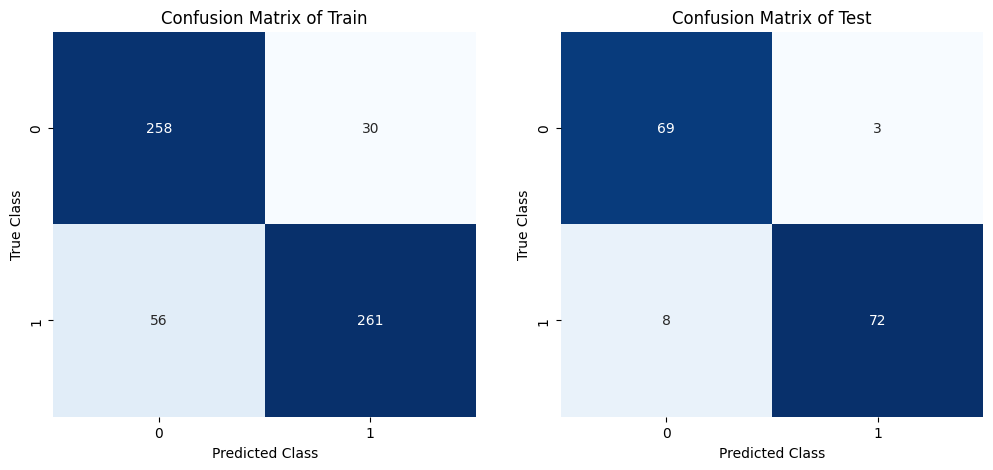

In [13]:
# 计算训练集和测试集的混淆矩阵
train_matrix = confusion_matrix(train_Y, clf_train)
test_matrix = confusion_matrix(test_Y, clf_test)

# 设置可视化的颜色
pall = sns.color_palette(['#73a2c6', '#f4777f'])
sns.set_palette(pall)

# 绘制训练集的混淆矩阵
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.heatmap(train_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Train")

# 绘制测试集的混淆矩阵
plt.subplot(1, 2, 2)
sns.heatmap(test_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")
plt.savefig("混淆矩阵_DT.svg", dpi=600)
plt.show()

#### ROC曲线绘制

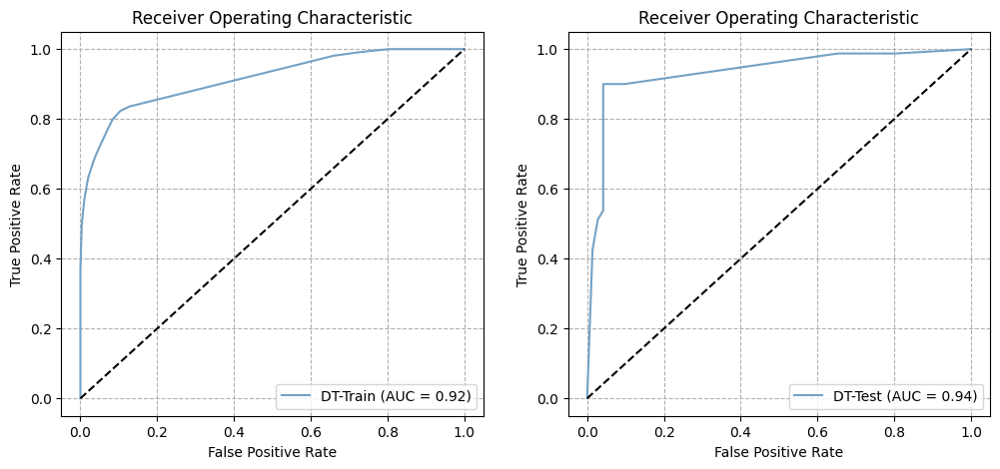

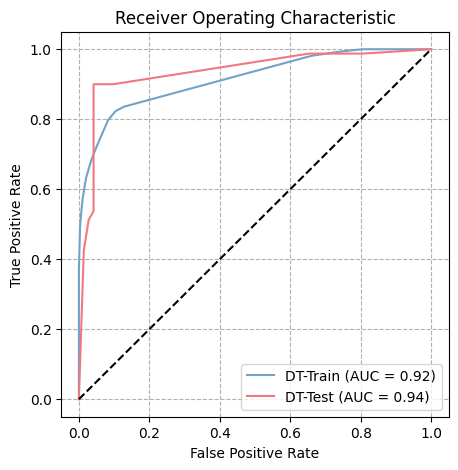

In [14]:
# 绘制训练集和测试集的ROC曲线
# 设置图形大小
plt.figure(figsize=(12, 5))

# 创建第一个子图，用于绘制训练集的ROC曲线
plt.subplot(1, 2, 1)
# 通过模型的predict_proba方法获取训练集上的预测概率，绘制训练集ROC图
y_pro_train = estimator.predict_proba(train_X)[:, 1]
#计算训练集的真阳性率（TPR）和假阳性率（FPR）
fpr_train, tpr_train, thresholds = roc_curve(train_Y, y_pro_train)
# 计算AUC值
roc_auc_train = auc(fpr_train, tpr_train)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic') # 设置标题
plt.plot(fpr_train, tpr_train, label='DT-Train (AUC = %0.2f)' % roc_auc_train) # 绘制ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 创建第二个子图，用于绘制测试集的ROC曲线
plt.subplot(1, 2, 2)
# 通过模型的predict_proba方法获取测试集上的预测概率
y_pro_test = estimator.predict_proba(test_X)[:, 1]
# 计算测试集的真阳性率（TPR）和假阳性率（FPR）
fpr_test, tpr_test, thresholds = roc_curve(test_Y, y_pro_test)
# 计算AUC值
roc_auc_test = auc(fpr_test, tpr_test)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')
plt.plot(fpr_test, tpr_test, label='DT-Test (AUC = %0.2f)' % roc_auc_test)
plt.plot([0, 1], [0, 1], '--', color='black')
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 保存训练集和测试集的ROC曲线图
plt.savefig("ROC_DT.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的ROC组合图
plt.figure(figsize=(5, 5))
# 绘制 ROC 曲线
plt.plot(fpr_train, tpr_train, label='DT-Train (AUC = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, label='DT-Test (AUC = %0.2f)' % roc_auc_test)
# 绘制对角线
plt.plot([0, 1], [0, 1], '--', color='black')  #颜色
# 添加背景网格
plt.grid(True, linestyle='--')
# 设置标题和标签
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的ROC组合图
plt.savefig("ROC_DT_组合.svg", dpi=600)
plt.show()

#### PR_AUC曲线的绘制

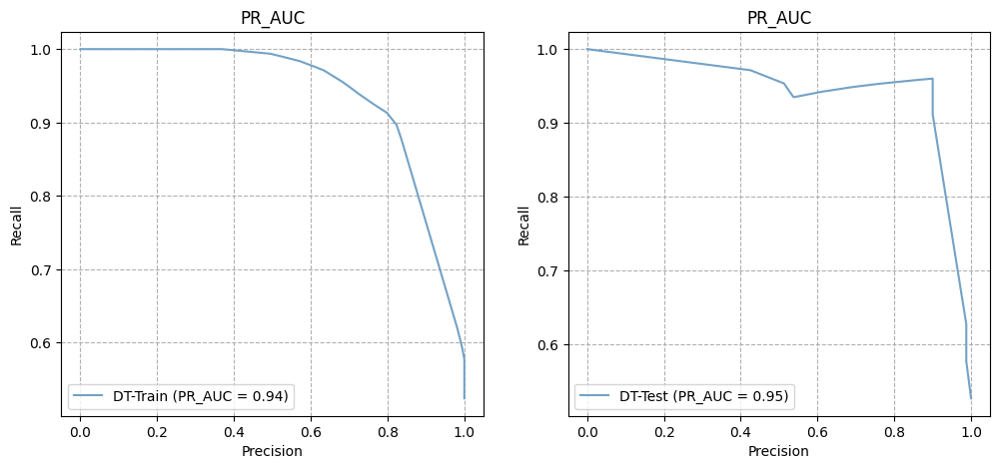

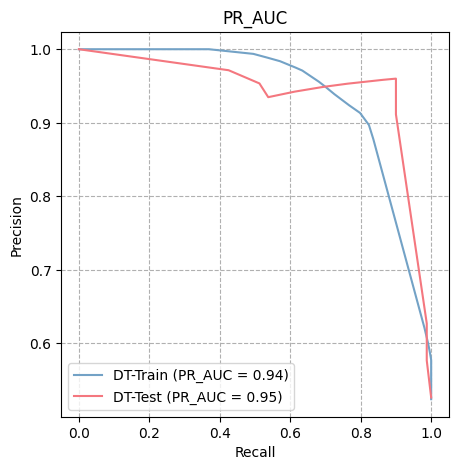

In [16]:
# 绘制PR（Precision-Recall）曲线
import matplotlib.pyplot as plt # 确保导入了matplotlib.pyplot
import sklearn as sk
from sklearn import metrics
from sklearn.metrics import precision_recall_curve, average_precision_score, auc
import warnings
warnings.filterwarnings("ignore")


# 绘制PR_AUC曲线来评估模型在处理不平衡数据上的性能
# 设置绘图的大小
plt.figure(figsize=(12, 5))

# 训练集PR_AUC曲线
plt.subplot(1, 2, 1)
# 计算精确度和召回率
precision_train, recall_train, thresholds = precision_recall_curve(train_Y, y_pro_train, pos_label=1)
average_precision_train = average_precision_score(train_Y, y_pro_train)
pr_auc_train = metrics.auc(recall_train, precision_train)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_train, precision_train, label='DT-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 测试集PR_AUC曲线
plt.subplot(1, 2, 2)
# 计算精确度和召回率
precision_test, recall_test, thresholds = precision_recall_curve(test_Y, y_pro_test, pos_label=1)
average_precision_test = average_precision_score(test_Y, y_pro_test)
pr_auc_test = metrics.auc(recall_test, precision_test)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_test, precision_test, label='DT-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 保存训练集和测试集的PR_AUCC曲线图
plt.savefig("PR_DT.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的PR_AUC组合图
plt.figure(figsize=(5, 5))
# 绘制训练集PR_AUC图
plt.plot(recall_train, precision_train, label='DT-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# 绘制测试集PR_AUC图
plt.plot(recall_test, precision_test, label='DT-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
# 设置标题和标签
plt.title('PR_AUC')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc="lower left") # 设置图例位置
plt.grid(True, linestyle='--') # 添加背景网格
# 设置图形边框
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的PR_AUC组合图
plt.savefig("PR_DT_组合.svg", dpi=600)
plt.show()

#### 模型评估与性能指标的计算

In [17]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import average_precision_score

estimator = DT
estimator.fit(train_X, train_Y)
clf_test = estimator.predict(test_X)
acc_test = accuracy_score(test_Y,clf_test)
roc_test = roc_auc_score(test_Y,clf_test)
pre_test = precision_score(test_Y,clf_test)
rec_test = recall_score(test_Y,clf_test)
f1_test = f1_score(test_Y,clf_test)
mcc_test = matthews_corrcoef(test_Y,clf_test)
matrix_test = confusion_matrix(test_Y,clf_test)
ap_test = average_precision_score(test_Y,clf_test)

algorithm_model = [DT]
algorithm_name = ["DecisionTree"]
tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_test
Acc_data.loc[algorithm_name]  = acc_test
Recall_data.loc[algorithm_name] = rec_test
Precision_data.loc[algorithm_name] = pre_test
F1_data.loc[algorithm_name]  = f1_test
MCC_data.loc[algorithm_name]  = mcc_test
Ap_data.loc[algorithm_name]  = ap_test

Auc_data.to_csv("test_ROC.csv")
Acc_data.to_csv("test_ACC.csv")
Recall_data.to_csv("test_REC.csv")
Precision_data.to_csv("test_PRE.csv")
F1_data.to_csv("test_F1.csv")
MCC_data.to_csv("test_MCC.csv")
Ap_data.to_csv("test_AP.csv")

clf_train = estimator.predict(train_X)
acc_train = accuracy_score(train_Y,clf_train)
roc_train = roc_auc_score(train_Y,clf_train)
pre_train = precision_score(train_Y,clf_train)
rec_train = recall_score(train_Y,clf_train)
f1_train = f1_score(train_Y,clf_train)
mcc_train = matthews_corrcoef(train_Y,clf_train)
matrix_train = confusion_matrix(train_Y,clf_train)
ap_train = average_precision_score(train_Y,clf_train)

tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_train
Acc_data.loc[algorithm_name]  = acc_train
Recall_data.loc[algorithm_name] = rec_train
Precision_data.loc[algorithm_name] = pre_train
F1_data.loc[algorithm_name]  = f1_train
MCC_data.loc[algorithm_name]  = mcc_train
Ap_data.loc[algorithm_name]  = ap_train

Auc_data.to_csv("train_ROC.csv")
Acc_data.to_csv("train_ACC.csv")
Recall_data.to_csv("train_REC.csv")
Precision_data.to_csv("train_PRE.csv")
F1_data.to_csv("train_F1.csv")
MCC_data.to_csv("train_MCC.csv")
Ap_data.to_csv("train_AP.csv")

#### 微调源码scramble.py

In [25]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用

# 训练模型
X_train = train_X = x_mor_train
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test
estimator = DT
estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="accuracy", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [26]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.7763157894736842
基模型显著性: 显著
打乱模型平均得分: 0.49282894736842103
打乱模型最高得分: 0.6447368421052632
显著的打乱次数/总打乱次数: 0/100 (0.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.5197368421052632, z分数=0.35019481007933817, p值=0.7261925014303225, 显著性=不显著
打乱模型 2: 得分=0.47368421052631576, z分数=-0.31896121891009993, p值=0.7497559207920159, 显著性=不显著
打乱模型 3: 得分=0.5723684210526315, z分数=1.1149445574958374, p值=0.26487418101534954, 显著性=不显著
打乱模型 4: 得分=0.4407894736842105, z分数=-0.7969298110454124, p值=0.42549179628777756, 显著性=不显著
打乱模型 5: 得分=0.4473684210526316, z分数=-0.7013360926183496, p值=0.4830932944144183, 显著性=不显著


#### 修改scramble.py源码

In [15]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.tree import DecisionTreeClassifier

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test


# 定义决策树模型，并设置参数
DT = DecisionTreeClassifier(random_state=0,
                            class_weight='balanced',
                            criterion='gini',
                            max_features='sqrt',
                            splitter='best',
                            max_depth=16,
                            min_samples_leaf=7,
                            min_samples_split=5)

# 训练模型
# DT.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)


# 使用Scrambler的validate验证模型，假设以DataFrame形式返回了结果
results = scrambler.validate(
    X=X_train, 
    Y=Y_train_np, 
    scoring="accuracy", # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01,
    as_df=True  # 假设我们想直接以DataFrame形式获取结果
)

# 检查是否返回了DataFrame
if isinstance(results, pd.DataFrame):
    # 将DataFrame保存到CSV文件
    results.to_csv("validation_results.csv", index=False)
    print("Results saved to CSV file.")
    print(results)
else:
    # 如果返回的不是DataFrame，则进行解包
    accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results
    print("Accuracy Scores:", accuracy_scores)
    print("Recall Scores:", recall_scores)
    print("Precision Scores:", precision_scores)
    print("Z-Scores:", zscores)
    print("P-Values:", pvalues)
    print("Significances:", significances)


Results saved to CSV file.


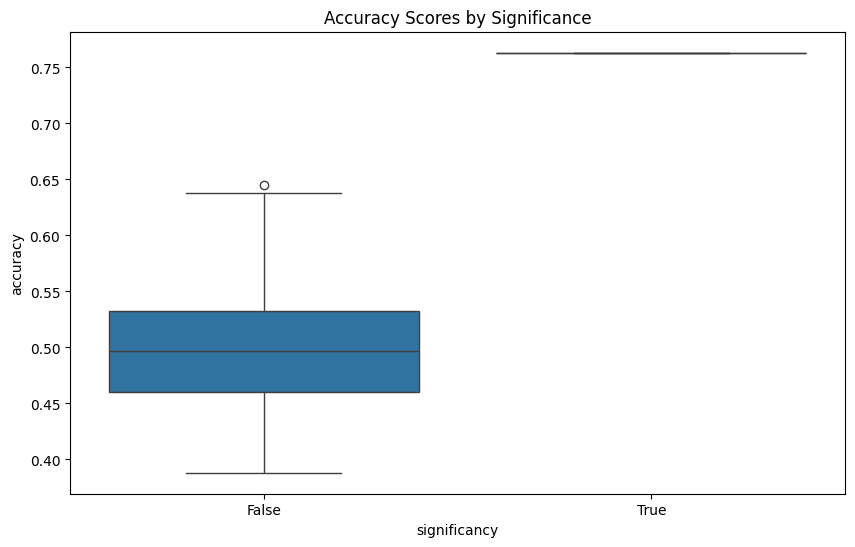

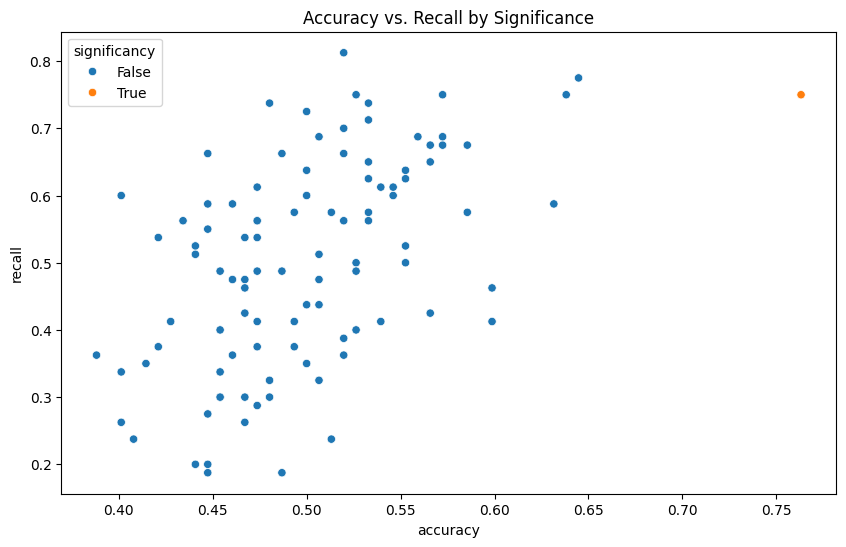

In [12]:
# 模型扰动结果可视化
import matplotlib.pyplot as plt
import seaborn as sns

# 筛选显著性结果
significant_results = results[results['significancy']]

# 绘制准确率的箱形图
plt.figure(figsize=(10, 6))
sns.boxplot(data=results, x='significancy', y='accuracy')
plt.title('Accuracy Scores by Significance')
plt.show()

# 绘制准确率和召回率的散点图
plt.figure(figsize=(10, 6))
sns.scatterplot(data=results, x='accuracy', y='recall', hue='significancy')
plt.title('Accuracy vs. Recall by Significance')
plt.show()

In [13]:
import pandas as pd
import numpy as np

# 随机提取10次模型扰动的结果
# 随机选取10次扰动的索引，排除第0行（原始模型的评分）
random_indices = np.random.choice(results.index[1:], size=10, replace=False)

# 使用iloc直接选择这些索引的行
selected_scrambled_metrics = results.iloc[random_indices]

# 保存选取的扰动模型指标到CSV
selected_scrambled_metrics.to_csv("selected_scrambled_metrics.csv", index=False)

# 假设results是已经通过validate方法获得的DataFrame，并且包含了原始模型的数据在第一行
original_model_data = results.iloc[0]

# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'Average Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        original_model_data['accuracy'],
        original_model_data['recall'],
        original_model_data['precision'],
        original_model_data['roc_auc'],
        original_model_data['mcc'],
        original_model_data['avg_precision'],
        original_model_data['zscore'],
        original_model_data['pvalue'],
        '显著' if original_model_data['significancy'] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

### 梯度提升树(GradientBoostingClassifier, GBT)参数搜索

#### 准备阶段

In [94]:
import warnings
warnings.filterwarnings("ignore")  # 忽略警告信息
from time import time
import numpy as np
import pandas as pd
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

# 记录开始时间
begin_time = time()

# 定义超参数的搜索范围
n_estimators_range = [int(x) for x in np.linspace(start=10, stop=210, num=100)]  # 树的数量
max_depth_range = [int(x) for x in np.linspace(5, 20, num=5)]  # 树的最大深度
min_samples_split_range = [int(x) for x in np.linspace(5, 20, num=5)]  # 分割内部节点所需的最小样本数
min_samples_leaf_range = [3, 4, 5, 6, 7]  # 叶节点所需的最小样本数

#### 模型与超参数设置

In [95]:
# 初始化梯度提升树模型
GtBossT = GradientBoostingClassifier(random_state=0)

# 设置超参数的组合字典
random_forest_hp_range = {
    'n_estimators': n_estimators_range,
    'max_depth': max_depth_range,
    'min_samples_split': min_samples_split_range,
    'min_samples_leaf': min_samples_leaf_range,
    "criterion": ['friedman_mse', 'mse', "mae"],
    "max_features": ["auto", "sqrt", "log2"]
}
print(random_forest_hp_range)  # 打印超参数的范围

{'n_estimators': [10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32, 34, 36, 38, 40, 42, 44, 46, 48, 50, 52, 54, 56, 58, 60, 62, 64, 66, 68, 70, 72, 74, 76, 78, 80, 82, 84, 86, 88, 90, 92, 94, 96, 98, 100, 102, 104, 106, 108, 111, 113, 115, 117, 119, 121, 123, 125, 127, 129, 131, 133, 135, 137, 139, 141, 143, 145, 147, 149, 151, 153, 155, 157, 159, 161, 163, 165, 167, 169, 171, 173, 175, 177, 179, 181, 183, 185, 187, 189, 191, 193, 195, 197, 199, 201, 203, 205, 207, 210], 'max_depth': [5, 8, 12, 16, 20], 'min_samples_split': [5, 8, 12, 16, 20], 'min_samples_leaf': [3, 4, 5, 6, 7], 'criterion': ['friedman_mse', 'mse', 'mae'], 'max_features': ['auto', 'sqrt', 'log2']}


#### 超参数优化过程

In [34]:
# 使用GridSearchCV进行网格搜索，设置n_jobs=-1使用所有CPU核心
estimator_all_roc = GridSearchCV(estimator=GtBossT,
                                 param_grid=random_forest_hp_range,
                                 cv=cv,  # cv变量需在代码前面定义，这里可能是交叉验证的折数，前面已经定义
                                 n_jobs=-1,
                                 scoring="roc_auc", verbose=1)

# 执行网格搜索
estimator_all_roc.fit(X, Y)

Fitting 5 folds for each of 112500 candidates, totalling 562500 fits


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Ple

GridSearchCV(cv=StratifiedKFold(n_splits=5, random_state=0, shuffle=True),
             estimator=GradientBoostingClassifier(random_state=0), n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'mse', 'mae'],
                         'max_depth': [5, 8, 12, 16, 20],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'min_samples_leaf': [3, 4, 5, 6, 7],
                         'min_samples_split': [5, 8, 12, 16, 20],
                         'n_estimators': [10, 12, 14, 16, 18, 20, 22, 24, 26,
                                          28, 30, 32, 34, 36, 38, 40, 42, 44,
                                          46, 48, 50, 52, 54, 56, 58, 60, 62,
                                          64, 66, 68, ...]},
             scoring='roc_auc', verbose=1)

#### 结果分析与保存

In [96]:
# 记录结束时间，并打印运行时长
end_time = time()
print({end_time - begin_time})

# 打印最佳参数组合与对应的ROC AUC分数
print(estimator_all_roc.best_params_)
print(estimator_all_roc.best_score_)

# 保存网格搜索的详细结果
tmp = pd.DataFrame(estimator_all_roc.cv_results_)
df_fig = tmp[["mean_test_score", "params"]]
df_fig.to_csv("tmp2.csv", index=False)

# 对结果DataFrame进行处理，提取每组参数对应的具体数值
df_fig["n_estimators"] = 1
df_fig['max_depth'] = 1
df_fig["min_samples_split"] = 1
df_fig['min_samples_leaf'] = 1
for i in range(df_fig.shape[0]):
    dict_tmp = df_fig["params"].iloc[i]
    df_fig["n_estimators"].iloc[i] = dict_tmp["n_estimators"]
    df_fig["max_depth"].iloc[i] = dict_tmp["max_depth"]
    df_fig["min_samples_split"].iloc[i] = dict_tmp["min_samples_split"]
    df_fig['min_samples_leaf'].iloc[i] = dict_tmp['min_samples_leaf']

# 打印前50行结果作为检查，并保存为CSV文件
df_fig.head(50)
df_fig.to_csv("网格搜索结果GBT.csv", index=False)

# 对网格搜索结果进行描述性统计分析
df_fig.describe()

{134.08607935905457}
{'colsample_bytree': 0.8, 'gamma': 0.0, 'max_depth': 9, 'min_child_weight': 1, 'n_estimators': 40, 'reg_alpha': 0.1, 'reg_lambda': 0.1, 'subsample': 0.8}
0.9451190476190476


KeyError: 'min_samples_split'

#### 准备工作和模型定义

In [64]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

# 忽略潜在的警告信息
warnings.filterwarnings("ignore")

# 定义梯度提升树模型，设置好超参数
GBT = GradientBoostingClassifier(random_state=0,
                                 criterion='friedman_mse',
                                 max_depth=5,
                                 max_features='log2',
                                 min_samples_leaf=4,
                                 min_samples_split=12,
                                 n_estimators=210)

# 训练模型并在训练集和测试集上进行预测
estimator = GBT
estimator.fit(train_X, train_Y)

clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)

# 输出训练集和测试集上的准确率
print(f"训练集准确度是{accuracy_score(train_Y,clf_train)}")
print(f"测试集准确度是{accuracy_score(test_Y,clf_test)}")

训练集准确度是0.9454545454545454
测试集准确度是0.9473684210526315


#### 混淆矩阵的可视化

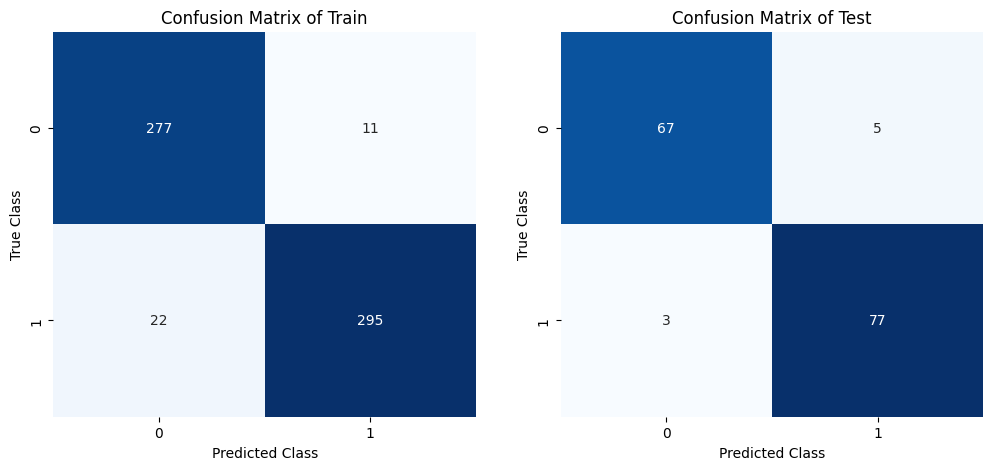

In [65]:
# 计算训练集和测试集的混淆矩阵
train_matrix = confusion_matrix(train_Y, clf_train)
test_matrix = confusion_matrix(test_Y, clf_test)

# 设置绘图的颜色风格
pall = sns.color_palette(['#73a2c6', '#f4777f'])
sns.set_palette(pall)

# 绘制混淆矩阵的热图
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.heatmap(train_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Train")

plt.subplot(1, 2, 2)
sns.heatmap(test_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")
plt.savefig("混淆矩阵_GBT.svg", dpi=300)
plt.show()


#### ROC曲线的绘制

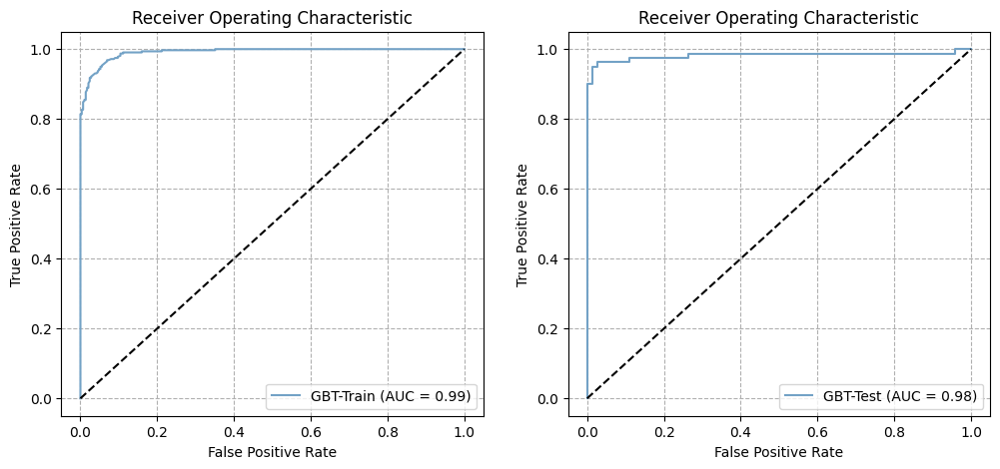

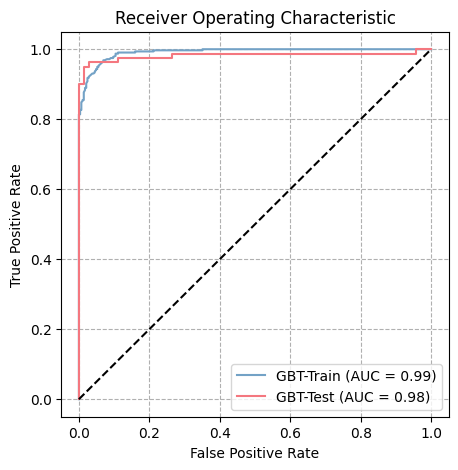

In [66]:
# 绘制训练集和测试集的ROC曲线

# 设置图形大小
plt.figure(figsize=(12, 5))

# 创建第一个子图，用于绘制训练集的ROC曲线
plt.subplot(1, 2, 1)
# 通过模型的predict_proba方法获取训练集上的预测概率，绘制训练集ROC图
y_pro_train = estimator.predict_proba(train_X)[:, 1]
# 计算训练集的真阳性率（TPR）和假阳性率（FPR）
fpr_train, tpr_train, thresholds = roc_curve(train_Y, y_pro_train)
# 计算AUC值
roc_auc_train = auc(fpr_train, tpr_train)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic') # 设置标题
plt.plot(fpr_train, tpr_train, label='GBT-Train (AUC = %0.2f)' % roc_auc_train) # 绘制ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 创建第二个子图，用于绘制测试集的ROC曲线
plt.subplot(1, 2, 2)
# 通过模型的predict_proba方法获取测试集上的预测概率
y_pro_test = estimator.predict_proba(test_X)[:, 1]
# 计算测试集的真阳性率（TPR）和假阳性率（FPR）
fpr_test, tpr_test, thresholds = roc_curve(test_Y, y_pro_test)
# 计算AUC值
roc_auc_test = auc(fpr_test, tpr_test)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')
plt.plot(fpr_test, tpr_test, label='GBT-Test (AUC = %0.2f)' % roc_auc_test) # 绘制ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 保存训练集和测试集的ROC曲线图
plt.savefig("ROC_GBT.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的ROC组合图
plt.figure(figsize=(5, 5))
# 绘制 ROC 曲线
plt.plot(fpr_train, tpr_train, label='GBT-Train (AUC = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, label='GBT-Test (AUC = %0.2f)' % roc_auc_test)
# 绘制对角线
plt.plot([0, 1], [0, 1], '--', color='black')  #颜色
# 添加背景网格
plt.grid(True, linestyle='--')
# 设置标题和标签
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的ROC组合图
plt.savefig("ROC_GBT_组合.svg", dpi=600)
plt.show()

#### PR_AUC曲线的绘制

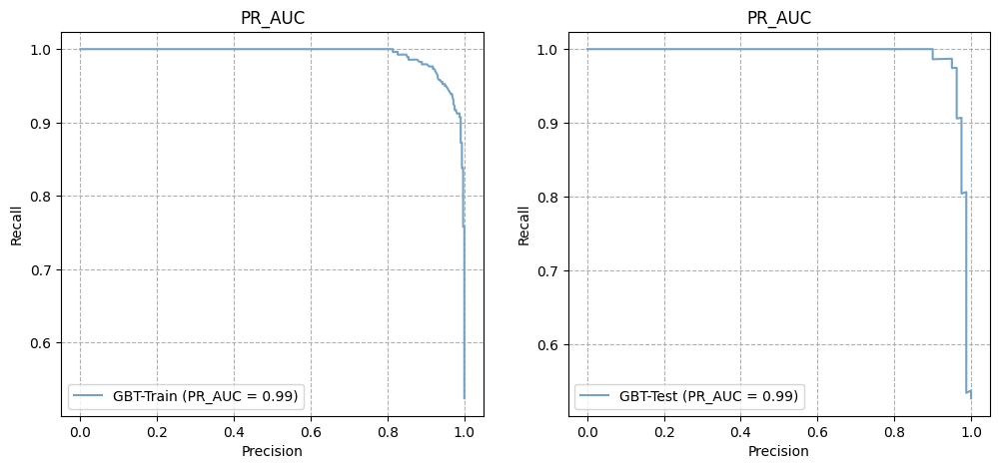

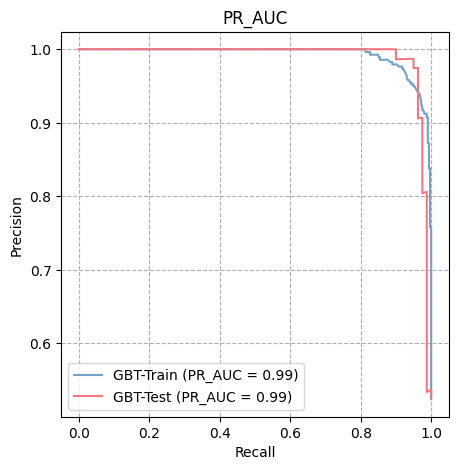

In [67]:
# 绘制PR_AUC曲线来评估模型在处理不平衡数据上的性能
# 设置绘图的大小
plt.figure(figsize=(12, 5))

# 训练集PR_AUC曲线
plt.subplot(1, 2, 1)
# 计算精确度和召回率
precision_train, recall_train, thresholds = precision_recall_curve(train_Y, y_pro_train, pos_label=1)
average_precision_train = average_precision_score(train_Y, y_pro_train)
pr_auc_train = metrics.auc(recall_train, precision_train)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_train, precision_train, label='GBT-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 测试集PR_AUC曲线
plt.subplot(1, 2, 2)
# 计算精确度和召回率
precision_test, recall_test, thresholds = precision_recall_curve(test_Y, y_pro_test, pos_label=1)
average_precision_test = average_precision_score(test_Y, y_pro_test)
pr_auc_test = metrics.auc(recall_test, precision_test)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_test, precision_test, label='GBT-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 保存训练集和测试集的PR_AUCC曲线图
plt.savefig("PR_GBT.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的PR_AUC组合图
plt.figure(figsize=(5, 5))
# 绘制训练集PR_AUC图
plt.plot(recall_train, precision_train, label='GBT-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# 绘制测试集PR_AUC图
plt.plot(recall_test, precision_test, label='GBT-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
# 设置标题和标签
plt.title('PR_AUC')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc="lower left") # 设置图例位置
plt.grid(True, linestyle='--') # 添加背景网格
# 设置图形边框
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的PR_AUC组合图
plt.savefig("PR_GBT_组合.svg", dpi=600)
plt.show()

#### 模型评估与性能指标的计算

In [68]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import average_precision_score

estimator = GBT
estimator.fit(train_X, train_Y)
clf_test = estimator.predict(test_X)
acc_test = accuracy_score(test_Y,clf_test)
roc_test = roc_auc_score(test_Y,clf_test)
pre_test = precision_score(test_Y,clf_test)
rec_test = recall_score(test_Y,clf_test)
f1_test = f1_score(test_Y,clf_test)
mcc_test = matthews_corrcoef(test_Y,clf_test)
matrix_test = confusion_matrix(test_Y,clf_test)
ap_test = average_precision_score(test_Y,clf_test)

algorithm_model = [GBT]
algorithm_name = ["GBT"]
tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_test
Acc_data.loc[algorithm_name]  = acc_test
Recall_data.loc[algorithm_name] = rec_test
Precision_data.loc[algorithm_name] = pre_test
F1_data.loc[algorithm_name]  = f1_test
MCC_data.loc[algorithm_name]  = mcc_test
Ap_data.loc[algorithm_name]  = ap_test

Auc_data.to_csv("test_ROC.csv")
Acc_data.to_csv("test_ACC.csv")
Recall_data.to_csv("test_REC.csv")
Precision_data.to_csv("test_PRE.csv")
F1_data.to_csv("test_F1.csv")
MCC_data.to_csv("test_MCC.csv")
Ap_data.to_csv("test_AP.csv")

clf_train = estimator.predict(train_X)
#rf_test = estimator.predict(test_X)
acc_train = accuracy_score(train_Y,clf_train)
roc_train = roc_auc_score(train_Y,clf_train)
pre_train = precision_score(train_Y,clf_train)
rec_train = recall_score(train_Y,clf_train)
f1_train = f1_score(train_Y,clf_train)
mcc_train = matthews_corrcoef(train_Y,clf_train)
matrix_train = confusion_matrix(train_Y,clf_train)
ap_train = average_precision_score(train_Y,clf_train)

tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_train
Acc_data.loc[algorithm_name]  = acc_train
Recall_data.loc[algorithm_name] = rec_train
Precision_data.loc[algorithm_name] = pre_train
F1_data.loc[algorithm_name]  = f1_train
MCC_data.loc[algorithm_name]  = mcc_train
Ap_data.loc[algorithm_name]  = ap_train

Auc_data.to_csv("train_ROC.csv")
Acc_data.to_csv("train_ACC.csv")
Recall_data.to_csv("train_REC.csv")
Precision_data.to_csv("train_PRE.csv")
F1_data.to_csv("train_F1.csv")
MCC_data.to_csv("train_MCC.csv")
Ap_data.to_csv("train_AP.csv")

In [69]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用


# 设置训练集和测试集的特征和标签
X_train = train_X = x_mor_train
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test

# 定义梯度提升树模型，设置好超参数
GBT = GradientBoostingClassifier(random_state=0,
                                 criterion='friedman_mse',
                                 max_depth=5,
                                 max_features='log2',
                                 min_samples_leaf=4,
                                 min_samples_split=12,
                                 n_estimators=210)

# 训练模型
estimator = GBT
estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="accuracy", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [70]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.8092105263157895
基模型显著性: 显著
打乱模型平均得分: 0.496842105263158
打乱模型最高得分: 0.631578947368421
显著的打乱次数/总打乱次数: 1/100 (1.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.47368421052631576, z分数=-0.3566313030027579, p值=0.7213678400254255, 显著性=不显著
打乱模型 2: 得分=0.5460526315789473, z分数=0.6265383685507483, p值=0.5309618786991668, 显著性=不显著
打乱模型 3: 得分=0.618421052631579, z分数=1.6097080401042554, p值=0.10746160890593262, 显著性=不显著
打乱模型 4: 得分=0.4868421052631579, z分数=-0.17787318090211987, p值=0.8588225734904802, 显著性=不显著
打乱模型 5: 得分=0.618421052631579, z分数=1.6097080401042554, p值=0.10746160890593262, 显著性=不显著


#### 模型扰动-6个指标

Results saved to CSV file.
     accuracy    recall  precision   roc_auc       mcc  avg_precision  \
0    0.914474  0.853333   0.969697  0.913680  0.834543       0.899843   
1    0.493421  0.386667   0.483333  0.492035 -0.016295       0.489520   
2    0.467105  0.480000   0.461538  0.467273 -0.065472       0.478117   
3    0.546053  0.600000   0.535714  0.546753  0.094021       0.518797   
4    0.513158  0.453333   0.507463  0.512381  0.024935       0.499787   
..        ...       ...        ...       ...       ...            ...   
96   0.585526  0.613333   0.575000  0.585887  0.171998       0.543456   
97   0.500000  0.506667   0.493506  0.500087  0.000173       0.493464   
98   0.427632  0.533333   0.434783  0.429004 -0.145234       0.462147   
99   0.480263  0.480000   0.473684  0.480260 -0.039477       0.483947   
100  0.460526  0.466667   0.454545  0.460606 -0.078788       0.475279   

       zscore        pvalue  significancy  
0    6.153914  7.559350e-10          True  
1   -0.0

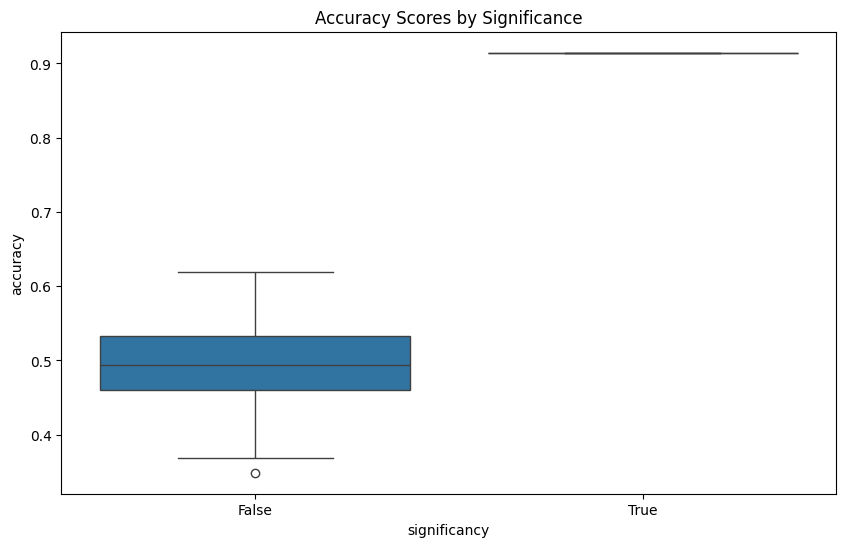

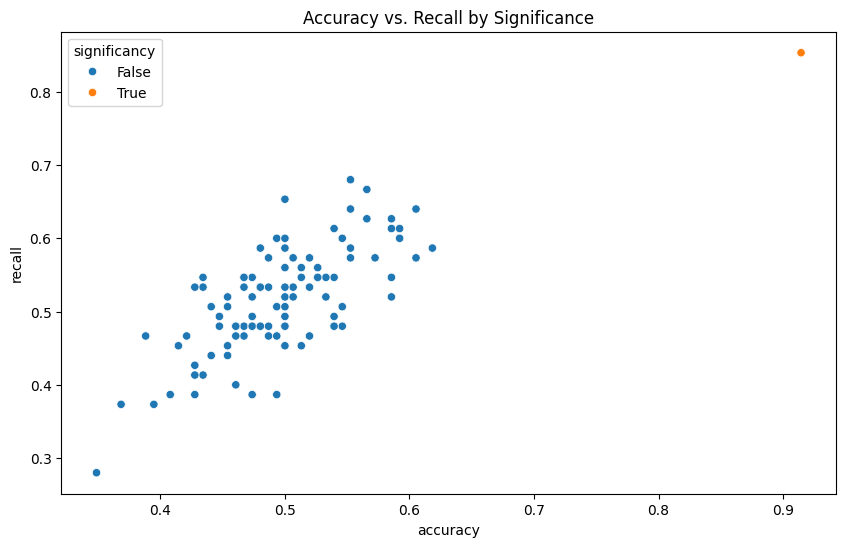

In [33]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.ensemble import GradientBoostingClassifier

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test

# 定义梯度提升树模型，设置好超参数
GBT = GradientBoostingClassifier(random_state=0,
                                 criterion='friedman_mse',
                                 max_depth=5,
                                 max_features='log2',
                                 min_samples_leaf=4,
                                 min_samples_split=12,
                                 n_estimators=210)

# 训练模型
SVM.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=SVM, iterations=100)


# 使用Scrambler的validate验证模型，假设以DataFrame形式返回了结果
results = scrambler.validate(
    X=X_train, 
    Y=Y_train_np, 
    scoring="accuracy", # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01,
    as_df=True  # 假设我们想直接以DataFrame形式获取结果
)

# 检查是否返回了DataFrame
if isinstance(results, pd.DataFrame):
    # 将DataFrame保存到CSV文件
    results.to_csv("validation_results.csv", index=False)
    print("Results saved to CSV file.")
    print(results)
else:
    # 如果返回的不是DataFrame，则进行解包
    accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results
    print("Accuracy Scores:", accuracy_scores)
    print("Recall Scores:", recall_scores)
    print("Precision Scores:", precision_scores)
    print("Z-Scores:", zscores)
    print("P-Values:", pvalues)
    print("Significances:", significances)


import pandas as pd
import numpy as np

# 随机提取10次模型扰动的结果
# 随机选取10次扰动的索引，排除第0行（原始模型的评分）
random_indices = np.random.choice(results.index[1:], size=10, replace=False)

# 使用iloc直接选择这些索引的行
selected_scrambled_metrics = results.iloc[random_indices]

# 保存选取的扰动模型指标到CSV
selected_scrambled_metrics.to_csv("selected_scrambled_metrics.csv", index=False)

# 假设results是已经通过validate方法获得的DataFrame，并且包含了原始模型的数据在第一行
original_model_data = results.iloc[0]

# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'Average Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        original_model_data['accuracy'],
        original_model_data['recall'],
        original_model_data['precision'],
        original_model_data['roc_auc'],
        original_model_data['mcc'],
        original_model_data['avg_precision'],
        original_model_data['zscore'],
        original_model_data['pvalue'],
        '显著' if original_model_data['significancy'] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

# 模型扰动结果可视化
import matplotlib.pyplot as plt
import seaborn as sns

# 筛选显著性结果
significant_results = results[results['significancy']]

# 绘制准确率的箱形图
plt.figure(figsize=(10, 6))
sns.boxplot(data=results, x='significancy', y='accuracy')
plt.title('Accuracy Scores by Significance')
plt.show()

# 绘制准确率和召回率的散点图
plt.figure(figsize=(10, 6))
sns.scatterplot(data=results, x='accuracy', y='recall', hue='significancy')
plt.title('Accuracy vs. Recall by Significance')
plt.show()

### LogisticRegression参数搜索

In [43]:
# 导入LogisticRegressionCV类，作为一个逻辑回归模型，使用交叉验证来选择正则化参数C的最佳值
from sklearn.linear_model import LogisticRegressionCV
from sklearn.model_selection import GridSearchCV

# 定义函数进行模型优化
def LogisticRegressionCV_mdoel(X, Y):
    # 实例化LogisticRegressionCV模型，设置随机状态和并行作业数
    LogisticRegressionCV_auto = LogisticRegressionCV(random_state=0, n_jobs=-1)
    
    # 定义需要搜索的参数字典
    param_dict = {
        "solver": ['newton-cg', 'lbfgs', 'sag', 'saga'],  # 优化算法
        "penalty": ['l1', 'l2', 'elasticnet'], # 正则化：根据solver的不同，可用的penalty也不同
        "class_weight": ['none', 'balanced'],  # 类别权重
        "fit_intercept": [True, False],  # 是否计算截距
        "dual": [True, False],  # 是否使用对偶或原始方法
    }
    
    # 使用GridSearchCV进行参数搜索，cv是交叉验证策略，n_jobs=-1使用所有处理器并行工作
    estimator = GridSearchCV(estimator=LogisticRegressionCV_auto, param_grid=param_dict, cv=cv, n_jobs=-1, scoring="roc_auc")
    estimator.fit(X, Y)  # 训练模型
    
    # 返回最佳参数组合、最佳得分以及训练好的最佳模型
    return estimator.best_params_, estimator.best_score_, estimator.best_estimator_

# 调用函数并打印结果
tmp_1, tmp_2, LogisticRegressionCV_auto = LogisticRegressionCV_mdoel(X, Y)
print(tmp_1, tmp_2, LogisticRegressionCV_auto)

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org

{'class_weight': 'balanced', 'dual': False, 'fit_intercept': True, 'penalty': 'l1', 'solver': 'saga'} 0.9521108806499006 LogisticRegressionCV(class_weight='balanced', n_jobs=-1, penalty='l1',
                     random_state=0, solver='saga')


In [55]:
# 导入必要的库
from sklearn.linear_model import LogisticRegressionCV
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc, precision_recall_curve, PrecisionRecallDisplay, average_precision_score
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

# 准备数据
train_X = x_mor_train
train_Y = y_mor_train
test_X = x_mor_test
test_Y = y_mor_test

# 初始化和训练逻辑回归模型
LR = LogisticRegressionCV(random_state=0, n_jobs=-1,
                          solver='saga',
                          penalty='l1',
                          class_weight='balanced',
                          fit_intercept=True,
                          dual=False)

estimator = LR
estimator.fit(train_X, train_Y)

# 进行预测并评估模型
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)
# 打印训练集和测试集的准确率
print(f"训练集准确度是{accuracy_score(train_Y, clf_train)}")
print(f"测试集准确度是{accuracy_score(test_Y, clf_test)}")

训练集准确度是0.9735537190082645
测试集准确度是0.9407894736842105


#### 可视化混淆矩阵

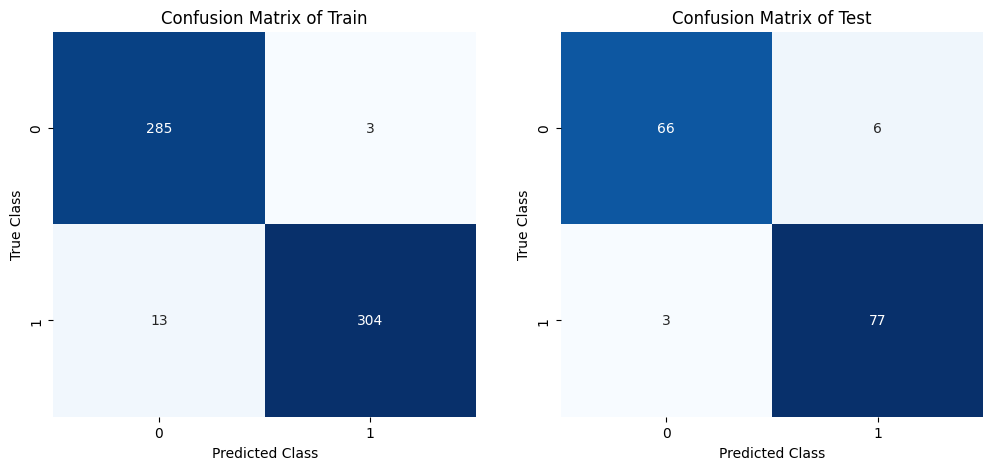

In [56]:
# 计算训练集和测试集的混淆矩阵
train_matrix = confusion_matrix(train_Y, clf_train)
test_matrix = confusion_matrix(test_Y, clf_test)

# 尝试修改一下颜色
pall = sns.color_palette(['#73a2c6', '#f4777f'])
sns.set_palette(pall)

# 绘制热图
plt.figure(figsize=(12, 5))
# 训练集混淆矩阵
plt.subplot(1, 2, 1) #创建了一个包含两个子图的图形，排列方式为一行两列
sns.heatmap(train_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Train")

# 测试集混淆矩阵
plt.subplot(1, 2, 2)
sns.heatmap(test_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")
plt.savefig("混淆矩阵_LR.svg", dpi=600)
plt.show()

#### 可视化ROC曲线

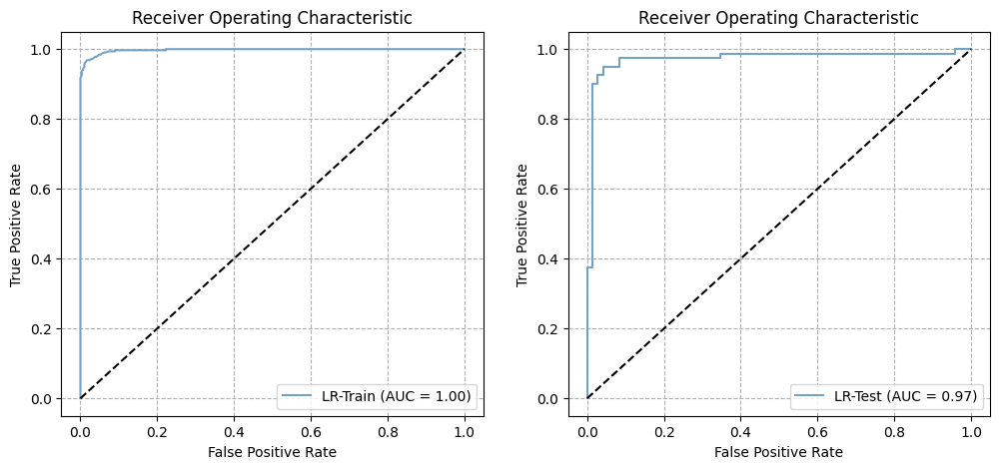

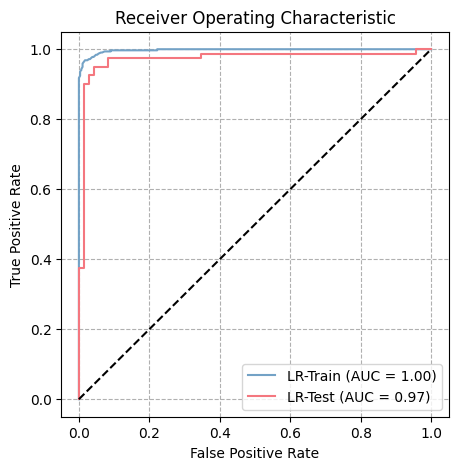

In [57]:
# 绘制训练集和测试集的ROC曲线
# 设置图形大小
plt.figure(figsize=(12, 5))

# 创建第一个子图，用于绘制训练集的ROC曲线
plt.subplot(1, 2, 1)
# 通过模型的predict_proba方法获取训练集上的预测概率，绘制训练集ROC图
y_pro_train = estimator.predict_proba(train_X)[:, 1]
# XXX
y_pre_train = estimator.predict(train_X)
# 计算训练集的真阳性率（TPR）和假阳性率（FPR）
fpr_train, tpr_train, thresholds = roc_curve(train_Y, y_pro_train)
# 计算AUC值
roc_auc_train = auc(fpr_train, tpr_train)  #也等于roc_auc_score(y_test,y_pro)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic') # 设置标题
plt.plot(fpr_train, tpr_train, label='LR-Train (AUC = %0.2f)' % roc_auc_train) # 绘制ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 创建第二个子图，用于绘制测试集的ROC曲线
plt.subplot(1, 2, 2)
# 通过模型的predict_proba方法获取测试集上的预测概率
y_pro_test = estimator.predict_proba(test_X)[:, 1]
# 获取预测
y_pre_test = estimator.predict(test_X)
# 计算测试集的真阳性率（TPR）和假阳性率（FPR）
fpr_test, tpr_test, thresholds = roc_curve(test_Y, y_pro_test)
# 计算AUC值
roc_auc_test = auc(fpr_test, tpr_test)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')
plt.plot(fpr_test, tpr_test, label='LR-Test (AUC = %0.2f)' % roc_auc_test)
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 保存训练集和测试集的ROC曲线图
plt.savefig("ROC_LR.svg", dpi = 600)
plt.show()


# 绘制训练集和测试集的ROC组合图
plt.figure(figsize=(5, 5))
# 绘制 ROC 曲线
plt.plot(fpr_train, tpr_train, label='LR-Train (AUC = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, label='LR-Test (AUC = %0.2f)' % roc_auc_test)
# 绘制对角线
plt.plot([0, 1], [0, 1], '--', color='black')  #颜色
# 添加背景网格
plt.grid(True, linestyle='--')
# 设置标题和标签
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的ROC组合图
plt.savefig("ROC_LR_组合.svg", dpi=600)
plt.show()

#### 可视化PR_AUC曲线

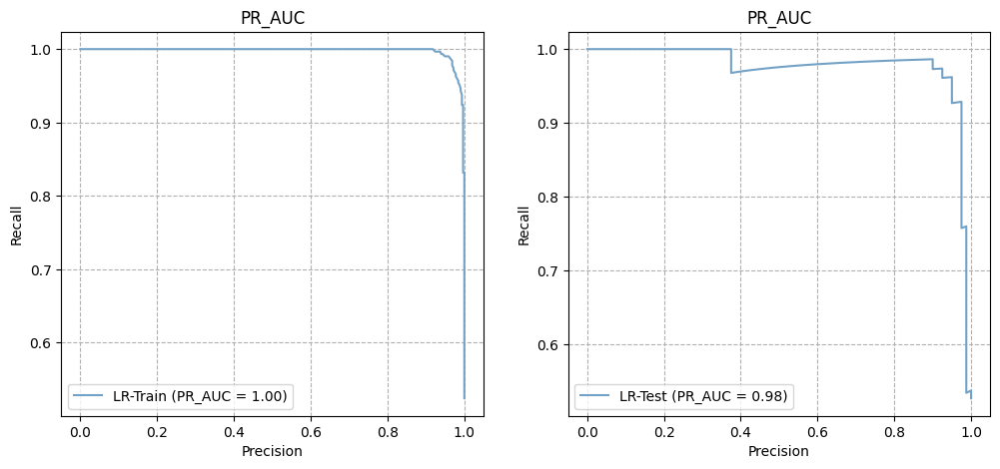

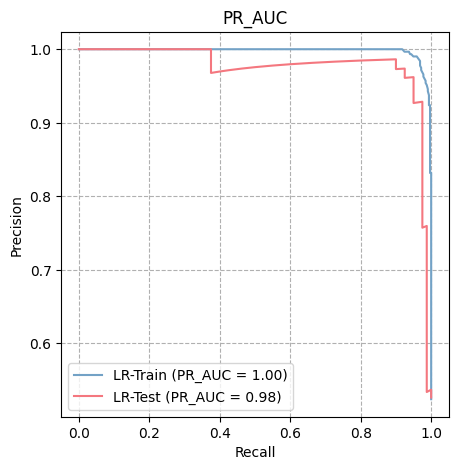

In [59]:
# 绘制PR_AUC曲线来评估模型在处理不平衡数据上的性能
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import PrecisionRecallDisplay
from sklearn.metrics import average_precision_score
import sklearn as sk
from sklearn import metrics
import warnings
warnings.filterwarnings("ignore")

estimator.fit(train_X, train_Y)
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)

# 设置绘图的大小
fig = plt.figure(figsize=(12,5))

# 训练集PR_AUC曲线
plt.subplot(1, 2, 1)
# 计算精确度和召回率
precision_train, recall_train, thresholds = precision_recall_curve(train_Y, y_pro_train, pos_label=1)
average_precision_train = average_precision_score(train_Y, y_pro_train)
pr_auc_train = metrics.auc(recall_train, precision_train)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_train, precision_train, label='LR-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 测试集PR_AUC曲线
plt.subplot(1, 2, 2)
# 计算精确度和召回率
precision_test, recall_test, thresholds = precision_recall_curve(test_Y, y_pro_test, pos_label=1)
average_precision_test = average_precision_score(test_Y, y_pro_test)
pr_auc_test = metrics.auc(recall_test, precision_test)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_test, precision_test, label='LR-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 保存训练集和测试集的PR_AUCC曲线图
plt.savefig("PR_LR.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的PR_AUC组合图
plt.figure(figsize=(5, 5))
# 绘制训练集PR_AUC图
plt.plot(recall_train, precision_train, label='LR-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# 绘制测试集PR_AUC图
plt.plot(recall_test, precision_test, label='LR-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
# 设置标题和标签
plt.title('PR_AUC')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc="lower left") # 设置图例位置
plt.grid(True, linestyle='--') # 添加背景网格
# 设置图形边框
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的PR_AUC组合图
plt.savefig("PR_LR_组合.svg", dpi=600)
plt.show()

#### 模型评估与性能指标计算

In [60]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import average_precision_score

estimator = LR
estimator.fit(train_X, train_Y)
clf_test = estimator.predict(test_X)
acc_test = accuracy_score(test_Y,clf_test)
roc_test = roc_auc_score(test_Y,clf_test)
pre_test = precision_score(test_Y,clf_test)
rec_test = recall_score(test_Y,clf_test)
f1_test = f1_score(test_Y,clf_test)
mcc_test = matthews_corrcoef(test_Y,clf_test)
matrix_test = confusion_matrix(test_Y,clf_test)
ap_test = average_precision_score(test_Y,clf_test)

algorithm_model = [LR]
algorithm_name = ["LR"]
tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_test
Acc_data.loc[algorithm_name]  = acc_test
Recall_data.loc[algorithm_name] = rec_test
Precision_data.loc[algorithm_name] = pre_test
F1_data.loc[algorithm_name]  = f1_test
MCC_data.loc[algorithm_name]  = mcc_test
Ap_data.loc[algorithm_name]  = ap_test

Auc_data.to_csv("test_ROC.csv")
Acc_data.to_csv("test_ACC.csv")
Recall_data.to_csv("test_REC.csv")
Precision_data.to_csv("test_PRE.csv")
F1_data.to_csv("test_F1.csv")
MCC_data.to_csv("test_MCC.csv")
Ap_data.to_csv("test_AP.csv")

clf_train = estimator.predict(train_X)
acc_train = accuracy_score(train_Y,clf_train)
roc_train = roc_auc_score(train_Y,clf_train)
pre_train = precision_score(train_Y,clf_train)
rec_train = recall_score(train_Y,clf_train)
f1_train = f1_score(train_Y,clf_train)
mcc_train = matthews_corrcoef(train_Y,clf_train)
matrix_train = confusion_matrix(train_Y,clf_train)
ap_train = average_precision_score(train_Y,clf_train)

tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_train
Acc_data.loc[algorithm_name]  = acc_train
Recall_data.loc[algorithm_name] = rec_train
Precision_data.loc[algorithm_name] = pre_train
F1_data.loc[algorithm_name]  = f1_train
MCC_data.loc[algorithm_name]  = mcc_train
Ap_data.loc[algorithm_name]  = ap_train

Auc_data.to_csv("train_ROC.csv")
Acc_data.to_csv("train_ACC.csv")
Recall_data.to_csv("train_REC.csv")
Precision_data.to_csv("train_PRE.csv")
F1_data.to_csv("train_F1.csv")
MCC_data.to_csv("train_MCC.csv")
Ap_data.to_csv("train_AP.csv")

#### 模型扰动

In [61]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用


# 设置训练集和测试集的特征和标签
X_train = train_X = x_mor_train
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test

# 初始化和训练逻辑回归模型
LR = LogisticRegressionCV(random_state=0, n_jobs=-1,
                          solver='saga',
                          penalty='l1',
                          class_weight='balanced',
                          fit_intercept=True,
                          dual=False)

# 训练模型
estimator = LR
estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="accuracy", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [62]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.8026315789473685
基模型显著性: 显著
打乱模型平均得分: 0.5043421052631579
打乱模型最高得分: 0.6644736842105263
显著的打乱次数/总打乱次数: 1/100 (1.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.46710526315789475, z分数=-0.5949692139618349, p值=0.5518640498909815, 显著性=不显著
打乱模型 2: 得分=0.5592105263157895, z分数=0.7685420802716056, p值=0.44216520067385057, 显著性=不显著
打乱模型 3: 得分=0.5, z分数=-0.10800089459274916, p值=0.9139949825795183, 显著性=不显著
打乱模型 4: 得分=0.506578947368421, z分数=-0.010607230718932496, p值=0.9915368130803637, 显著性=不显著
打乱模型 5: 得分=0.5921052631578947, z分数=1.2555103996406907, p值=0.20929353523052785, 显著性=不显著


#### scramble模型扰动：输出6个性能评估值

#### 没有提前训练模型，计算时间很长

In [17]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.linear_model import LogisticRegressionCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegressionCV
from sklearn.pipeline import make_pipeline

# 数据标准化处理
scaler = StandardScaler()

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test

# 初始化和训练逻辑回归模型
LR = LogisticRegressionCV(random_state=0, n_jobs=-1,
                          solver='saga',
                          penalty='l1',
                          class_weight='balanced',
                          fit_intercept=True,
                          dual=False,
                          max_iter=1000 # 增加最大迭代次数
                         )

# 使用管道合并预处理和模型
pipeline = make_pipeline(scaler, LR)

# 训练模型
pipeline.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=LR, iterations=100)

# 使用Scrambler的validate验证模型，假设以DataFrame形式返回了结果
results = scrambler.validate(
    X=X_train, 
    Y=Y_train_np, 
    scoring="accuracy", # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01,
    as_df=True  # 假设我们想直接以DataFrame形式获取结果
)

# 检查是否返回了DataFrame
if isinstance(results, pd.DataFrame):
    # 将DataFrame保存到CSV文件
    results.to_csv("validation_results.csv", index=False)
    print("Results saved to CSV file.")
    print(results)
else:
    # 如果返回的不是DataFrame，则进行解包
    accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results
    print("Accuracy Scores:", accuracy_scores)
    print("Recall Scores:", recall_scores)
    print("Precision Scores:", precision_scores)
    print("Z-Scores:", zscores)
    print("P-Values:", pvalues)
    print("Significances:", significances)

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/p

Results saved to CSV file.
     accuracy    recall  precision   roc_auc       mcc  avg_precision  \
0    0.868421  0.845238   0.910256  0.871148  0.738429       0.854910   
1    0.552632  0.559524   0.602564  0.551821  0.103101       0.580570   
2    0.552632  1.000000   0.552632  0.500000  0.000000       0.552632   
3    0.572368  0.607143   0.614458  0.568277  0.136376       0.590169   
4    0.513158  0.428571   0.580645  0.523109  0.046762       0.564637   
..        ...       ...        ...       ...       ...            ...   
96   0.500000  0.511905   0.551282  0.498599 -0.002787       0.551941   
97   0.605263  0.666667   0.636364  0.598039  0.197466       0.608453   
98   0.552632  1.000000   0.552632  0.500000  0.000000       0.552632   
99   0.447368  0.000000   0.000000  0.500000  0.000000       0.552632   
100  0.532895  0.500000   0.591549  0.536765  0.073280       0.572090   

       zscore        pvalue  significancy  
0    5.583005  2.363973e-08          True  
1    0.7

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


In [18]:
import pandas as pd
import numpy as np

# 随机提取10次模型扰动的结果
# 随机选取10次扰动的索引，排除第0行（原始模型的评分）
random_indices = np.random.choice(results.index[1:], size=10, replace=False)

# 使用iloc直接选择这些索引的行
selected_scrambled_metrics = results.iloc[random_indices]

# 保存选取的扰动模型指标到CSV
selected_scrambled_metrics.to_csv("selected_scrambled_metrics.csv", index=False)

# 假设results是已经通过validate方法获得的DataFrame，并且包含了原始模型的数据在第一行
original_model_data = results.iloc[0]

# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'Average Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        original_model_data['accuracy'],
        original_model_data['recall'],
        original_model_data['precision'],
        original_model_data['roc_auc'],
        original_model_data['mcc'],
        original_model_data['avg_precision'],
        original_model_data['zscore'],
        original_model_data['pvalue'],
        '显著' if original_model_data['significancy'] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

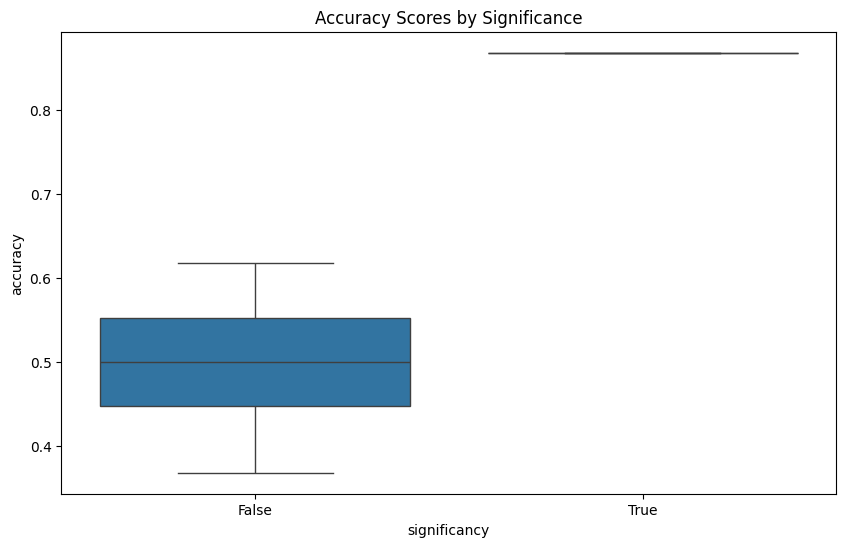

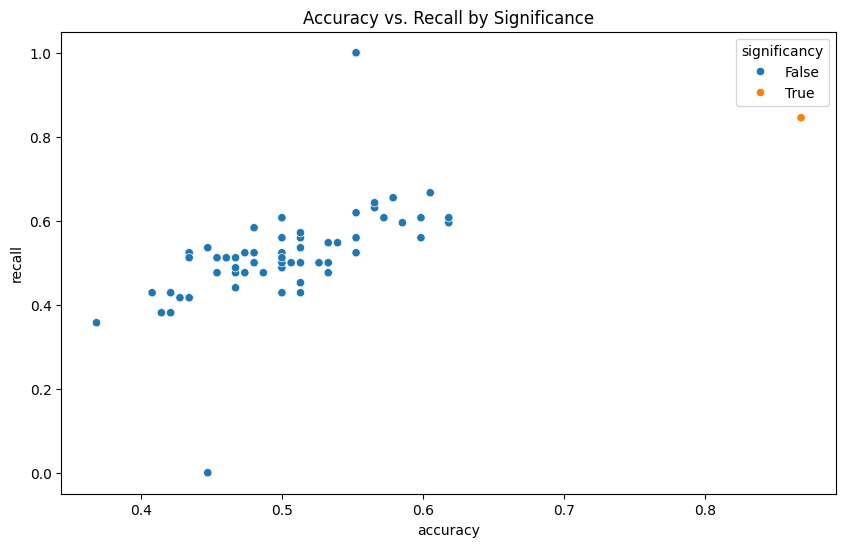

In [19]:
# 模型扰动结果可视化
import matplotlib.pyplot as plt
import seaborn as sns

# 筛选显著性结果
significant_results = results[results['significancy']]

# 绘制准确率的箱形图
plt.figure(figsize=(10, 6))
sns.boxplot(data=results, x='significancy', y='accuracy')
plt.title('Accuracy Scores by Significance')
plt.show()

# 绘制准确率和召回率的散点图
plt.figure(figsize=(10, 6))
sns.scatterplot(data=results, x='accuracy', y='recall', hue='significancy')
plt.title('Accuracy vs. Recall by Significance')
plt.show()

#### 提前训练模型

In [24]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.neighbors import KNeighborsClassifier

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test

# 初始化和训练逻辑回归模型
LR = LogisticRegressionCV(random_state=0, n_jobs=-1,
                          solver='saga',
                          penalty='l1',
                          class_weight='balanced',
                          fit_intercept=True,
                          dual=False
                          #max_iter=1000 # 增加最大迭代次数
                         )

# 训练模型
LR.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=LR, iterations=100)


# 使用Scrambler的validate验证模型，假设以DataFrame形式返回了结果
results = scrambler.validate(
    X=X_train, 
    Y=Y_train_np, 
    scoring="accuracy", # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01,
    as_df=True  # 假设我们想直接以DataFrame形式获取结果
)

# 检查是否返回了DataFrame
if isinstance(results, pd.DataFrame):
    # 将DataFrame保存到CSV文件
    results.to_csv("validation_results.csv", index=False)
    print("Results saved to CSV file.")
    print(results)
else:
    # 如果返回的不是DataFrame，则进行解包
    accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results
    print("Accuracy Scores:", accuracy_scores)
    print("Recall Scores:", recall_scores)
    print("Precision Scores:", precision_scores)
    print("Z-Scores:", zscores)
    print("P-Values:", pvalues)
    print("Significances:", significances)

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/p

Results saved to CSV file.
     accuracy    recall  precision   roc_auc       mcc  avg_precision  \
0    0.881579  0.859155   0.884058  0.880195  0.761981       0.825332   
1    0.532895  0.000000   0.000000  0.500000  0.000000       0.467105   
2    0.532895  0.000000   0.000000  0.500000  0.000000       0.467105   
3    0.532895  0.000000   0.000000  0.500000  0.000000       0.467105   
4    0.453947  0.422535   0.416667  0.452008 -0.095908       0.445793   
..        ...       ...        ...       ...       ...            ...   
96   0.467105  1.000000   0.467105  0.500000  0.000000       0.467105   
97   0.532895  0.000000   0.000000  0.500000  0.000000       0.467105   
98   0.467105  1.000000   0.467105  0.500000  0.000000       0.467105   
99   0.467105  1.000000   0.467105  0.500000  0.000000       0.467105   
100  0.559211  0.521127   0.528571  0.556860  0.113828       0.499137   

       zscore        pvalue  significancy  
0    6.668814  2.578792e-11          True  
1    0.4

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


In [26]:
import pandas as pd
import numpy as np

# 随机提取10次模型扰动的结果
# 随机选取10次扰动的索引，排除第0行（原始模型的评分）
random_indices = np.random.choice(results.index[1:], size=10, replace=False)

# 使用iloc直接选择这些索引的行
selected_scrambled_metrics = results.iloc[random_indices]

# 保存选取的扰动模型指标到CSV
selected_scrambled_metrics.to_csv("selected_scrambled_metrics.csv", index=False)

# 假设results是已经通过validate方法获得的DataFrame，并且包含了原始模型的数据在第一行
original_model_data = results.iloc[0]

# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'Average Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        original_model_data['accuracy'],
        original_model_data['recall'],
        original_model_data['precision'],
        original_model_data['roc_auc'],
        original_model_data['mcc'],
        original_model_data['avg_precision'],
        original_model_data['zscore'],
        original_model_data['pvalue'],
        '显著' if original_model_data['significancy'] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

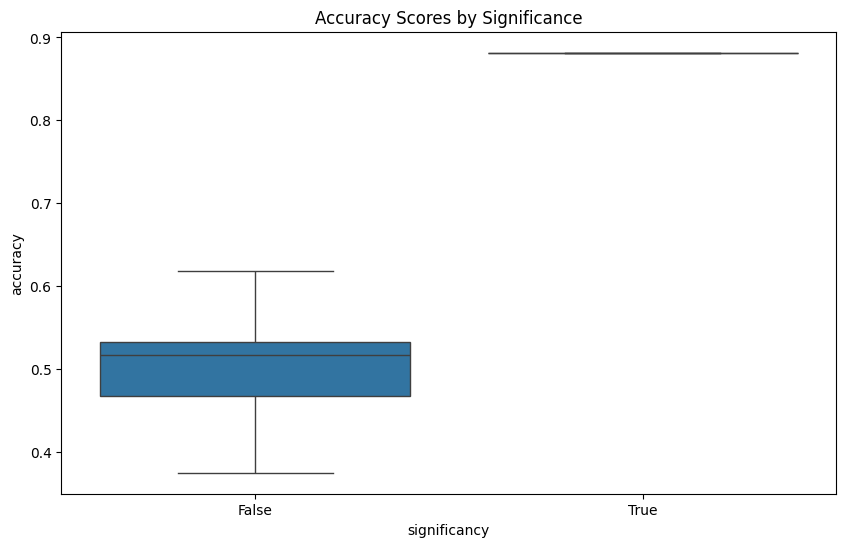

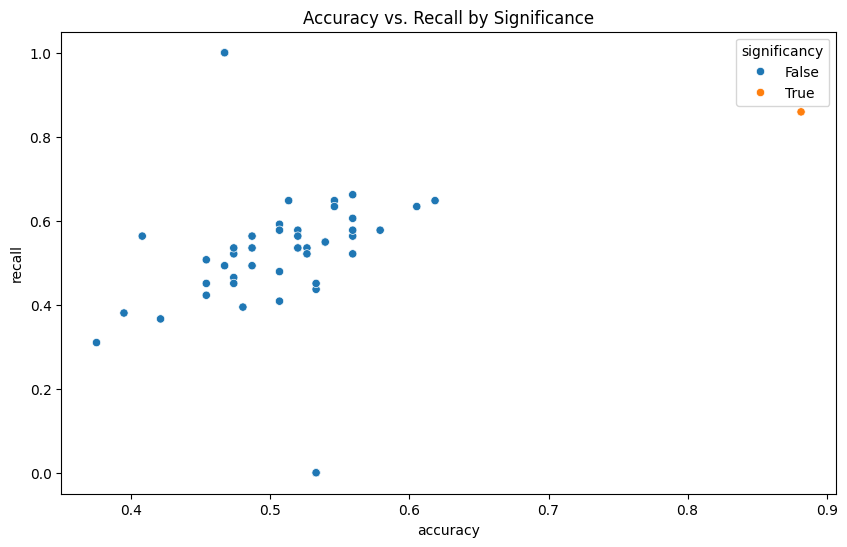

In [25]:
# 模型扰动结果可视化
import matplotlib.pyplot as plt
import seaborn as sns

# 筛选显著性结果
significant_results = results[results['significancy']]

# 绘制准确率的箱形图
plt.figure(figsize=(10, 6))
sns.boxplot(data=results, x='significancy', y='accuracy')
plt.title('Accuracy Scores by Significance')
plt.show()

# 绘制准确率和召回率的散点图
plt.figure(figsize=(10, 6))
sns.scatterplot(data=results, x='accuracy', y='recall', hue='significancy')
plt.title('Accuracy vs. Recall by Significance')
plt.show()

### KNeighbors参数搜索

In [50]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV

# 定义一个函数用于模型训练和参数优化
def KNeighborsClassifier_model(X,Y):   
    # 创建KNN分类器实例，指定单线程工作
    KNeighborsClassifier_auto = KNeighborsClassifier(n_jobs=1)
    # 定义要搜索的参数网格
    param_dict = {
        "n_neighbors": [2,3,4,5,6,7,8,9,10,11,12,13,14,15], # 邻居数
        "algorithm": ['auto', 'ball_tree', 'kd_tree', 'brute'], # 计算最近邻的算法
        "weights": ['uniform', 'distance'], # 权重计算方式
        "p": [1, 2], # 距离度量的方式，1表示曼哈顿距离，2表示欧式距离
    }
    # 使用GridSearchCV进行参数网格搜索，cv=cv使用5折交叉验证，n_jobs=-1使用所有CPU核心，scoring="roc_auc"使用ROC曲线下的面积(AUC)作为评分标准
    estimator = GridSearchCV(estimator=KNeighborsClassifier_auto, param_grid=param_dict, cv=cv, n_jobs=-1, scoring="roc_auc")
    # 拟合模型
    estimator.fit(X,Y)
    # 返回最佳参数组合、最佳分数以及最佳模型
    return estimator.best_params_, estimator.best_score_, estimator.best_estimator_

# 对函数进行调用，传入特征集X和目标变量Y
tmp_1, tmp_2, KNeighborsClassifier_auto = KNeighborsClassifier_model(X,Y)
# 打印最佳参数、最佳分数和最佳模型
print(tmp_1, tmp_2, KNeighborsClassifier_auto)

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1

{'algorithm': 'kd_tree', 'n_neighbors': 8, 'p': 1, 'weights': 'distance'} 0.9405952380952382 KNeighborsClassifier(algorithm='kd_tree', n_jobs=1, n_neighbors=8, p=1,
                     weights='distance')


In [51]:
from sklearn.neighbors import KNeighborsClassifier
from time import time
begin_time = time()  # 开始计时

# 实例化KNN分类器，设置使用单一CPU执行
KNeighborsClassifier_auto = KNeighborsClassifier(n_jobs=1)

# 定义超参数搜索的范围
random_forest_hp_range = {
    "n_neighbors": [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15],  # 邻居数量的范围
    "algorithm": ['auto', 'ball_tree', 'kd_tree', 'brute'],  # 计算邻居的算法
    "weights": ['uniform', 'distance'],  # 权重函数
    "p": [1, 2],  # Minkowski距离的幂参数
}
print(random_forest_hp_range)

# 使用网格搜索找到最优超参数组合
estimator_all_roc = GridSearchCV(
    estimator=KNeighborsClassifier_auto,  # KNN分类器
    param_grid=random_forest_hp_range,  # 超参数范围
    cv=5,  # 交叉验证策略，原来是CV
    n_jobs=-1,  # 使用所有可用CPU
    scoring="roc_auc",  # 使用ROC_AUC评分
    verbose=1  # 显示搜索时的消息
)
estimator_all_roc.fit(X, Y)  # 训练模型

end_time = time()  # 结束计时
print(f"搜索耗时: {end_time - begin_time}秒")

# 打印最佳参数和对应的ROC AUC分数
print(estimator_all_roc.best_params_)
print(estimator_all_roc.best_score_)

# 提取搜索结果，并保存到DataFrame中
tmp = pd.DataFrame(estimator_all_roc.cv_results_)
df_fig = tmp[["mean_test_score", "params"]]
df_fig.to_csv("tmp2-knn.csv", index=False)  # 保存到CSV文件

# 为每个参数添加单独的列，并填充默认值
df_fig["n_neighbors"] = 1
df_fig['algorithm'] = 1
df_fig["weights"] = 1
df_fig['p'] = 1

# 遍历结果DataFrame，从params列中提取参数，并更新相应的列
for i in range(0, df_fig.shape[0]):
    dict_tmp = df_fig["params"].iloc[i]
    df_fig["n_neighbors"].iloc[i] = dict_tmp["n_neighbors"]
    df_fig["algorithm"].iloc[i] = dict_tmp["algorithm"]
    df_fig["weights"].iloc[i] = dict_tmp["weights"]
    df_fig['p'].iloc[i] = dict_tmp['p']
    
# 打印前50行结果并保存
df_fig.head(50)
df_fig.to_csv("网格搜索结果KNN.csv", index=False)  # 将网格搜索结果保存为CSV文件
df_fig.describe()  # 给出结果的统计摘要

{'n_neighbors': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15], 'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'], 'weights': ['uniform', 'distance'], 'p': [1, 2]}
Fitting 5 folds for each of 224 candidates, totalling 1120 fits


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1

搜索耗时: 5.124566555023193秒
{'algorithm': 'ball_tree', 'n_neighbors': 5, 'p': 1, 'weights': 'distance'}
0.9488095238095239


,mean_test_score,n_neighbors,p
count,224.000000,224.000000,224.00000
mean,0.907408,8.500000,1.50000
std,0.034701,4.040157,0.50112
min,0.818839,2.000000,1.00000
25%,0.888534,5.000000,1.00000
50%,0.921250,8.500000,1.50000
75%,0.932083,12.000000,2.00000
max,0.948810,15.000000,2.00000


In [48]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn as sk
import warnings

warnings.filterwarnings("ignore")  # 忽略警告信息

# 加载训练和测试数据
train_X = x_mor_train
train_Y = y_mor_train
test_X = x_mor_test
test_Y = y_mor_test

# 实例化KNN分类器，配置超参数
KNN = KNeighborsClassifier(
    n_jobs=1,  # 使用所有可用CPU
    algorithm='ball_tree',  # 使用KD树算法查找最近邻
    n_neighbors=5,  # 最近邻数量
    p=1,  # 使用曼哈顿距离
    weights='distance'  # 所有点权重相同
)

estimator = KNN
estimator.fit(train_X, train_Y)  # 训练模型

# 在训练集和测试集上进行预测
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)

# 输出训练集和测试集的准确度
print(f"训练集准确度是{accuracy_score(train_Y, clf_train)}")
print(f"测试集准确度是{accuracy_score(test_Y, clf_test)}")

训练集准确度是0.9785123966942149
测试集准确度是0.9342105263157895


#### 混淆矩阵

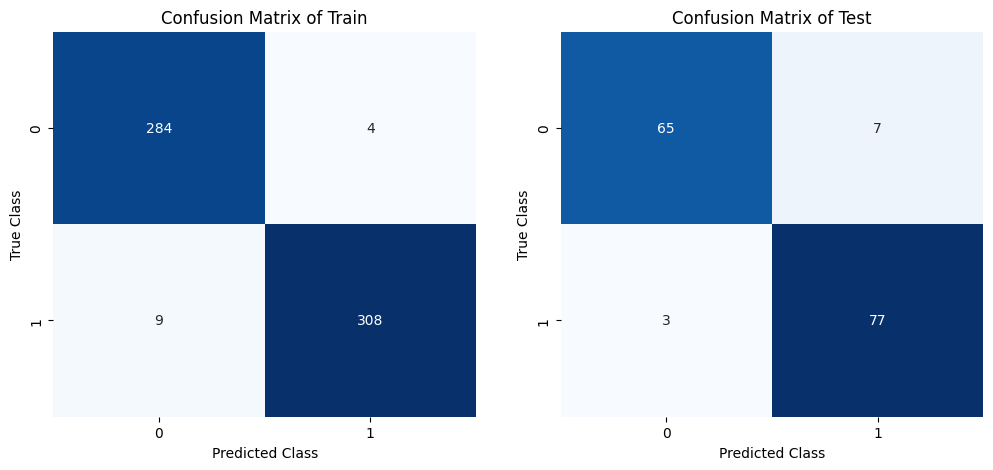

In [49]:
# 绘制混淆矩阵
train_matrix = confusion_matrix(train_Y, clf_train)
test_matrix = confusion_matrix(test_Y, clf_test)
pall = sns.color_palette(['#73a2c6', '#f4777f'])  # 设置颜色
sns.set_palette(pall)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.heatmap(train_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Train")

plt.subplot(1, 2, 2)
sns.heatmap(test_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")
plt.savefig("混淆矩阵_KNN.svg", dpi=600)

#### ROC曲线绘制

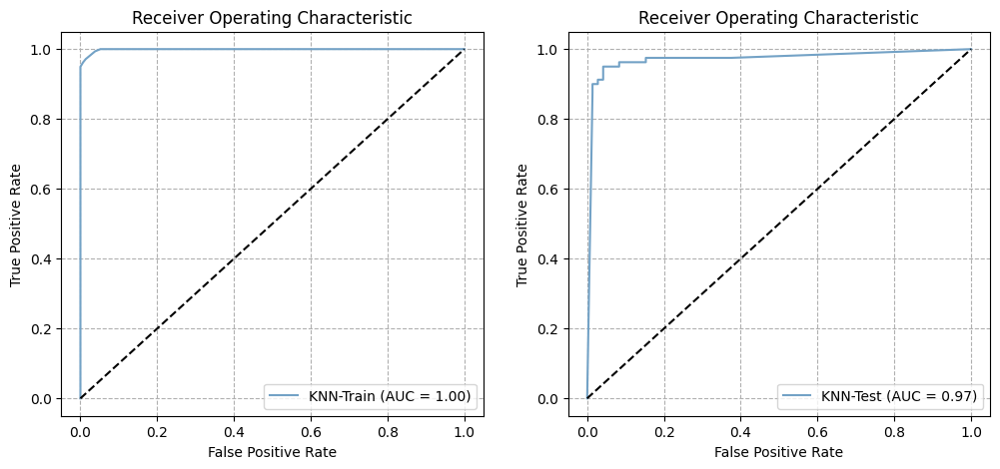

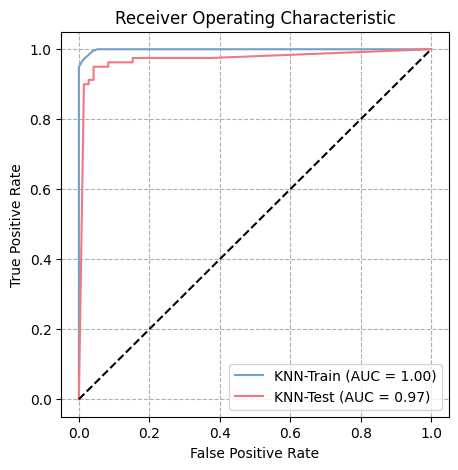

In [50]:
# 绘制训练集和测试集的ROC曲线
# 设置图形大小
plt.figure(figsize=(12, 5))

# 创建第一个子图，用于绘制训练集的ROC曲线
plt.subplot(1, 2, 1)
# 通过模型的predict_proba方法获取训练集上的预测概率，绘制训练集ROC图
y_pro_train = estimator.predict_proba(train_X)[:, 1]  # 计算概率
# 计算训练集的真阳性率（TPR）和假阳性率（FPR）
fpr_train, tpr_train, thresholds = roc_curve(train_Y, y_pro_train)
# 计算AUC值
roc_auc_train = auc(fpr_train, tpr_train)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')  # 设置标题
plt.plot(fpr_train, tpr_train, label='KNN-Train (AUC = %0.2f)' % roc_auc_train) # 绘制ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 创建第二个子图，用于绘制测试集的ROC曲线
plt.subplot(1, 2, 2)
# 通过模型的predict_proba方法获取测试集上的预测概率
y_pro_test = estimator.predict_proba(test_X)[:, 1]
# 计算测试集的真阳性率（TPR）和假阳性率（FPR）
fpr_test, tpr_test, thresholds = roc_curve(test_Y, y_pro_test)
# 计算AUC值
roc_auc_test = auc(fpr_test, tpr_test)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')
plt.plot(fpr_test, tpr_test, label='KNN-Test (AUC = %0.2f)' % roc_auc_test)
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 保存训练集和测试集的ROC曲线图
plt.savefig("ROC_KNN.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的ROC组合图
plt.figure(figsize=(5, 5))
# 绘制 ROC 曲线
plt.plot(fpr_train, tpr_train, label='KNN-Train (AUC = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, label='KNN-Test (AUC = %0.2f)' % roc_auc_test)
# 绘制对角线
plt.plot([0, 1], [0, 1], '--', color='black')  #颜色
# 添加背景网格
plt.grid(True, linestyle='--')
# 设置标题和标签
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的ROC组合图
plt.savefig("ROC_KNN_组合.svg", dpi=600)
plt.show()

#### PR_AUC曲线的绘制

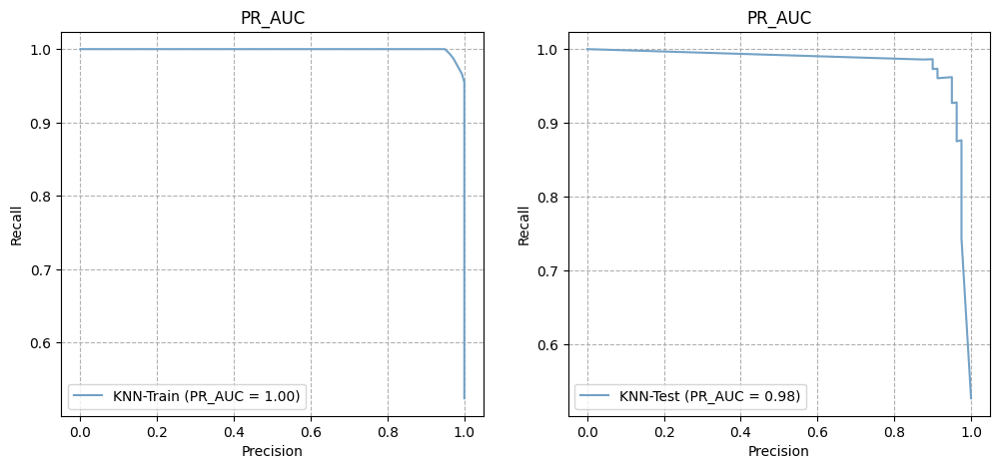

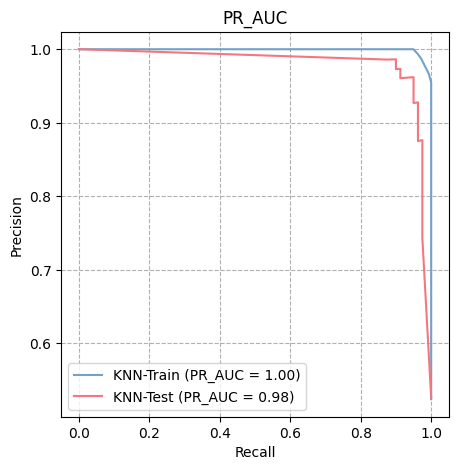

In [51]:
# 绘制PR_AUC曲线来评估模型在处理不平衡数据上的性能
# 设置绘图的大小
plt.figure(figsize=(12, 5))

# 训练集PR_AUC曲线
plt.subplot(1, 2, 1)
# 计算精确度和召回率
precision_train, recall_train, thresholds = precision_recall_curve(train_Y, y_pro_train, pos_label=1)
average_precision_train = average_precision_score(train_Y, y_pro_train)
pr_auc_train = metrics.auc(recall_train, precision_train)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_train, precision_train, label='KNN-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 测试集PR_AUC曲线
plt.subplot(1, 2, 2)
# 计算精确度和召回率
precision_test, recall_test, thresholds = precision_recall_curve(test_Y, y_pro_test, pos_label=1)
average_precision_test = average_precision_score(test_Y, y_pro_test)
pr_auc_test = metrics.auc(recall_test, precision_test)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_test, precision_test, label='KNN-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 保存训练集和测试集的PR_AUCC曲线图
plt.savefig("PR_KNN.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的PR_AUC组合图
plt.figure(figsize=(5, 5))
# 绘制训练集PR_AUC图
plt.plot(recall_train, precision_train, label='KNN-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# 绘制测试集PR_AUC图
plt.plot(recall_test, precision_test, label='KNN-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
# 设置标题和标签
plt.title('PR_AUC')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc="lower left") # 设置图例位置
plt.grid(True, linestyle='--') # 添加背景网格
# 设置图形边框
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的PR_AUC组合图
plt.savefig("PR_KNN_组合.svg", dpi=600)
plt.show()

#### 模型评估与性能指标的计算

In [52]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import average_precision_score

estimator = KNN
estimator.fit(train_X, train_Y)
clf_test = estimator.predict(test_X)
acc_test = accuracy_score(test_Y,clf_test)
roc_test = roc_auc_score(test_Y,clf_test)
pre_test = precision_score(test_Y,clf_test)
rec_test = recall_score(test_Y,clf_test)
f1_test = f1_score(test_Y,clf_test)
mcc_test = matthews_corrcoef(test_Y,clf_test)
matrix_test = confusion_matrix(test_Y,clf_test)
ap_test = average_precision_score(test_Y,clf_test)

algorithm_model = [KNN]
algorithm_name = ["KNN"]
tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_test
Acc_data.loc[algorithm_name]  = acc_test
Recall_data.loc[algorithm_name] = rec_test
Precision_data.loc[algorithm_name] = pre_test
F1_data.loc[algorithm_name]  = f1_test
MCC_data.loc[algorithm_name]  = mcc_test
Ap_data.loc[algorithm_name]  = ap_test

Auc_data.to_csv("test_ROC.csv")
Acc_data.to_csv("test_ACC.csv")
Recall_data.to_csv("test_REC.csv")
Precision_data.to_csv("test_PRE.csv")
F1_data.to_csv("test_F1.csv")
MCC_data.to_csv("test_MCC.csv")
Ap_data.to_csv("test_AP.csv")

clf_train = estimator.predict(train_X)
acc_train = accuracy_score(train_Y,clf_train)
roc_train = roc_auc_score(train_Y,clf_train)
pre_train = precision_score(train_Y,clf_train)
rec_train = recall_score(train_Y,clf_train)
f1_train = f1_score(train_Y,clf_train)
mcc_train = matthews_corrcoef(train_Y,clf_train)
matrix_train = confusion_matrix(train_Y,clf_train)
ap_train = average_precision_score(train_Y,clf_train)

tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_train
Acc_data.loc[algorithm_name]  = acc_train
Recall_data.loc[algorithm_name] = rec_train
Precision_data.loc[algorithm_name] = pre_train
F1_data.loc[algorithm_name]  = f1_train
MCC_data.loc[algorithm_name]  = mcc_train
Ap_data.loc[algorithm_name]  = ap_train

Auc_data.to_csv("train_ROC.csv")
Acc_data.to_csv("train_ACC.csv")
Recall_data.to_csv("train_REC.csv")
Precision_data.to_csv("train_PRE.csv")
F1_data.to_csv("train_F1.csv")
MCC_data.to_csv("train_MCC.csv")
Ap_data.to_csv("train_AP.csv")

In [53]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用


# 设置训练集和测试集的特征和标签
X_train = train_X = x_mor_train
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test

# 实例化KNN分类器，配置超参数
KNN = KNeighborsClassifier(
    n_jobs=1,  # 使用所有可用CPU
    algorithm='ball_tree',  # 使用KD树算法查找最近邻
    n_neighbors=5,  # 最近邻数量
    p=1,  # 使用曼哈顿距离
    weights='distance'  # 所有点权重相同
)

# 训练模型
estimator = KNN
estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="accuracy", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [54]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.7894736842105263
基模型显著性: 显著
打乱模型平均得分: 0.4969078947368422
打乱模型最高得分: 0.6578947368421053
显著的打乱次数/总打乱次数: 0/100 (0.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.32894736842105265, z分数=-2.2748964504249702, p值=0.02291214233861643, 显著性=不显著
打乱模型 2: 得分=0.5592105263157895, z分数=0.7909666651877889, p值=0.4289634441433119, 显著性=不显著
打乱模型 3: 得分=0.5986842105263158, z分数=1.3165431992928336, p值=0.18799178900633173, 显著性=不显著
打乱模型 4: 得分=0.5592105263157895, z分数=0.7909666651877889, p值=0.4289634441433119, 显著性=不显著
打乱模型 5: 得分=0.4407894736842105, z分数=-0.7857629371273449, p值=0.43200638365810407, 显著性=不显著


#### 修改源码

In [20]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.neighbors import KNeighborsClassifier

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test


# 实例化KNN分类器，配置超参数
KNN = KNeighborsClassifier(
    n_jobs=1,  # 使用所有可用CPU
    algorithm='ball_tree',  # 使用KD树算法查找最近邻
    n_neighbors=5,  # 最近邻数量
    p=1,  # 使用曼哈顿距离
    weights='distance'  # 所有点权重相同
)

# 训练模型
KNN.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=KNN, iterations=100)


# 使用Scrambler的validate验证模型，假设以DataFrame形式返回了结果
results = scrambler.validate(
    X=X_train, 
    Y=Y_train_np, 
    scoring="accuracy", # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01,
    as_df=True  # 假设我们想直接以DataFrame形式获取结果
)

# 检查是否返回了DataFrame
if isinstance(results, pd.DataFrame):
    # 将DataFrame保存到CSV文件
    results.to_csv("validation_results.csv", index=False)
    print("Results saved to CSV file.")
    print(results)
else:
    # 如果返回的不是DataFrame，则进行解包
    accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results
    print("Accuracy Scores:", accuracy_scores)
    print("Recall Scores:", recall_scores)
    print("Precision Scores:", precision_scores)
    print("Z-Scores:", zscores)
    print("P-Values:", pvalues)
    print("Significances:", significances)

Results saved to CSV file.
     accuracy    recall  precision   roc_auc       mcc  avg_precision  \
0    0.848684  0.853333   0.842105  0.848745  0.697429       0.790965   
1    0.552632  0.666667   0.537634  0.554113  0.111029       0.522897   
2    0.664474  0.653333   0.662162  0.664329  0.328743       0.603665   
3    0.559211  0.600000   0.548780  0.559740  0.119844       0.526637   
4    0.493421  0.680000   0.490385  0.495844 -0.008940       0.491356   
..        ...       ...        ...       ...       ...            ...   
96   0.559211  0.600000   0.548780  0.559740  0.119844       0.526637   
97   0.506579  0.546667   0.500000  0.507100  0.014242       0.497018   
98   0.434211  0.466667   0.432099  0.434632 -0.131008       0.464804   
99   0.578947  0.693333   0.559140  0.580433  0.165034       0.538986   
100  0.480263  0.546667   0.476744  0.481126 -0.038077       0.484304   

       zscore        pvalue  significancy  
0    5.425354  5.783974e-08          True  
1    0.6

In [21]:
import pandas as pd
import numpy as np

# 随机提取10次模型扰动的结果
# 随机选取10次扰动的索引，排除第0行（原始模型的评分）
random_indices = np.random.choice(results.index[1:], size=10, replace=False)

# 使用iloc直接选择这些索引的行
selected_scrambled_metrics = results.iloc[random_indices]

# 保存选取的扰动模型指标到CSV
selected_scrambled_metrics.to_csv("selected_scrambled_metrics.csv", index=False)

# 假设results是已经通过validate方法获得的DataFrame，并且包含了原始模型的数据在第一行
original_model_data = results.iloc[0]

# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'Average Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        original_model_data['accuracy'],
        original_model_data['recall'],
        original_model_data['precision'],
        original_model_data['roc_auc'],
        original_model_data['mcc'],
        original_model_data['avg_precision'],
        original_model_data['zscore'],
        original_model_data['pvalue'],
        '显著' if original_model_data['significancy'] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

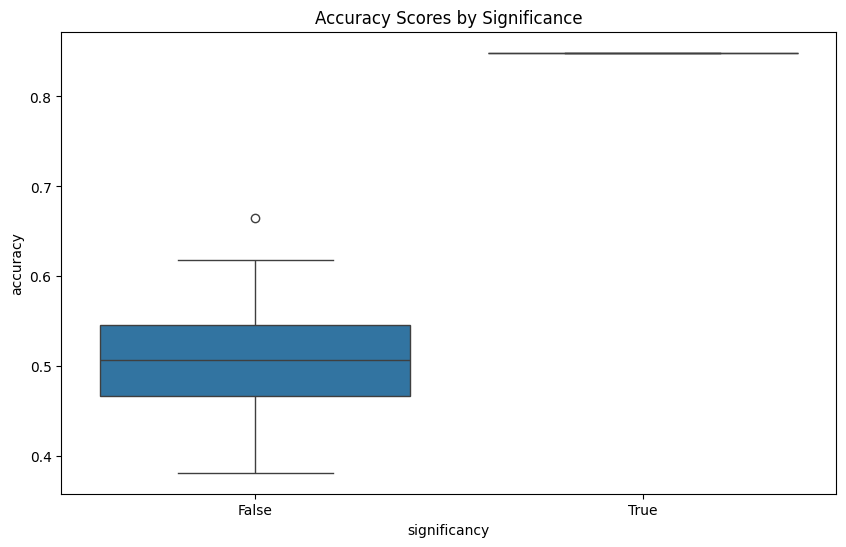

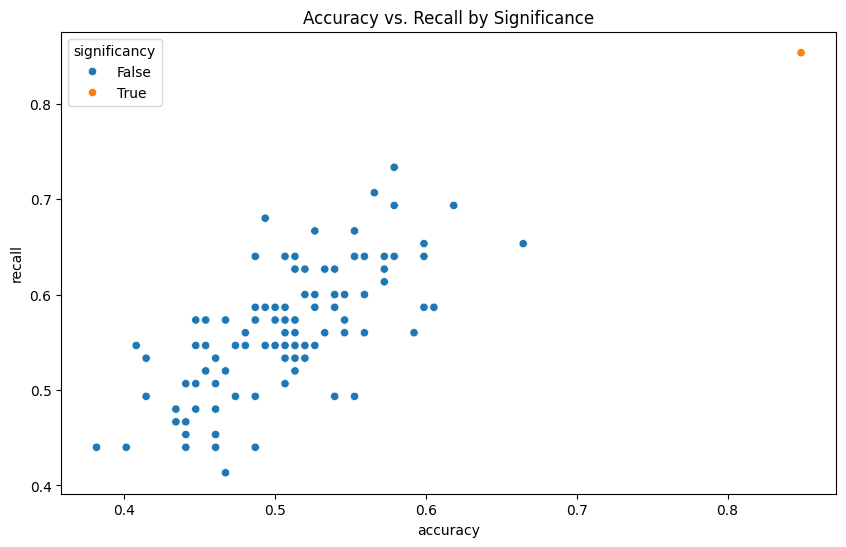

In [22]:
# 模型扰动结果可视化
import matplotlib.pyplot as plt
import seaborn as sns

# 筛选显著性结果
significant_results = results[results['significancy']]

# 绘制准确率的箱形图
plt.figure(figsize=(10, 6))
sns.boxplot(data=results, x='significancy', y='accuracy')
plt.title('Accuracy Scores by Significance')
plt.show()

# 绘制准确率和召回率的散点图
plt.figure(figsize=(10, 6))
sns.scatterplot(data=results, x='accuracy', y='recall', hue='significancy')
plt.title('Accuracy vs. Recall by Significance')
plt.show()

### SVM参数搜索

In [57]:
from sklearn.svm import SVC
from time import time
# 记录开始时间
begin_time = time()
# 初始化SVC模型，设置随机状态以保证结果可重现，probability=True允许计算概率
SVC_auto = SVC(random_state=0, probability=True)

# 定义要测试的参数范围
random_forest_hp_range = {
    "gamma": ['0.1,0.2,0.3', 'auto'],  # 核函数参数
    'C': [0.1, 1, 10, 100],  # 正则化参数
    "kernel": ['linear', 'poly', 'rbf', 'sigmoid'],  # 核函数类型
    "shrinking": [True, False],  # 是否使用收缩启发式
    "class_weight": ['none', 'balanced'],  # 类别权重
}
print(random_forest_hp_range)

# 使用GridSearchCV进行参数网格搜索
estimator_all_roc = GridSearchCV(estimator=SVC_auto,
                                 param_grid=random_forest_hp_range,
                                 cv=cv,  # 交叉验证策略
                                 n_jobs=-1,  # 使用所有处理器
                                 scoring="roc_auc",  # 使用ROC AUC分数作为评估标准
                                 verbose=1)
estimator_all_roc.fit(X, Y)  # 训练模型
end_time = time()
print({end_time - begin_time})  # 打印训练所用时间
print(estimator_all_roc.best_params_)  # 打印最佳参数组合
print(estimator_all_roc.best_score_)  # 打印最佳分数

# 将结果保存到DataFrame并输出到CSV文件
tmp = pd.DataFrame(estimator_all_roc.cv_results_)
df_fig = tmp[["mean_test_score", "params"]]
df_fig.to_csv("tmp2-svm.csv", index=False)
# 为结果DataFrame添加列，用于后续分析
df_fig["gamma"] = 1
df_fig["C"] = 1
df_fig['kernel'] = 1
df_fig["shrinking"] = 1
df_fig['class_weight'] = 1
# 遍历所有参数组合，提取具体参数值
for i in range(0, df_fig.shape[0]):
    dict_tmp = df_fig["params"].iloc[i]
    df_fig["gamma"].iloc[i] = dict_tmp["gamma"]
    df_fig["C"].iloc[i] = dict_tmp["C"]
    df_fig["kernel"].iloc[i] = dict_tmp["kernel"]
    df_fig["shrinking"].iloc[i] = dict_tmp["shrinking"]
    df_fig['class_weight'].iloc[i] = dict_tmp['class_weight']

# 输出前50个结果并保存整个DataFrame到CSV文件
df_fig.head(50)
df_fig.to_csv("网格搜索结果SVM.csv", index=False)
# 显示结果的描述性统计信息
df_fig.describe()

{'gamma': ['0.1,0.2,0.3', 'auto'], 'C': [0.1, 1, 10, 100], 'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 'shrinking': [True, False], 'class_weight': ['none', 'balanced']}
Fitting 5 folds for each of 128 candidates, totalling 640 fits
{7.86611533164978}
{'C': 0.1, 'class_weight': 'balanced', 'gamma': 'auto', 'kernel': 'linear', 'shrinking': True}
0.9557142857142857


,mean_test_score,C
count,32.000000,128.00000
mean,0.928371,27.77500
std,0.030440,42.04297
min,0.886964,0.10000
25%,0.890655,0.77500
50%,0.948036,5.50000
75%,0.952024,32.50000
max,0.955714,100.00000


In [41]:
# 导入必要的库
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# 设置数据集
train_X = x_mor_train  # 训练集特征
train_Y = y_mor_train  # 训练集标签
test_X = x_mor_test    # 测试集特征
test_Y = y_mor_test    # 测试集标签

# 初始化SVM模型并设置参数
SVM = SVC(random_state=0,        # 随机数种子
          class_weight='balanced',  # 类别权重平衡
          gamma='auto',             # 核函数的系数
          C=0.1,                     # 正则化参数
          kernel='linear',         # 使用sigmoid核
          shrinking=True,           # 是否使用shrinking heuristic方法
          probability=True)         # 是否启用概率估计

# 训练模型
estimator = SVM
estimator.fit(train_X, train_Y)

# 在训练集和测试集上进行预测
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)

# 计算并打印准确度
print(f"训练集准确度是{accuracy_score(train_Y, clf_train)}")
print(f"测试集准确度是{accuracy_score(test_Y, clf_test)}")

训练集准确度是0.9388429752066115
测试集准确度是0.9473684210526315


#### 绘制混淆矩阵

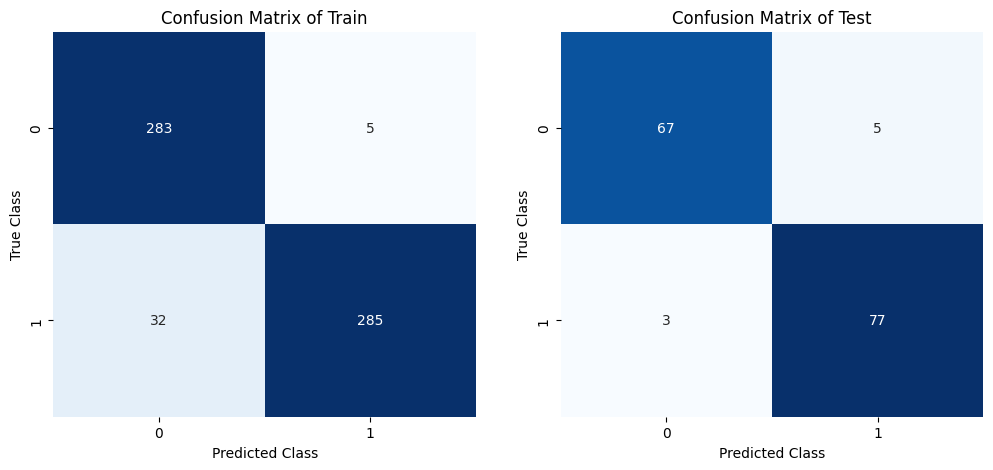

In [42]:
# 生成并绘制混淆矩阵
train_matrix = confusion_matrix(train_Y, clf_train)
test_matrix = confusion_matrix(test_Y, clf_test)

# 设置绘图风格
pall = sns.color_palette(['#73a2c6', '#f4777f'])
sns.set_palette(pall)

# 绘制训练集的混淆矩阵
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.heatmap(train_matrix, annot=True, cmap="Blues", cbar=False, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Train")

# 绘制测试集的混淆矩阵
plt.subplot(1, 2, 2)
sns.heatmap(test_matrix, annot=True, cmap="Blues", cbar=False, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")

# 保存并显示图形
plt.savefig("混淆矩阵_SVM.svg", dpi=600)
plt.show()

#### 绘制ROC曲线

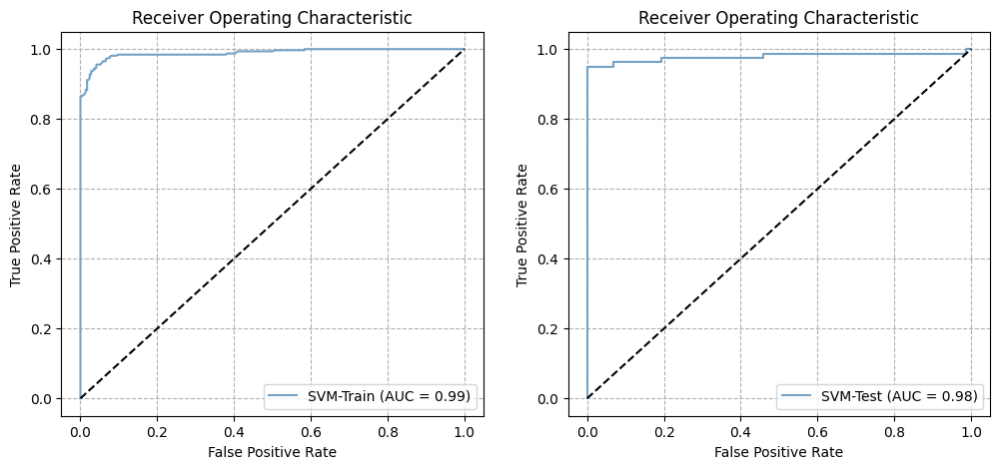

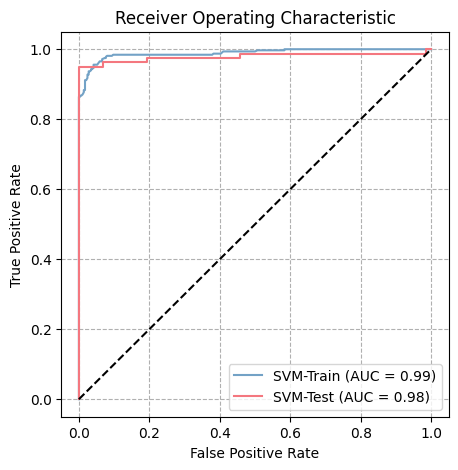

In [43]:
# 导入必要的库
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score

# 绘制ROC曲线的整体布局设置
plt.figure(figsize=(12, 5))

# 第一部分：绘制训练集的ROC曲线
plt.subplot(1, 2, 1) # 在一个1行2列的子图布局中选择第一个位置
y_pro_train = estimator.predict_proba(train_X)[:, 1] # 预测训练集的正类概率
fpr_train, tpr_train, thresholds = roc_curve(train_Y, y_pro_train) # 计算FPR和TPR
roc_auc_train = auc(fpr_train, tpr_train) # 计算曲线下面积AUC
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic') # 设置图表标题
plt.plot(fpr_train, tpr_train, label='SVM-Train (AUC = %0.2f)' % roc_auc_train) # 绘制ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 第二部分：绘制测试集的ROC曲线
plt.subplot(1, 2, 2)  # 在一个1行2列的子图布局中选择第二个位置
y_pro_test = estimator.predict_proba(test_X)[:, 1]  # 预测测试集的正类概率
fpr_test, tpr_test, thresholds = roc_curve(test_Y, y_pro_test)  # 计算FPR和TPR
roc_auc_test = auc(fpr_test, tpr_test) # 计算曲线下面积AUC
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')
plt.plot(fpr_test, tpr_test, label='SVM-Test (AUC = %0.2f)' % roc_auc_test)
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 保存训练集和测试集的ROC曲线图
plt.savefig("ROC_SVM.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的ROC组合图
plt.figure(figsize=(5, 5))
# 绘制 ROC 曲线
plt.plot(fpr_train, tpr_train, label='SVM-Train (AUC = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, label='SVM-Test (AUC = %0.2f)' % roc_auc_test)
# 绘制对角线
plt.plot([0, 1], [0, 1], '--', color='black')  #颜色
# 添加背景网格
plt.grid(True, linestyle='--')
# 设置标题和标签
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的ROC组合图
plt.savefig("ROC_SVM_组合.svg", dpi=600)
plt.show()

#### 绘制PR_AUC曲线

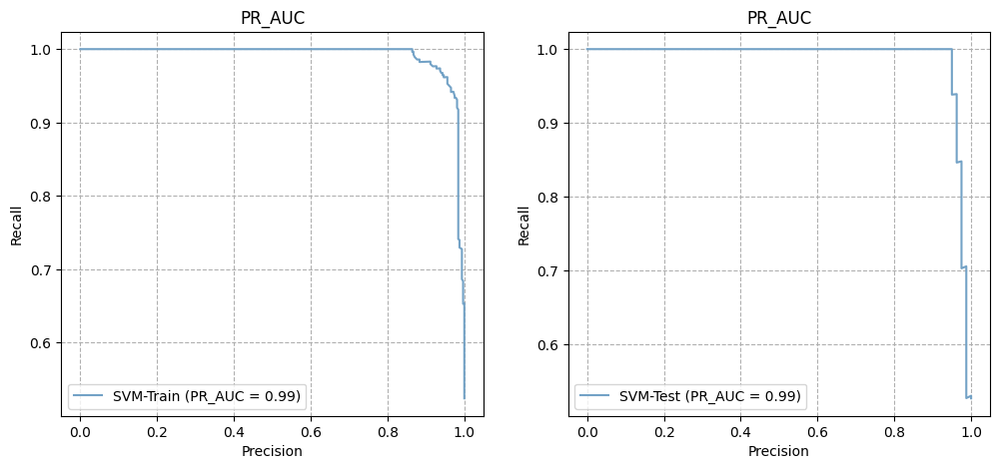

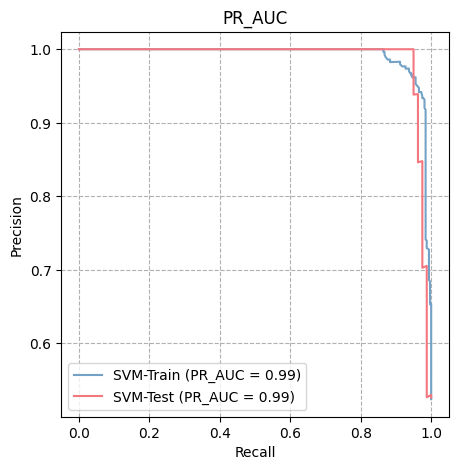

In [44]:
# 绘制PR_AUC曲线来评估模型在处理不平衡数据上的性能
# 设置绘图的大小
plt.figure(figsize=(12, 5))

# 训练集PR_AUC曲线
plt.subplot(1, 2, 1)
# 计算精确度和召回率
precision_train, recall_train, thresholds = precision_recall_curve(train_Y, y_pro_train, pos_label=1)
average_precision_train = average_precision_score(train_Y, y_pro_train)
pr_auc_train = metrics.auc(recall_train, precision_train)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_train, precision_train, label='SVM-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 测试集PR_AUC曲线
plt.subplot(1, 2, 2)
# 计算精确度和召回率
precision_test, recall_test, thresholds = precision_recall_curve(test_Y, y_pro_test, pos_label=1)
average_precision_test = average_precision_score(test_Y, y_pro_test)
pr_auc_test = metrics.auc(recall_test, precision_test)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_test, precision_test, label='SVM-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 保存训练集和测试集的PR_AUCC曲线图
plt.savefig("PR_SVM.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的PR_AUC组合图
plt.figure(figsize=(5, 5))
# 绘制训练集PR_AUC图
plt.plot(recall_train, precision_train, label='SVM-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# 绘制测试集PR_AUC图
plt.plot(recall_test, precision_test, label='SVM-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
# 设置标题和标签
plt.title('PR_AUC')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc="lower left") # 设置图例位置
plt.grid(True, linestyle='--') # 添加背景网格
# 设置图形边框
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的PR_AUC组合图
plt.savefig("PR_SVM_组合.svg", dpi=600)
plt.show()

#### 模型评估与性能指标计算

In [45]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import average_precision_score

estimator = SVM
estimator.fit(train_X, train_Y)
clf_test = estimator.predict(test_X)
acc_test = accuracy_score(test_Y,clf_test)
roc_test = roc_auc_score(test_Y,clf_test)
pre_test = precision_score(test_Y,clf_test)
rec_test = recall_score(test_Y,clf_test)
f1_test = f1_score(test_Y,clf_test)
mcc_test = matthews_corrcoef(test_Y,clf_test)
matrix_test = confusion_matrix(test_Y,clf_test)
ap_test = average_precision_score(test_Y,clf_test)

algorithm_model = [SVM]
algorithm_name = ["SVM"]
tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_test
Acc_data.loc[algorithm_name]  = acc_test
Recall_data.loc[algorithm_name] = rec_test
Precision_data.loc[algorithm_name] = pre_test
F1_data.loc[algorithm_name]  = f1_test
MCC_data.loc[algorithm_name]  = mcc_test
Ap_data.loc[algorithm_name]  = ap_test

Auc_data.to_csv("test_ROC.csv")
Acc_data.to_csv("test_ACC.csv")
Recall_data.to_csv("test_REC.csv")
Precision_data.to_csv("test_PRE.csv")
F1_data.to_csv("test_F1.csv")
MCC_data.to_csv("test_MCC.csv")
Ap_data.to_csv("test_AP.csv")

clf_train = estimator.predict(train_X)
acc_train = accuracy_score(train_Y,clf_train)
roc_train = roc_auc_score(train_Y,clf_train)
pre_train = precision_score(train_Y,clf_train)
rec_train = recall_score(train_Y,clf_train)
f1_train = f1_score(train_Y,clf_train)
mcc_train = matthews_corrcoef(train_Y,clf_train)
matrix_train = confusion_matrix(train_Y,clf_train)
ap_train = average_precision_score(train_Y,clf_train)

tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_train
Acc_data.loc[algorithm_name]  = acc_train
Recall_data.loc[algorithm_name] = rec_train
Precision_data.loc[algorithm_name] = pre_train
F1_data.loc[algorithm_name]  = f1_train
MCC_data.loc[algorithm_name]  = mcc_train
Ap_data.loc[algorithm_name]  = ap_train

Auc_data.to_csv("train_ROC.csv")
Acc_data.to_csv("train_ACC.csv")
Recall_data.to_csv("train_REC.csv")
Precision_data.to_csv("train_PRE.csv")
F1_data.to_csv("train_F1.csv")
MCC_data.to_csv("train_MCC.csv")
Ap_data.to_csv("train_AP.csv")

#### 模型扰动

In [46]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用


# 设置训练集和测试集的特征和标签
X_train = train_X = x_mor_train
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test

# 初始化SVM模型并设置参数
SVM = SVC(random_state=0,        # 随机数种子
          class_weight='balanced',  # 类别权重平衡
          gamma='auto',             # 核函数的系数
          C=0.1,                     # 正则化参数
          kernel='linear',         # 使用sigmoid核
          shrinking=True,           # 是否使用shrinking heuristic方法
          probability=True)         # 是否启用概率估计

# 训练模型
estimator = SVM
estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="accuracy", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [47]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.8289473684210527
基模型显著性: 显著
打乱模型平均得分: 0.49243421052631575
打乱模型最高得分: 0.6710526315789473
显著的打乱次数/总打乱次数: 0/100 (0.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.4473684210526316, z分数=-0.5887029248179826, p值=0.5560605755301109, 显著性=不显著
打乱模型 2: 得分=0.5394736842105263, z分数=0.5316549967064174, p值=0.5949649665417781, 显著性=不显著
打乱模型 3: 得分=0.4868421052631579, z分数=-0.10854952987895393, p值=0.9135597934265158, 显著性=不显著
打乱模型 4: 得分=0.5526315789473685, z分数=0.6917061283527607, p值=0.4891218976277495, 显著性=不显著
打乱模型 5: 得分=0.48026315789473684, z分数=-0.1885750957021256, p值=0.8504258533364611, 显著性=不显著


#### 修改源代码

In [27]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.svm import SVC

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test

# 初始化SVM模型并设置参数
SVM = SVC(random_state=0,        # 随机数种子
          class_weight='balanced',  # 类别权重平衡
          gamma='auto',             # 核函数的系数
          C=0.1,                     # 正则化参数
          kernel='linear',         # 使用sigmoid核
          shrinking=True,           # 是否使用shrinking heuristic方法
          probability=True)         # 是否启用概率估计

# 训练模型
SVM.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=SVM, iterations=100)


# 使用Scrambler的validate验证模型，假设以DataFrame形式返回了结果
results = scrambler.validate(
    X=X_train, 
    Y=Y_train_np, 
    scoring="accuracy", # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01,
    as_df=True  # 假设我们想直接以DataFrame形式获取结果
)

# 检查是否返回了DataFrame
if isinstance(results, pd.DataFrame):
    # 将DataFrame保存到CSV文件
    results.to_csv("validation_results.csv", index=False)
    print("Results saved to CSV file.")
    print(results)
else:
    # 如果返回的不是DataFrame，则进行解包
    accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results
    print("Accuracy Scores:", accuracy_scores)
    print("Recall Scores:", recall_scores)
    print("Precision Scores:", precision_scores)
    print("Z-Scores:", zscores)
    print("P-Values:", pvalues)
    print("Significances:", significances)


Results saved to CSV file.
     accuracy    recall  precision   roc_auc       mcc  avg_precision  \
0    0.875000  0.816901   0.906250  0.871414  0.750634       0.825843   
1    0.460526  0.394366   0.417910  0.456442 -0.087543       0.447704   
2    0.592105  0.647887   0.554217  0.595549  0.191497       0.523544   
3    0.473684  0.563380   0.449438  0.479221 -0.042088       0.457152   
4    0.572368  0.591549   0.538462  0.573552  0.146837       0.509316   
..        ...       ...        ...       ...       ...            ...   
96   0.473684  0.492958   0.443038  0.474874 -0.050182       0.455241   
97   0.480263  0.450704   0.444444  0.478439 -0.043089       0.456892   
98   0.460526  0.394366   0.417910  0.456442 -0.087543       0.447704   
99   0.526316  0.549296   0.493671  0.527734  0.055392       0.481698   
100  0.401316  0.464789   0.383721  0.405234 -0.190780       0.428349   

       zscore        pvalue  significancy  
0    5.651166  1.593627e-08          True  
1   -0.6

In [28]:
import pandas as pd
import numpy as np

# 随机提取10次模型扰动的结果
# 随机选取10次扰动的索引，排除第0行（原始模型的评分）
random_indices = np.random.choice(results.index[1:], size=10, replace=False)

# 使用iloc直接选择这些索引的行
selected_scrambled_metrics = results.iloc[random_indices]

# 保存选取的扰动模型指标到CSV
selected_scrambled_metrics.to_csv("selected_scrambled_metrics.csv", index=False)

# 假设results是已经通过validate方法获得的DataFrame，并且包含了原始模型的数据在第一行
original_model_data = results.iloc[0]

# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'Average Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        original_model_data['accuracy'],
        original_model_data['recall'],
        original_model_data['precision'],
        original_model_data['roc_auc'],
        original_model_data['mcc'],
        original_model_data['avg_precision'],
        original_model_data['zscore'],
        original_model_data['pvalue'],
        '显著' if original_model_data['significancy'] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

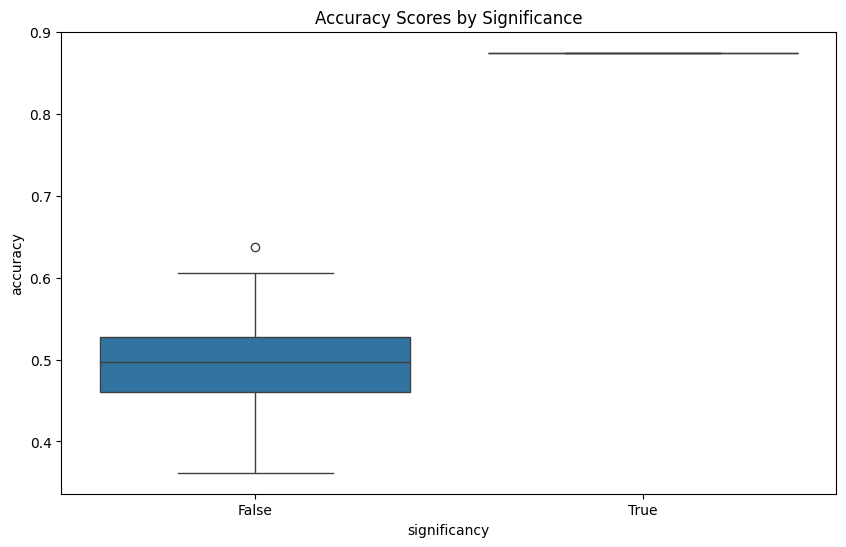

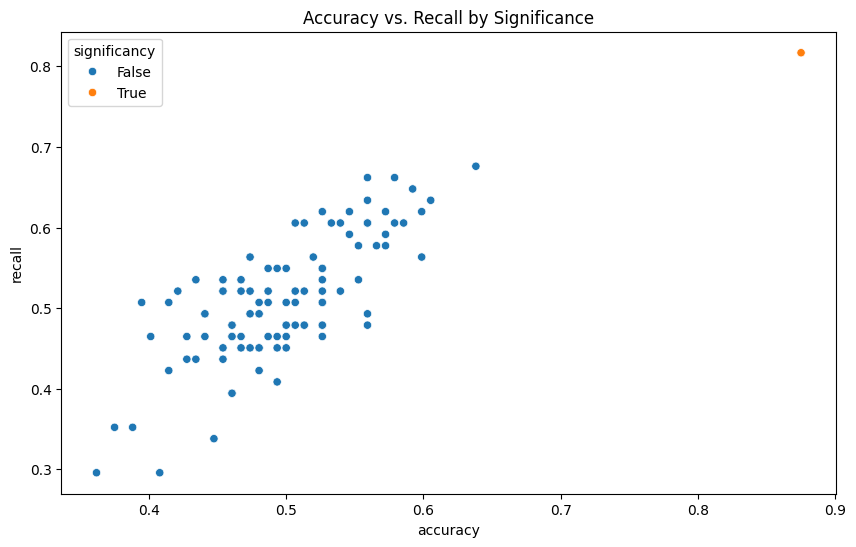

In [29]:
# 模型扰动结果可视化
import matplotlib.pyplot as plt
import seaborn as sns

# 筛选显著性结果
significant_results = results[results['significancy']]

# 绘制准确率的箱形图
plt.figure(figsize=(10, 6))
sns.boxplot(data=results, x='significancy', y='accuracy')
plt.title('Accuracy Scores by Significance')
plt.show()

# 绘制准确率和召回率的散点图
plt.figure(figsize=(10, 6))
sns.scatterplot(data=results, x='accuracy', y='recall', hue='significancy')
plt.title('Accuracy vs. Recall by Significance')
plt.show()

### RF参数搜索

In [118]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

# 实例化随机森林分类器，设置随机状态以确保结果可复现，n_jobs=-1允许并行处理，加速模型训练
RandomForestClassifier_auto = RandomForestClassifier(random_state=0, n_jobs=-1)

# 定义函数进行随机森林模型的参数优化
def RandomForestClassifier_model(X, Y):
    # 定义要搜索的参数字典
    param_dict = {
        "criterion": ['gini', 'entropy'],  # 指定分裂节点时的评价标准
        "max_features": ["log2", 'auto', 'sqrt'],  # 指定寻找最佳分割时考虑的特征数量
        "class_weight": ['balanced', 'none'],  # 类别权重，用于处理不平衡数据集
        "bootstrap": [True, False],  # 是否使用bootstrap抽样
        "oob_score": [True, False]  # 是否使用袋外样本来估计泛化精度
    }

    # 使用GridSearchCV进行参数搜索，cv指定交叉验证策略，n_jobs=-1使用所有CPU核心，scoring指定评分标准
    estimator = GridSearchCV(estimator=RandomForestClassifier_auto, param_grid=param_dict, cv=cv, n_jobs=-1, scoring="roc_auc")
    
    # 训练模型
    estimator.fit(X, Y)

    # 返回最佳参数组合、最佳得分以及训练好的最佳模型
    return estimator.best_params_, estimator.best_score_, estimator.best_estimator_

# 调用函数并打印结果
tmp_1, tmp_2, RandomForestClassifier_auto = RandomForestClassifier_model(X, Y)
print(tmp_1, tmp_2, RandomForestClassifier_auto)

{'bootstrap': True, 'class_weight': 'balanced', 'criterion': 'entropy', 'max_features': 'sqrt', 'oob_score': True} 0.9409665957278252 RandomForestClassifier(class_weight='balanced', criterion='entropy', n_jobs=-1,
                       oob_score=True, random_state=0)


In [67]:
from time import time
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
import numpy as np
import pandas as pd

# 记录开始时间
begin_time = time()

# 定义随机森林的参数范围
n_estimators_range = [int(x) for x in np.linspace(start=10, stop=210, num=10)]  # 树的数量
max_depth_range = [int(x) for x in np.linspace(5, 25, num=10)]  # 树的最大深度
min_samples_split_range = [int(x) for x in np.linspace(5, 25, num=10)]  # 分裂内部节点所需的最小样本数
min_samples_leaf_range = [3, 4, 5, 6, 7]  # 叶节点所需的最小样本数

# 实例化随机森林分类器
RandomForestClassifier_auto = RandomForestClassifier(random_state=0, n_jobs=-1)

# 定义网格搜索的参数范围字典
random_forest_hp_range = {
    'n_estimators': n_estimators_range,
    'max_depth': max_depth_range,
    'min_samples_split': min_samples_split_range,
    'min_samples_leaf': min_samples_leaf_range,
    "criterion": ['entropy'],  # 信息增益度量标准
    "max_features": ['log2'],  # 寻找最佳分裂时考虑的最大特征数
    "class_weight": ['balanced'],  # 类别权重
    "bootstrap": [False],  # 是否采用bootstrap样本
    "oob_score": [False]  # 是否使用袋外样本来估计泛化精度
}

# 打印参数范围
print(random_forest_hp_range)

# 使用GridSearchCV进行参数搜索
estimator_all_roc = GridSearchCV(
    estimator=RandomForestClassifier_auto,
    param_grid=random_forest_hp_range,
    cv=cv,  # cv是之前定义的交叉验证策略
    n_jobs=-1,  # 使用所有CPU核心
    scoring="roc_auc",  # 评分标准为ROC AUC
    verbose=1  # 显示搜索过程
)

# 训练模型
estimator_all_roc.fit(X, Y)

# 记录结束时间并计算耗时
end_time = time()
print({end_time - begin_time})

# 打印最佳参数和最佳得分
print(estimator_all_roc.best_params_)
print(estimator_all_roc.best_score_)

# 将搜索结果保存为DataFrame并输出到CSV文件
tmp = pd.DataFrame(estimator_all_roc.cv_results_)
df_fig = tmp[["mean_test_score", "params"]]
df_fig.to_csv("tmp2.csv", index=False)

# 添加参数列到df_fig中，并从params字典中提取每个参数的值
df_fig["n_estimators"] = 1
df_fig['max_depth'] = 1
df_fig["min_samples_split"] = 1
df_fig['min_samples_leaf'] = 1
for i in range(df_fig.shape[0]):
    dict_tmp = df_fig["params"].iloc[i]
    df_fig["n_estimators"].iloc[i] = dict_tmp["n_estimators"]
    df_fig["max_depth"].iloc[i] = dict_tmp["max_depth"]
    df_fig["min_samples_split"].iloc[i] = dict_tmp["min_samples_split"]
    df_fig['min_samples_leaf'].iloc[i] = dict_tmp['min_samples_leaf']

# 输出前50行结果和描述性统计信息
df_fig.head(50)
df_fig.to_csv("网格搜索结果RF.csv", index=False)
df_fig.describe()

{'n_estimators': [10, 32, 54, 76, 98, 121, 143, 165, 187, 210], 'max_depth': [5, 7, 9, 11, 13, 16, 18, 20, 22, 25], 'min_samples_split': [5, 7, 9, 11, 13, 16, 18, 20, 22, 25], 'min_samples_leaf': [3, 4, 5, 6, 7], 'criterion': ['entropy'], 'max_features': ['log2'], 'class_weight': ['balanced'], 'bootstrap': [False], 'oob_score': [False]}
Fitting 5 folds for each of 5000 candidates, totalling 25000 fits


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was

{680.3073487281799}
{'bootstrap': False, 'class_weight': 'balanced', 'criterion': 'entropy', 'max_depth': 13, 'max_features': 'log2', 'min_samples_leaf': 3, 'min_samples_split': 9, 'n_estimators': 165, 'oob_score': False}
0.9307738095238095


,mean_test_score,n_estimators,max_depth,min_samples_split,min_samples_leaf
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,0.865337,109.600000,14.600000,14.600000,5.000000
std,0.054691,63.789136,6.344135,6.344135,1.414355
min,0.654435,10.000000,5.000000,5.000000,3.000000
25%,0.848631,54.000000,9.000000,9.000000,4.000000
50%,0.885476,109.500000,14.500000,14.500000,5.000000
75%,0.902560,165.000000,20.000000,20.000000,6.000000
max,0.930774,210.000000,25.000000,25.000000,7.000000


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was

In [34]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# 加载训练集和测试集
train_X = x_mor_train
train_Y = y_mor_train
test_X = x_mor_test
test_Y = y_mor_test

# 初始化随机森林分类器，并设置参数
RF = RandomForestClassifier(
    random_state=0,  # 设置随机种子，确保结果可重复
    class_weight='balanced',  # 类别权重，处理不平衡数据集
    criterion='entropy',  # 评价分裂质量的标准，这里使用基尼不纯度
    max_features='log2',  # 寻找最佳分裂时考虑的特征数，这里使用log2
    bootstrap=False,  # 是否使用bootstrap样本
    max_depth=13,  # 树的最大深度
    min_samples_leaf=3,  # 叶节点最少样本数
    min_samples_split=9,  # 分裂内部节点所需的最小样本数
    n_estimators=165,  # 构建的树的数量
    oob_score=False  # 是否使用袋外样本来评估精度
)

# 训练模型
estimator = RF
estimator.fit(train_X, train_Y)

# 在训练集和测试集上进行预测
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)

# 打印训练集和测试集的准确度
print(f"训练集准确度是{accuracy_score(train_Y, clf_train)}")
print(f"测试集准确度是{accuracy_score(test_Y, clf_test)}")

训练集准确度是0.912396694214876
测试集准确度是0.9671052631578947


#### 绘制混淆矩阵

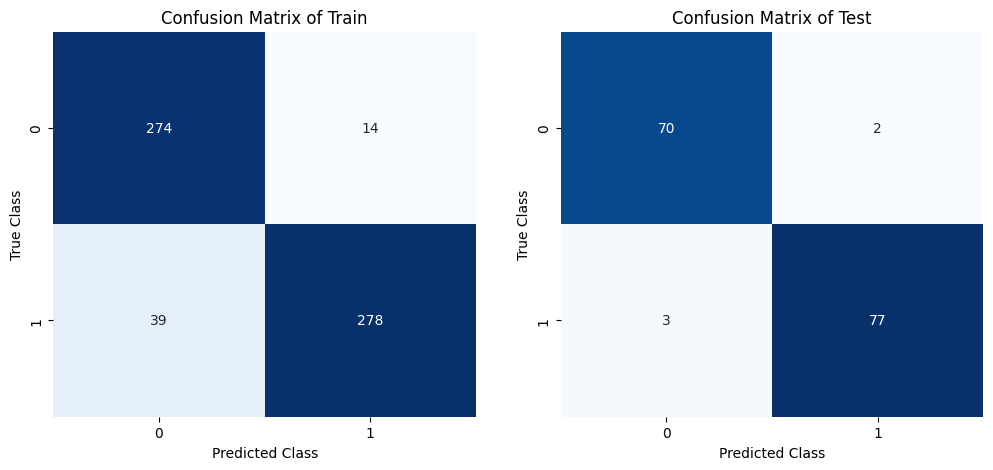

In [35]:
# 计算混淆矩阵并绘制
train_matrix = confusion_matrix(train_Y, clf_train)
test_matrix = confusion_matrix(test_Y, clf_test)

# 设定绘图风格
pall = sns.color_palette(['#73a2c6', '#f4777f'])
sns.set_palette(pall)

# 绘制训练集的混淆矩阵
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.heatmap(train_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Train")

# 绘制测试集的混淆矩阵
plt.subplot(1, 2, 2)
sns.heatmap(test_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")

# 保存混淆矩阵图像
plt.savefig("混淆矩阵_RF.svg", dpi=300)
plt.show()

#### 绘制ROC曲线

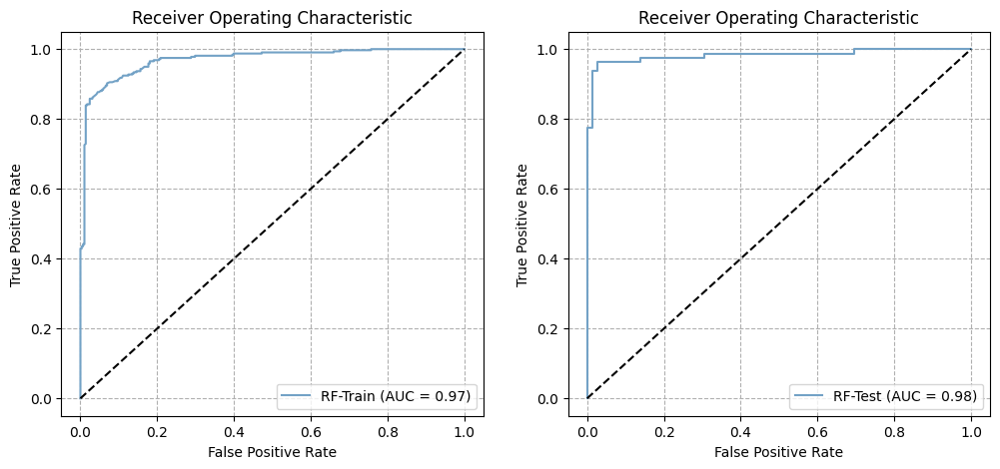

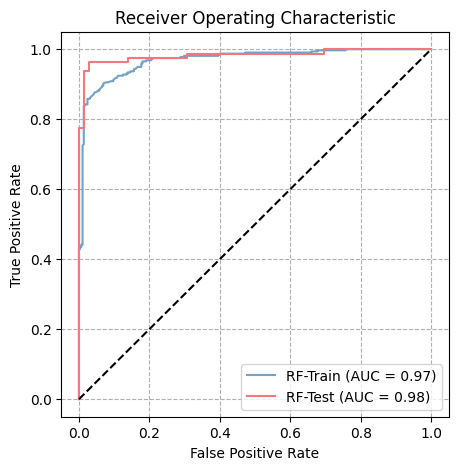

In [36]:
# 绘制训练集和测试集的ROC曲线
# 设置图形大小
plt.figure(figsize=(12, 5))

# 创建第一个子图，用于绘制训练集的ROC曲线
plt.subplot(1, 2, 1)
# 通过模型的predict_proba方法获取训练集上的预测概率，绘制训练集ROC图
y_pro_train = estimator.predict_proba(train_X)[:, 1]  # 计算概率
# 计算训练集的真阳性率（TPR）和假阳性率（FPR）
fpr_train, tpr_train, thresholds = roc_curve(train_Y, y_pro_train)
# 计算AUC值
roc_auc_train = auc(fpr_train, tpr_train)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')  # 设置标题
plt.plot(fpr_train, tpr_train, label='RF-Train (AUC = %0.2f)' % roc_auc_train) # 绘制ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 创建第二个子图，用于绘制测试集的ROC曲线
plt.subplot(1, 2, 2)
# 通过模型的predict_proba方法获取测试集上的预测概率
y_pro_test = estimator.predict_proba(test_X)[:, 1]
# 计算测试集的真阳性率（TPR）和假阳性率（FPR）
fpr_test, tpr_test, thresholds = roc_curve(test_Y, y_pro_test)
# 计算AUC值
roc_auc_test = auc(fpr_test, tpr_test)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')
plt.plot(fpr_test, tpr_test, label='RF-Test (AUC = %0.2f)' % roc_auc_test)
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 保存训练集和测试集的ROC曲线图
plt.savefig("ROC_RF.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的ROC组合图
plt.figure(figsize=(5, 5))
# 绘制 ROC 曲线
plt.plot(fpr_train, tpr_train, label='RF-Train (AUC = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, label='RF-Test (AUC = %0.2f)' % roc_auc_test)
# 绘制对角线
plt.plot([0, 1], [0, 1], '--', color='black')  #颜色
# 添加背景网格
plt.grid(True, linestyle='--')
# 设置标题和标签
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的ROC组合图
plt.savefig("ROC_RF_组合.svg", dpi=600)
plt.show()

#### 绘制PR_AUC曲线

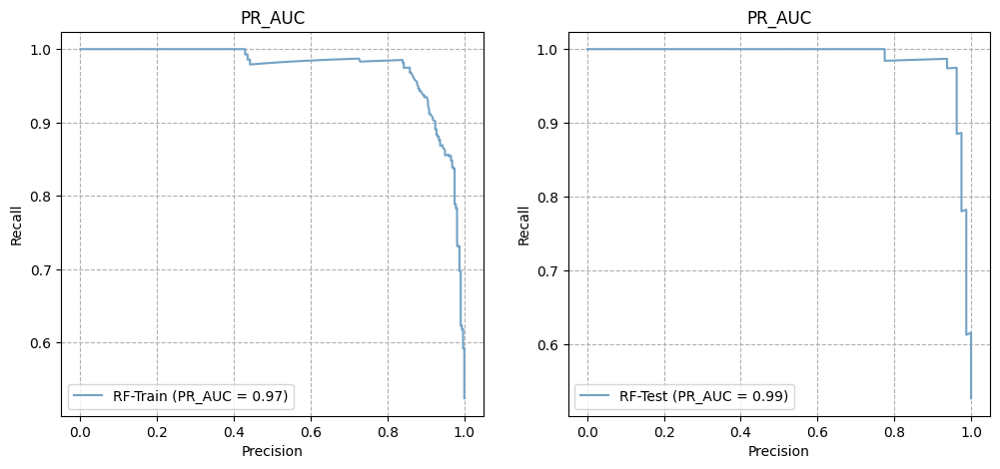

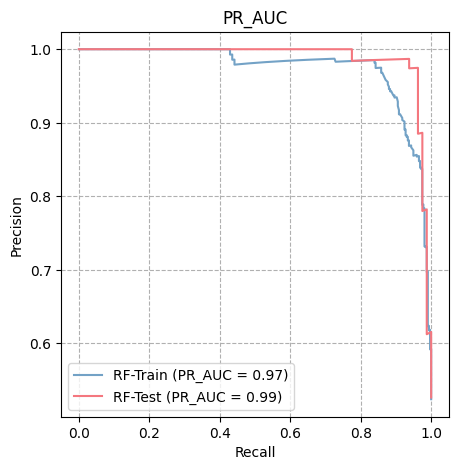

In [37]:
# 绘制PR_AUC曲线来评估模型在处理不平衡数据上的性能
# 设置绘图的大小
plt.figure(figsize=(12, 5))

# 训练集PR_AUC曲线
plt.subplot(1, 2, 1)
# 计算精确度和召回率
precision_train, recall_train, thresholds = precision_recall_curve(train_Y, y_pro_train, pos_label=1)
average_precision_train = average_precision_score(train_Y, y_pro_train)
pr_auc_train = metrics.auc(recall_train, precision_train)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_train, precision_train, label='RF-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 测试集PR_AUC曲线
plt.subplot(1, 2, 2)
# 计算精确度和召回率
precision_test, recall_test, thresholds = precision_recall_curve(test_Y, y_pro_test, pos_label=1)
average_precision_test = average_precision_score(test_Y, y_pro_test)
pr_auc_test = metrics.auc(recall_test, precision_test)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_test, precision_test, label='RF-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 保存训练集和测试集的PR_AUCC曲线图
plt.savefig("PR_RF.svg", dpi=600)
plt.show()


# 绘制训练集和测试集的PR_AUC组合图
plt.figure(figsize=(5, 5))
# 绘制训练集PR_AUC图
plt.plot(recall_train, precision_train, label='RF-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# 绘制测试集PR_AUC图
plt.plot(recall_test, precision_test, label='RF-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
# 设置标题和标签
plt.title('PR_AUC')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc="lower left") # 设置图例位置
plt.grid(True, linestyle='--') # 添加背景网格
# 设置图形边框
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的PR_AUC组合图
plt.savefig("PR_RF_组合.svg", dpi=600)
plt.show()

#### 模型评估与性能指标计算

In [38]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import average_precision_score

estimator = RF
estimator.fit(train_X, train_Y)
clf_test = estimator.predict(test_X)
acc_test = accuracy_score(test_Y,clf_test)
roc_test = roc_auc_score(test_Y,clf_test)
pre_test = precision_score(test_Y,clf_test)
rec_test = recall_score(test_Y,clf_test)
f1_test = f1_score(test_Y,clf_test)
mcc_test = matthews_corrcoef(test_Y,clf_test)
matrix_test = confusion_matrix(test_Y,clf_test)
ap_test = average_precision_score(test_Y,clf_test)

algorithm_model = [RF]
algorithm_name = ["RF"]
tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_test
Acc_data.loc[algorithm_name]  = acc_test
Recall_data.loc[algorithm_name] = rec_test
Precision_data.loc[algorithm_name] = pre_test
F1_data.loc[algorithm_name]  = f1_test
MCC_data.loc[algorithm_name]  = mcc_test
Ap_data.loc[algorithm_name]  = ap_test

Auc_data.to_csv("test_ROC.csv")
Acc_data.to_csv("test_ACC.csv")
Recall_data.to_csv("test_REC.csv")
Precision_data.to_csv("test_PRE.csv")
F1_data.to_csv("test_F1.csv")
MCC_data.to_csv("test_MCC.csv")
Ap_data.to_csv("test_AP.csv")

clf_train = estimator.predict(train_X)
acc_train = accuracy_score(train_Y,clf_train)
roc_train = roc_auc_score(train_Y,clf_train)
pre_train = precision_score(train_Y,clf_train)
rec_train = recall_score(train_Y,clf_train)
f1_train = f1_score(train_Y,clf_train)
mcc_train = matthews_corrcoef(train_Y,clf_train)
matrix_train = confusion_matrix(train_Y,clf_train)
ap_train = average_precision_score(train_Y,clf_train)

tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_train
Acc_data.loc[algorithm_name]  = acc_train
Recall_data.loc[algorithm_name] = rec_train
Precision_data.loc[algorithm_name] = pre_train
F1_data.loc[algorithm_name]  = f1_train
MCC_data.loc[algorithm_name]  = mcc_train
Ap_data.loc[algorithm_name]  = ap_train

Auc_data.to_csv("train_ROC.csv")
Acc_data.to_csv("train_ACC.csv")
Recall_data.to_csv("train_REC.csv")
Precision_data.to_csv("train_PRE.csv")
F1_data.to_csv("train_F1.csv")
MCC_data.to_csv("train_MCC.csv")
Ap_data.to_csv("train_AP.csv")

In [39]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用

# 设置训练集和测试集的特征和标签
X_train = train_X = x_mor_train
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test

# 初始化随机森林分类器，并设置参数
RF = RandomForestClassifier(
    random_state=0,  # 设置随机种子，确保结果可重复
    class_weight='balanced',  # 类别权重，处理不平衡数据集
    criterion='entropy',  # 评价分裂质量的标准，这里使用基尼不纯度
    max_features='log2',  # 寻找最佳分裂时考虑的特征数，这里使用log2
    bootstrap=False,  # 是否使用bootstrap样本
    max_depth=13,  # 树的最大深度
    min_samples_leaf=3,  # 叶节点最少样本数
    min_samples_split=9,  # 分裂内部节点所需的最小样本数
    n_estimators=165,  # 构建的树的数量
    oob_score=False  # 是否使用袋外样本来评估精度
)

# 训练模型
estimator = RF
estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="accuracy", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [40]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.8289473684210527
基模型显著性: 显著
打乱模型平均得分: 0.5095394736842106
打乱模型最高得分: 0.6842105263157895
显著的打乱次数/总打乱次数: 0/100 (0.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.506578947368421, z分数=-0.07454225477080458, p值=0.9405789202242307, 显著性=不显著
打乱模型 2: 得分=0.5328947368421053, z分数=0.24583084020159088, p值=0.8058131824622561, 显著性=不显著
打乱模型 3: 得分=0.47368421052631576, z分数=-0.4750086234862975, p值=0.6347808267780255, 显著性=不显著
打乱模型 4: 得分=0.40131578947368424, z分数=-1.3560346346603818, p值=0.17508814848869902, 显著性=不显著
打乱模型 5: 得分=0.4473684210526316, z分数=-0.7953817184586917, p值=0.42639149097812445, 显著性=不显著


#### 模型扰动-6个指标

Results saved to CSV file.
     accuracy    recall  precision   roc_auc       mcc  avg_precision  \
0    0.934211  0.896104   0.971831  0.934719  0.871250       0.923493   
1    0.407895  0.350649   0.402985  0.408658 -0.183963       0.470254   
2    0.559211  0.584416   0.562500  0.558874  0.117902       0.539260   
3    0.513158  0.519481   0.519481  0.513074  0.026147       0.513281   
4    0.394737  0.493506   0.417582  0.393420 -0.217418       0.462659   
..        ...       ...        ...       ...       ...            ...   
96   0.598684  0.597403   0.605263  0.598701  0.197386       0.565533   
97   0.355263  0.350649   0.360000  0.355325 -0.289351       0.455181   
98   0.460526  0.493506   0.469136  0.460087 -0.079993       0.488101   
99   0.526316  0.454545   0.538462  0.527273  0.055121       0.521071   
100  0.493421  0.597403   0.500000  0.492035 -0.016295       0.502649   

       zscore        pvalue  significancy  
0    5.268969  1.371924e-07          True  
1   -1.0

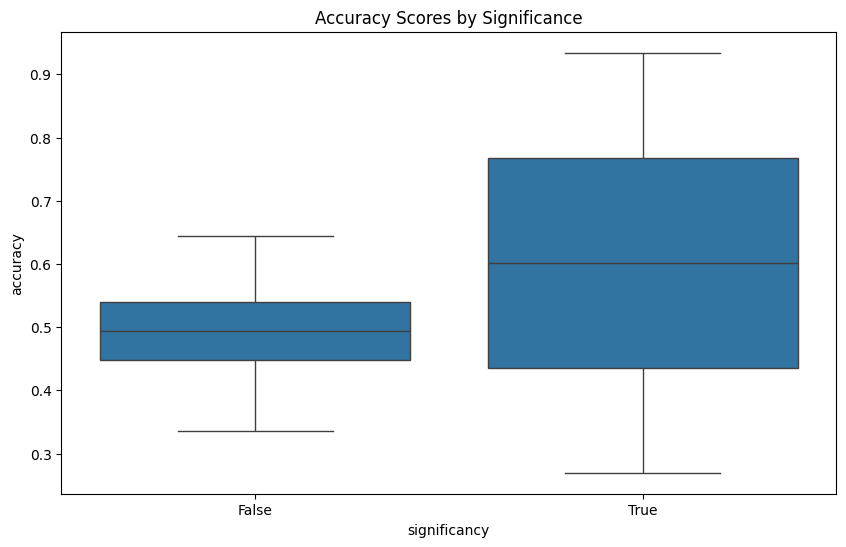

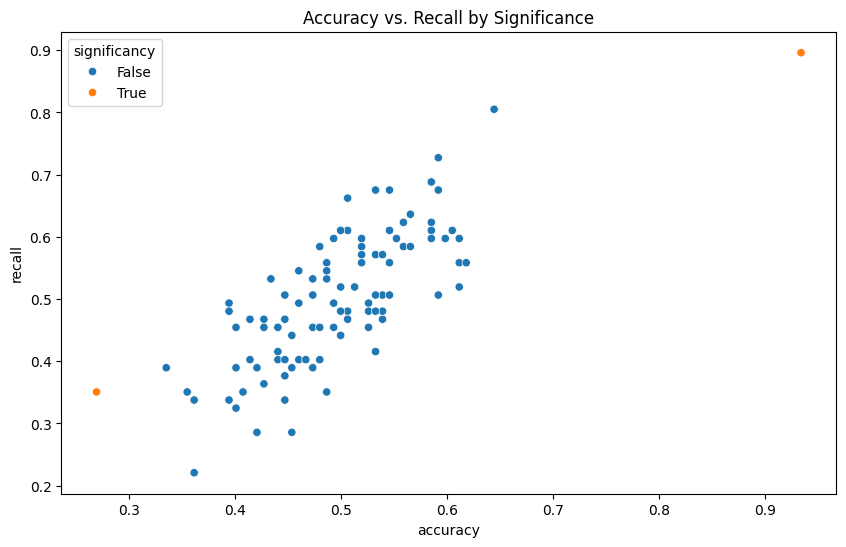

In [30]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
from sklearn.ensemble import RandomForestClassifier

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test



# 初始化随机森林分类器，并设置参数
RF = RandomForestClassifier(
    random_state=0,  # 设置随机种子，确保结果可重复
    class_weight='balanced',  # 类别权重，处理不平衡数据集
    criterion='entropy',  # 评价分裂质量的标准，这里使用基尼不纯度
    max_features='log2',  # 寻找最佳分裂时考虑的特征数，这里使用log2
    bootstrap=False,  # 是否使用bootstrap样本
    max_depth=13,  # 树的最大深度
    min_samples_leaf=3,  # 叶节点最少样本数
    min_samples_split=9,  # 分裂内部节点所需的最小样本数
    n_estimators=165,  # 构建的树的数量
    oob_score=False  # 是否使用袋外样本来评估精度
)


# 训练模型
RF.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=RF, iterations=100)


# 使用Scrambler的validate验证模型，假设以DataFrame形式返回了结果
results = scrambler.validate(
    X=X_train, 
    Y=Y_train_np, 
    scoring="accuracy", # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01,
    as_df=True  # 假设我们想直接以DataFrame形式获取结果
)

# 检查是否返回了DataFrame
if isinstance(results, pd.DataFrame):
    # 将DataFrame保存到CSV文件
    results.to_csv("validation_results.csv", index=False)
    print("Results saved to CSV file.")
    print(results)
else:
    # 如果返回的不是DataFrame，则进行解包
    accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results
    print("Accuracy Scores:", accuracy_scores)
    print("Recall Scores:", recall_scores)
    print("Precision Scores:", precision_scores)
    print("Z-Scores:", zscores)
    print("P-Values:", pvalues)
    print("Significances:", significances)


import pandas as pd
import numpy as np

# 随机提取10次模型扰动的结果
# 随机选取10次扰动的索引，排除第0行（原始模型的评分）
random_indices = np.random.choice(results.index[1:], size=10, replace=False)

# 使用iloc直接选择这些索引的行
selected_scrambled_metrics = results.iloc[random_indices]

# 保存选取的扰动模型指标到CSV
selected_scrambled_metrics.to_csv("selected_scrambled_metrics.csv", index=False)

# 假设results是已经通过validate方法获得的DataFrame，并且包含了原始模型的数据在第一行
original_model_data = results.iloc[0]

# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'Average Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        original_model_data['accuracy'],
        original_model_data['recall'],
        original_model_data['precision'],
        original_model_data['roc_auc'],
        original_model_data['mcc'],
        original_model_data['avg_precision'],
        original_model_data['zscore'],
        original_model_data['pvalue'],
        '显著' if original_model_data['significancy'] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

# 模型扰动结果可视化
import matplotlib.pyplot as plt
import seaborn as sns

# 筛选显著性结果
significant_results = results[results['significancy']]

# 绘制准确率的箱形图
plt.figure(figsize=(10, 6))
sns.boxplot(data=results, x='significancy', y='accuracy')
plt.title('Accuracy Scores by Significance')
plt.show()

# 绘制准确率和召回率的散点图
plt.figure(figsize=(10, 6))
sns.scatterplot(data=results, x='accuracy', y='recall', hue='significancy')
plt.title('Accuracy vs. Recall by Significance')
plt.show()

### XGB参数搜索

In [124]:
# 导入XGBoost相关库
import xgboost as xgb
from xgboost import plot_importance
from xgboost.sklearn import XGBClassifier

# 初始化XGBoost分类器，设置随机状态保证结果可重复，指定为二元逻辑回归任务
xgb = XGBClassifier(
    random_state=0,
    objective='binary:logistic'
)

# 记录开始时间
from time import time
begin_time = time()

# 设置超参数的搜索范围
learning_rate_range = [0.1]  # 学习率
n_estimators_range = [int(x) for x in np.linspace(start=10, stop=200, num=20)]  # 基学习器数量，这里是20个等差数列值
max_depth_range = [int(x) for x in np.linspace(3, 23, num=10)]  # 树的最大深度
min_child_weight_range = [i for i in range(1, 6, 2)]  # 最小子节点权重
gamma_range = [i/10.0 for i in range(0, 5)]  # 分裂节点所需的最小损失函数下降值
subsample_range = [i/10.0 for i in range(6, 10)]  # 每棵树随机抽样的比例
colsample_bytree_range = [i/10.0 for i in range(6, 10)]  # 建立树时对特征随机抽样的比例
reg_alpha_range = [0.1]  # L1正则化系数
reg_lambda_range = [0.1]  # L2正则化系数

# 将这些参数范围组合成一个字典
random_forest_hp_range = {
    'n_estimators': n_estimators_range,
    'max_depth': max_depth_range,
    'min_child_weight': min_child_weight_range,
    'gamma': gamma_range,
    'subsample': subsample_range,
    'colsample_bytree': colsample_bytree_range,
    'reg_alpha': reg_alpha_range,
    'reg_lambda': reg_lambda_range
}

# 输出超参数搜索范围
print(random_forest_hp_range)

{'n_estimators': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200], 'max_depth': [3, 5, 7, 9, 11, 14, 16, 18, 20, 23], 'min_child_weight': [1, 3, 5], 'gamma': [0.0, 0.1, 0.2, 0.3, 0.4], 'subsample': [0.6, 0.7, 0.8, 0.9], 'colsample_bytree': [0.6, 0.7, 0.8, 0.9], 'reg_alpha': [0.1], 'reg_lambda': [0.1]}


In [74]:
# 使用GridSearchCV进行网格搜索，cv参数定义了交叉验证的策略，n_jobs=-1表示使用所有CPU核心
estimator_all_roc = GridSearchCV(estimator=xgb,
                                 param_grid=random_forest_hp_range,
                                 cv=cv,  # cv是交叉验证策略
                                 n_jobs=-1,  # 使用所有CPU核心
                                 scoring="roc_auc",  # 使用AUC作为评分标准
                                 verbose=1)  # 显示搜索过程
estimator_all_roc.fit(X, Y)  # 训练模型并寻找最佳的超参数组合

# 记录结束时间并打印总共耗费的时间
end_time = time()
print({end_time - begin_time})

# 输出找到的最佳参数组合和对应的AUC得分
print(estimator_all_roc.best_params_)
print(estimator_all_roc.best_score_)

# 将GridSearchCV的结果保存为DataFrame，并将其导出为CSV文件
tmp = pd.DataFrame(estimator_all_roc.cv_results_)
df_fig = tmp[["mean_test_score", "params"]]
df_fig.to_csv("xgbtmp.csv", index=False)
df_fig = pd.read_csv("xgbtmp.csv") # 读取刚才保存的CSV文件

# 为DataFrame中的每个参数创建列，并填充搜索过的参数值，为每个超参数创建一个新列，并初始化为1
df_fig["colsample_bytree"] = 1
df_fig["gamma"] = 1
df_fig["max_depth"] = 1
df_fig["min_child_weight"]=1
df_fig["n_estimators"]=1
df_fig["reg_alpha"]=1
df_fig["reg_lambda"]=1
df_fig["subsample"]=1
# 逐行更新DataFrame中的参数值， 遍历每一行，将字符串形式的参数字典转换为字典对象，并填充上述创建的列
for i in range(0, df_fig.shape[0]):
    dict_tmp = df_fig['params'].iloc[i]
    dict_tmp = eval(dict_tmp)  # 将字符串表示的字典转换为字典
    # 以此类推，为其他参数创建列并填充值...
    df_fig["colsample_bytree"].iloc[i] = dict_tmp["colsample_bytree"]
    df_fig["gamma"].iloc[i] = dict_tmp["gamma"]
    df_fig["max_depth"].iloc[i] = dict_tmp["max_depth"]
    df_fig["min_child_weight"].iloc[i] = dict_tmp["min_child_weight"]
    df_fig["n_estimators"].iloc[i] = dict_tmp["n_estimators"]
    df_fig["reg_alpha"].iloc[i] = dict_tmp["reg_alpha"]
    df_fig["reg_lambda"].iloc[i] = dict_tmp["reg_lambda"]
    df_fig["subsample"].iloc[i] = dict_tmp["subsample"]
    # 更新DataFrame中的参数值...       
df_fig.head(50)  # 显示前50行搜索结果
df_fig.to_csv("xgb网格搜索结果.csv", index=False)  # 保存网格搜索结果为CSV文件
df_fig.describe()  # 输出网格搜索结果的描述性统计信息

Fitting 5 folds for each of 48000 candidates, totalling 240000 fits
{30857.0247900486}
{'colsample_bytree': 0.8, 'gamma': 0.0, 'max_depth': 9, 'min_child_weight': 1, 'n_estimators': 40, 'reg_alpha': 0.1, 'reg_lambda': 0.1, 'subsample': 0.8}
0.9451190476190476


,mean_test_score,colsample_bytree,gamma,max_depth,min_child_weight,n_estimators,reg_alpha,reg_lambda,subsample
count,48000.000000,48000.000000,48000.000000,48000.000000,48000.00000,48000.000000,4.800000e+04,4.800000e+04,48000.000000
mean,0.877460,0.750000,0.200000,12.600000,3.00000,105.000000,1.000000e-01,1.000000e-01,0.750000
std,0.036130,0.111805,0.141423,6.343567,1.63301,57.663414,1.387793e-17,1.387793e-17,0.111805
min,0.736935,0.600000,0.000000,3.000000,1.00000,10.000000,1.000000e-01,1.000000e-01,0.600000
25%,0.845595,0.675000,0.100000,7.000000,1.00000,57.500000,1.000000e-01,1.000000e-01,0.675000
50%,0.878810,0.750000,0.200000,12.500000,3.00000,105.000000,1.000000e-01,1.000000e-01,0.750000
75%,0.913929,0.825000,0.300000,18.000000,5.00000,152.500000,1.000000e-01,1.000000e-01,0.825000
max,0.945119,0.900000,0.400000,23.000000,5.00000,200.000000,1.000000e-01,1.000000e-01,0.900000


In [71]:
# 导入XGBoost的可视化工具和XGBClassifier分类器
from xgboost import plot_importance
from xgboost.sklearn import XGBClassifier

# 定义训练集和测试集
train_X = x_mor_train
train_Y = y_mor_train
test_X = x_mor_test
test_Y = y_mor_test

# 初始化XGBClassifier分类器，并设置超参数
xgb = XGBClassifier(
    random_state=0,  # 随机种子，保证可复现性
    objective='binary:logistic',  # 目标函数为二元逻辑回归
    colsample_bytree=0.8,  # 构造每棵树时列的采样率
    gamma=0.0,  # 叶子节点分裂所需的最小损失减少
    max_depth=9,  # 最大深度
    min_child_weight=1,  # 孩子节点所需的最小权重和
    n_estimators=40,  # 树的个数
    reg_alpha=0.1,  # L1正则化系数
    reg_lambda=0.1,  # L2正则化系数
    subsample=0.8  # 训练每棵树时样本的采样率
)

# 使用训练数据训练模型
estimator = xgb
estimator.fit(train_X, train_Y)

# 对训练集和测试集进行预测
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)

# 打印训练集和测试集的准确度
print(f"训练集准确度是{accuracy_score(train_Y, clf_train)}")
print(f"测试集准确度是{accuracy_score(test_Y, clf_test)}")

训练集准确度是0.968595041322314
测试集准确度是0.9210526315789473


#### 绘制混淆矩阵

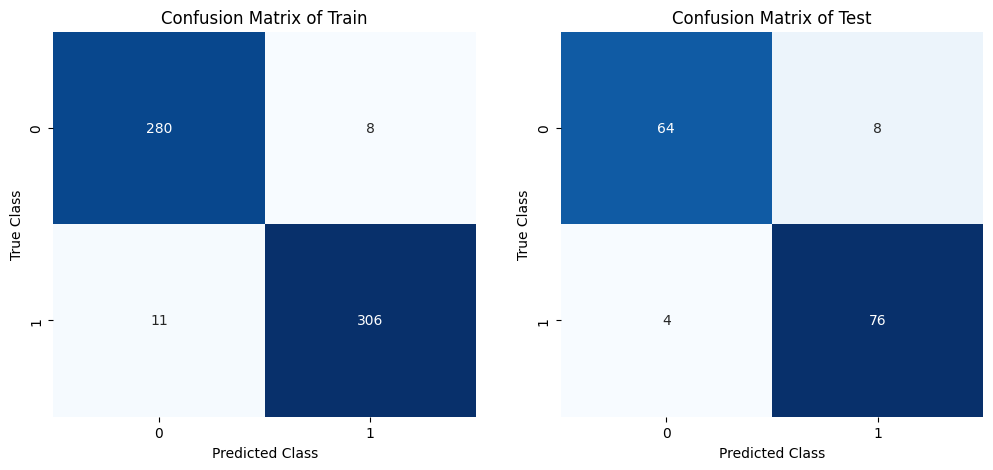

In [72]:
# 计算并打印混淆矩阵
train_matrix = confusion_matrix(train_Y, clf_train)
test_matrix = confusion_matrix(test_Y, clf_test)

# 修改配色方案
pall = sns.color_palette(['#73a2c6', '#f4777f'])
sns.set_palette(pall)

# 绘制训练集和测试集的混淆矩阵热图
plt.figure(figsize=(12, 5))

# 绘制训练集混淆矩阵热图
plt.subplot(1, 2, 1)
sns.heatmap(train_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Train")

# 绘制测试集混淆矩阵热图
plt.subplot(1, 2, 2)
sns.heatmap(test_matrix, annot=True, cmap="Blues", cbar=None, fmt="d")
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")

# 保存混淆矩阵图像
plt.savefig("混淆矩阵_XGB.svg", dpi=300)

# 显示图像
plt.show()

#### 绘制ROC曲线

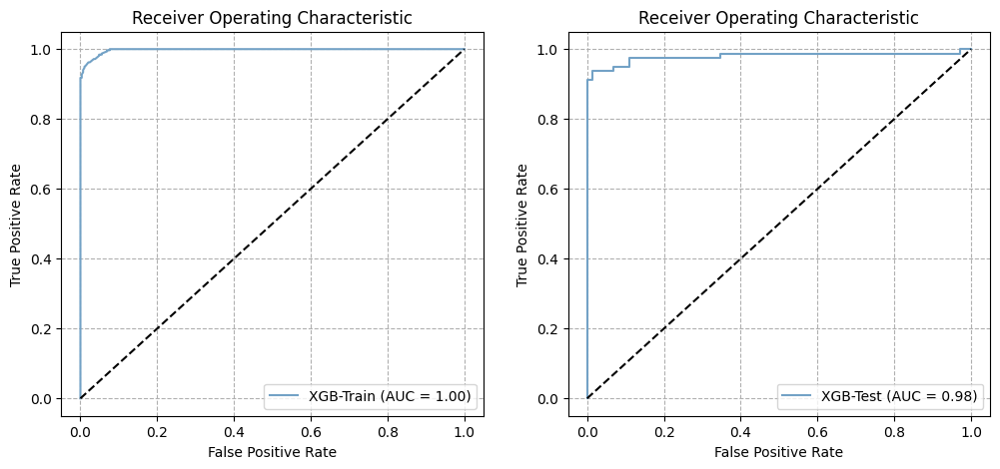

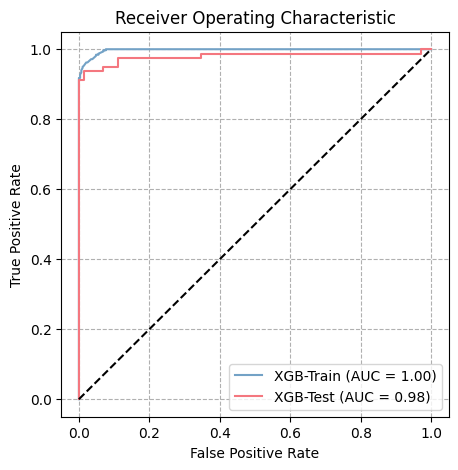

In [73]:
# 绘制ROC曲线，前面已经导入相关包
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc


# 设置图形大小
plt.figure(figsize=(12, 5))

# 创建第一个子图，用于绘制训练集的ROC曲线
plt.subplot(1, 2, 1)
# 通过模型的predict_proba方法获取训练集上的预测概率，绘制训练集ROC图
y_pro_train = estimator.predict_proba(train_X)[:, 1]
# 获取预测
y_pre_train = estimator.predict(train_X)
#计算训练集的真阳性率（TPR）和假阳性率（FPR）
fpr_train, tpr_train, thresholds = roc_curve(train_Y, y_pro_train)
# 计算AUC值
roc_auc_train = auc(fpr_train, tpr_train) # 也可以使用roc_auc_score(y_test, y_pro)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')  # 设置标题
plt.plot(fpr_train, tpr_train, label='XGB-Train (AUC = %0.2f)' % roc_auc_train) # 训练集ROC曲线
plt.plot([0, 1], [0, 1], '--',  color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 创建第二个子图，用于绘制测试集的ROC曲线
plt.subplot(1, 2, 2)
# 通过模型的predict_proba方法获取测试集上的预测概率
y_pro_test = estimator.predict_proba(test_X)[:, 1]
# 获取预测
y_pre_test = estimator.predict(test_X)
# 计算测试集的真阳性率（TPR）和假阳性率（FPR）
fpr_test, tpr_test, thresholds = roc_curve(test_Y, y_pro_test)
# 计算AUC值
roc_auc_test = auc(fpr_test, tpr_test)  #也可以使用roc_auc_score(y_test, y_pro)
# 绘制ROC曲线
plt.title('Receiver Operating Characteristic')
plt.plot(fpr_test, tpr_test, label='XGB-Test (AUC = %0.2f)' % roc_auc_test) # 测试集ROC曲线
plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower right') # 设置图例位置
# 添加横纵坐标标题
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True) # 显示顶部边框
ax.spines['right'].set_visible(True) # 显示右侧边框

# 保存训练集和测试集的ROC曲线图
plt.savefig("ROC_XGB.svg", dpi = 600)
plt.show()


# 绘制训练集和测试集的ROC组合图
plt.figure(figsize=(5, 5))
# 绘制 ROC 曲线
plt.plot(fpr_train, tpr_train, label='XGB-Train (AUC = %0.2f)' % roc_auc_train)
plt.plot(fpr_test, tpr_test, label='XGB-Test (AUC = %0.2f)' % roc_auc_test)
# 绘制对角线
plt.plot([0, 1], [0, 1], '--', color='black')  #颜色
# 添加背景网格
plt.grid(True, linestyle='--')
# 设置标题和标签
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的ROC组合图
plt.savefig("ROC_XGB_组合.svg", dpi=600)
plt.show()

#### 绘制PR_AUC曲线

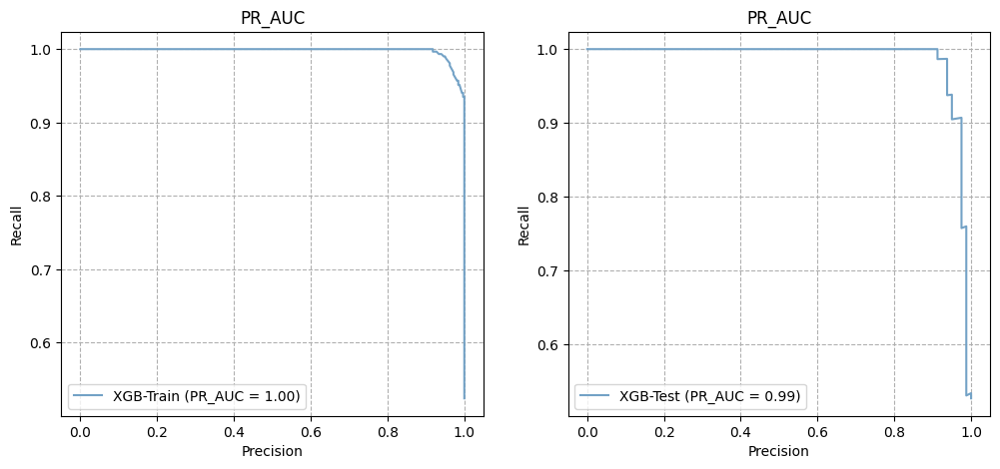

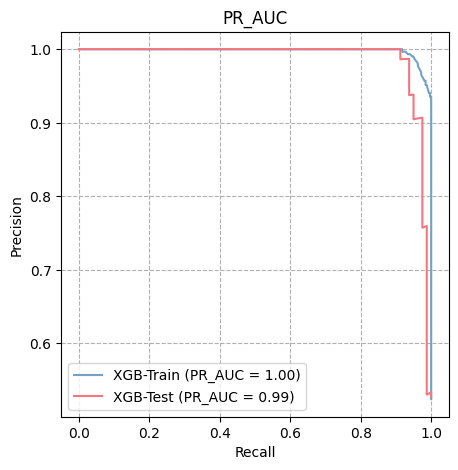

In [74]:
# 绘制PR（Precision-Recall）曲线
import matplotlib.pyplot as plt # 确保导入了matplotlib.pyplot
import sklearn as sk
from sklearn import metrics
from sklearn.metrics import precision_recall_curve, PrecisionRecallDisplay, average_precision_score, auc
import warnings
warnings.filterwarnings("ignore")

estimator.fit(train_X, train_Y)
clf_train = estimator.predict(train_X)
clf_test = estimator.predict(test_X)

# 设置绘图的大小
fig = plt.figure(figsize=(12,5))

# 训练集PR_AUC曲线
plt.subplot(1, 2, 1)
# 通过模型预测训练集上的概率
y_pro_train = estimator.predict_proba(train_X)[:, 1]
# 获取预测
y_pre_train = estimator.predict(train_X)
# 计算精确度和召回率
precision_train, recall_train, thresholds = precision_recall_curve(train_Y, y_pro_train, pos_label=1)
average_precision_train = average_precision_score(train_Y, y_pro_train)
pr_auc_train = metrics.auc(recall_train, precision_train)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_train, precision_train, label='XGB-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left') # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 测试集PR_AUC曲线
plt.subplot(1, 2, 2)
# 通过模型预测测试集上的概率
y_pro_train = estimator.predict_proba(test_X)[:, 1]
# 获取预测
y_pre_train = estimator.predict(test_X)
# 计算精确度和召回率
precision_test, recall_test, thresholds = precision_recall_curve(test_Y, y_pro_test, pos_label=1)
average_precision_test = average_precision_score(test_Y, y_pro_test)
pr_auc_test = metrics.auc(recall_test, precision_test)
# 绘制PR_AUC曲线
plt.title('PR_AUC')
plt.plot(recall_test, precision_test, label='XGB-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
plt.grid(True, linestyle='--') # 添加背景网格
plt.legend(loc='lower left')  # 设置图例位置
# 添加横纵坐标标题
plt.ylabel('Recall')
plt.xlabel('Precision')
# 设置图形边框
ax = plt.gca()
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)

# 保存训练集和测试集的PR_AUCC曲线图
plt.savefig("PR_XGB.svg", dpi = 600)
plt.show()


# 绘制训练集和测试集的PR_AUC组合图
plt.figure(figsize=(5, 5))
# 绘制训练集PR_AUC图
plt.plot(recall_train, precision_train, label='XGB-Train (PR_AUC = {:.2f})'.format(pr_auc_train))
# 绘制测试集PR_AUC图
plt.plot(recall_test, precision_test, label='XGB-Test (PR_AUC = {:.2f})'.format(pr_auc_test))
# plt.plot([0, 1], [0, 1], '--', color='black') # 绘制对角线
# 设置标题和标签
plt.title('PR_AUC')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend(loc="lower left") # 设置图例位置
plt.grid(True, linestyle='--') # 添加背景网格
# 设置图形边框
plt.gca().spines['top'].set_visible(True)
plt.gca().spines['right'].set_visible(True)
# 保存训练集和测试集的PR_AUC组合图
plt.savefig("PR_XGB_组合.svg", dpi=600)
plt.show()

#### 模型评估与性能指标计算

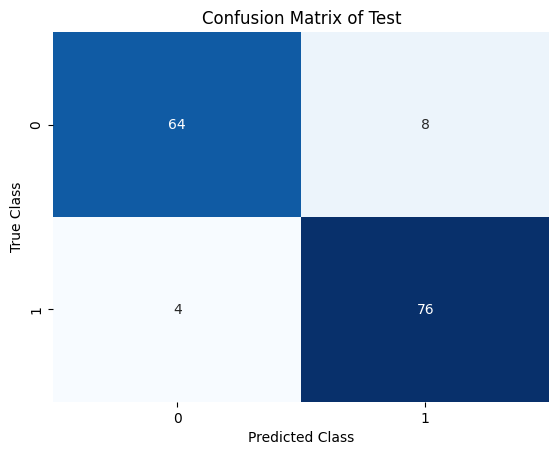

In [75]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import average_precision_score

estimator = xgb
estimator.fit(train_X, train_Y)
clf_test = estimator.predict(test_X)
acc_test = accuracy_score(test_Y,clf_test)
roc_test = roc_auc_score(test_Y,clf_test)
pre_test = precision_score(test_Y,clf_test)
rec_test = recall_score(test_Y,clf_test)
f1_test = f1_score(test_Y,clf_test)
mcc_test = matthews_corrcoef(test_Y,clf_test)
matrix_test = confusion_matrix(test_Y,clf_test)
ap_test = average_precision_score(test_Y,clf_test)

algorithm_model = [xgb]
algorithm_name = ["XGB"]
tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_test
Acc_data.loc[algorithm_name]  = acc_test
Recall_data.loc[algorithm_name] = rec_test
Precision_data.loc[algorithm_name] = pre_test
F1_data.loc[algorithm_name]  = f1_test
MCC_data.loc[algorithm_name]  = mcc_test
Ap_data.loc[algorithm_name]  = ap_test

Auc_data.to_csv("test_ROC.csv")
Acc_data.to_csv("test_ACC.csv")
Recall_data.to_csv("test_REC.csv")
Precision_data.to_csv("test_PRE.csv")
F1_data.to_csv("test_F1.csv")
MCC_data.to_csv("test_MCC.csv")
Ap_data.to_csv("test_AP.csv")

sns.heatmap(matrix_test, annot=True, cmap="Blues", cbar=None,
            fmt="d")  #cbar=None 就会不显示色条,fmt="d"确保中间现实数字
plt.ylabel('True Class')
plt.xlabel('Predicted Class')
plt.title("Confusion Matrix of Test")
plt.savefig("混淆矩阵test_XGB.svg", dpi = 300)
#plt.show()
clf_train = estimator.predict(train_X)
#rf_test = estimator.predict(test_X)
acc_train = accuracy_score(train_Y,clf_train)
roc_train = roc_auc_score(train_Y,clf_train)
pre_train = precision_score(train_Y,clf_train)
rec_train = recall_score(train_Y,clf_train)
f1_train = f1_score(train_Y,clf_train)
mcc_train = matthews_corrcoef(train_Y,clf_train)
matrix_train = confusion_matrix(train_Y,clf_train)
ap_train = average_precision_score(train_Y,clf_train)

tmp_1 = np.zeros((1,2))
Auc_data = pd.DataFrame(tmp_1,index=algorithm_name,columns=range(2))
tmp_2 = np.zeros((1,2))
Acc_data = pd.DataFrame(tmp_2,index=algorithm_name,columns=range(2))
tmp_3 = np.zeros((1,2))
Recall_data = pd.DataFrame(tmp_3,index=algorithm_name,columns=range(2))  
tmp_4 = np.zeros((1,2))
Precision_data = pd.DataFrame(tmp_4,index=algorithm_name,columns=range(2)) 
tmp_5 = np.zeros((1,2))
F1_data = pd.DataFrame(tmp_5,index=algorithm_name,columns=range(2))
tmp_6 = np.zeros((1,2))
MCC_data = pd.DataFrame(tmp_6,index=algorithm_name,columns=range(2))
tmp_7 = np.zeros((1,2))
Ap_data = pd.DataFrame(tmp_7,index=algorithm_name,columns=range(2))

Auc_data.loc[algorithm_name]  = roc_train
Acc_data.loc[algorithm_name]  = acc_train
Recall_data.loc[algorithm_name] = rec_train
Precision_data.loc[algorithm_name] = pre_train
F1_data.loc[algorithm_name]  = f1_train
MCC_data.loc[algorithm_name]  = mcc_train
Ap_data.loc[algorithm_name]  = ap_train

Auc_data.to_csv("train_ROC.csv")
Acc_data.to_csv("train_ACC.csv")
Recall_data.to_csv("train_REC.csv")
Precision_data.to_csv("train_PRE.csv")
F1_data.to_csv("train_F1.csv")
MCC_data.to_csv("train_MCC.csv")
Ap_data.to_csv("train_AP.csv")

In [76]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用


# 设置训练集和测试集的特征和标签
X_train = train_X = x_mor_train
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test

# 初始化XGBClassifier分类器，并设置超参数
xgb = XGBClassifier(
    random_state=0,  # 随机种子，保证可复现性
    objective='binary:logistic',  # 目标函数为二元逻辑回归
    colsample_bytree=0.8,  # 构造每棵树时列的采样率
    gamma=0.0,  # 叶子节点分裂所需的最小损失减少
    max_depth=9,  # 最大深度
    min_child_weight=1,  # 孩子节点所需的最小权重和
    n_estimators=40,  # 树的个数
    reg_alpha=0.1,  # L1正则化系数
    reg_lambda=0.1,  # L2正则化系数
    subsample=0.8  # 训练每棵树时样本的采样率
)

# 训练模型
estimator = xgb
estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="accuracy", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [77]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.75
基模型显著性: 显著
打乱模型平均得分: 0.49611842105263165
打乱模型最高得分: 0.6578947368421053
显著的打乱次数/总打乱次数: 0/100 (0.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.4605263157894737, z分数=-0.5876877654654031, p值=0.5567418890719259, 显著性=不显著
打乱模型 2: 得分=0.48026315789473684, z分数=-0.28329564078845054, p值=0.7769502186213365, 显著性=不显著
打乱模型 3: 得分=0.4473684210526316, z分数=-0.7906158485833712, p值=0.42916819559890507, 显著性=不显著
打乱模型 4: 得分=0.5789473684210527, z分数=1.2386649825963123, p值=0.215469591919757, 显著性=不显著
打乱模型 5: 得分=0.47368421052631576, z分数=-0.384759682347435, p值=0.7004154725797054, 显著性=不显著


In [78]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用


# 设置训练集和测试集的特征和标签
X_train = train_X = x_mor_train
Y_train = train_Y = y_mor_train
X_test = test_X = x_mor_test
Y_test = test_Y = y_mor_test

# 初始化XGBClassifier分类器，并设置超参数
xgb = XGBClassifier(
    random_state=0,  # 随机种子，保证可复现性
    objective='binary:logistic',  # 目标函数为二元逻辑回归
    colsample_bytree=0.8,  # 构造每棵树时列的采样率
    gamma=0.0,  # 叶子节点分裂所需的最小损失减少
    max_depth=9,  # 最大深度
    min_child_weight=1,  # 孩子节点所需的最小权重和
    n_estimators=40,  # 树的个数
    reg_alpha=0.1,  # L1正则化系数
    reg_lambda=0.1,  # L2正则化系数
    subsample=0.8  # 训练每棵树时样本的采样率
)

# 训练模型
estimator = xgb
estimator.fit(X_train, Y_train)

# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=DT, iterations=100)

# 使用Scrambler验证模型
scores, zscores, pvalues, significances = scrambler.validate(
    X, Y, 
    scoring="roc_auc", 
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01
)

In [79]:
import numpy as np  # 用于数值运算和数据操作
# 打印基模型的得分和显著性
print(f"基模型得分: {scores[0]}")
print(f"基模型显著性: {'显著' if significances[0] else '不显著'}")

# 打印打乱模型的平均得分、最高得分和显著性比例
average_scrambled_score = np.mean(scores[1:])
max_scrambled_score = np.max(scores[1:])
significant_scrambles = np.sum(significances[1:])
total_scrambles = len(significances[1:])

print(f"打乱模型平均得分: {average_scrambled_score}")
print(f"打乱模型最高得分: {max_scrambled_score}")
print(f"显著的打乱次数/总打乱次数: {significant_scrambles}/{total_scrambles} ({significant_scrambles/total_scrambles*100:.2f}%)")

# 可选：展示具体的得分、z分数和p值
# 为了简洁，这里只展示前5个打乱模型的结果
print("\n前5个打乱模型的得分、z分数和p值:")
for i in range(1, 6):
    print(f"打乱模型 {i}: 得分={scores[i]}, z分数={zscores[i]}, p值={pvalues[i]}, 显著性={'显著' if significances[i] else '不显著'}")

基模型得分: 0.8513958730709206
基模型显著性: 显著
打乱模型平均得分: 0.4940697069533554
打乱模型最高得分: 0.663429859545691
显著的打乱次数/总打乱次数: 0/100 (0.00%)

前5个打乱模型的得分、z分数和p值:
打乱模型 1: 得分=0.455349401768684, z分数=-0.5448585743577684, p值=0.5858507893769056, 显著性=不显著
打乱模型 2: 得分=0.41043870296514656, z分数=-1.1239174614393028, p值=0.2610480429087709, 显著性=不显著
打乱模型 3: 得分=0.44884688746315243, z分数=-0.6286991468116595, p值=0.5295460367945904, 显著性=不显著
打乱模型 4: 得分=0.4634125195075429, z分数=-0.44089626451494607, p值=0.6592880980975016, 显著性=不显著
打乱模型 5: 得分=0.5013005028611063, z分数=0.04761480431638614, p值=0.9620232332739891, 显著性=不显著


#### 模型扰动-6个指标

Results saved to CSV file.
     accuracy    recall  precision   roc_auc       mcc  avg_precision  \
0    0.901316  0.883117   0.918919  0.901558  0.803326       0.870723   
1    0.519737  0.493506   0.527778  0.520087  0.040225       0.517041   
2    0.460526  0.532468   0.471264  0.459567 -0.081719       0.487775   
3    0.546053  0.597403   0.547619  0.545368  0.091235       0.531096   
4    0.447368  0.480519   0.456790  0.446926 -0.106368       0.482654   
..        ...       ...        ...       ...       ...            ...   
96   0.421053  0.493506   0.436782  0.420087 -0.161514       0.472134   
97   0.506579  0.571429   0.511628  0.505714  0.011528       0.509464   
98   0.493421  0.519481   0.500000  0.493074 -0.013871       0.503161   
99   0.473684  0.519481   0.481928  0.473074 -0.054078       0.493773   
100  0.519737  0.571429   0.523810  0.519048  0.038305       0.516425   

       zscore        pvalue  significancy  
0    6.422551  1.340094e-10          True  
1    0.2

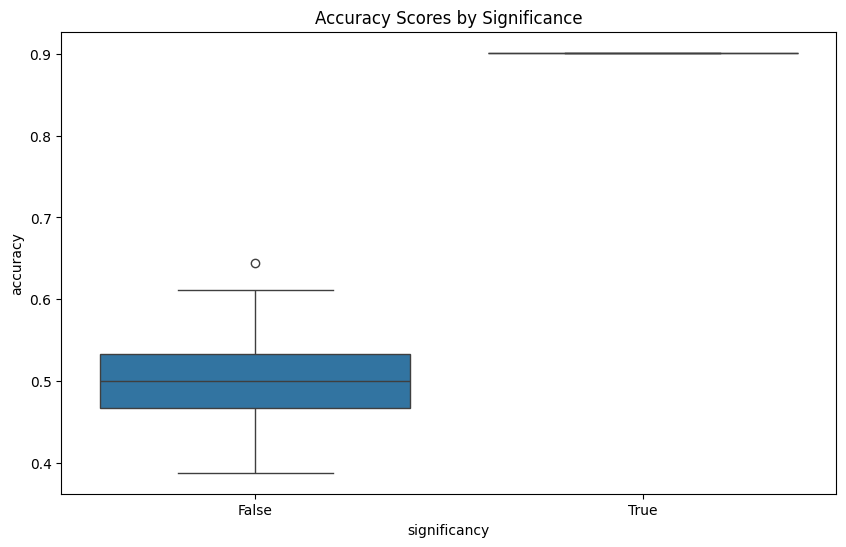

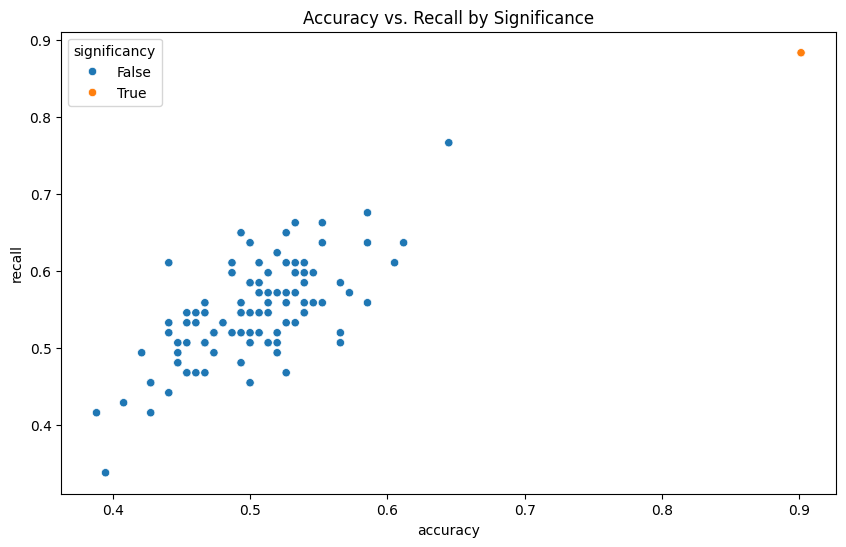

In [31]:
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用
import xgboost as xgb
from xgboost import plot_importance
from xgboost.sklearn import XGBClassifier

# 设置训练集和测试集的特征和标签
X_train = x_mor_train
Y_train = y_mor_train
X_test = x_mor_test
Y_test = y_mor_test

# 初始化XGBClassifier分类器，并设置超参数
xgb = XGBClassifier(
    random_state=0,  # 随机种子，保证可复现性
    objective='binary:logistic',  # 目标函数为二元逻辑回归
    colsample_bytree=0.8,  # 构造每棵树时列的采样率
    gamma=0.0,  # 叶子节点分裂所需的最小损失减少
    max_depth=9,  # 最大深度
    min_child_weight=1,  # 孩子节点所需的最小权重和
    n_estimators=40,  # 树的个数
    reg_alpha=0.1,  # L1正则化系数
    reg_lambda=0.1,  # L2正则化系数
    subsample=0.8  # 训练每棵树时样本的采样率
)

# 训练模型
xgb.fit(X_train, Y_train)

# 确保X和Y被正确赋值为训练数据集和标签
# 转换Y_train为numpy数组以避免KeyError
Y_train_np = Y_train.values.ravel()

# 确保X和Y被正确赋值为训练数据集和标签
X = X_train
Y = Y_train_np  # 使用Y_train转换为numpy数组的版本

# 初始化Scrambler实例
scrambler = Scrambler(model=xgb, iterations=100)


# 使用Scrambler的validate验证模型，假设以DataFrame形式返回了结果
results = scrambler.validate(
    X=X_train, 
    Y=Y_train_np, 
    scoring="accuracy", # 注意: 'scoring'参数在当前实现中不直接影响结果，因为返回了多个评价指标
    cross_val_score_aggregator="mean", 
    pvalue_threshold=0.01,
    as_df=True  # 假设我们想直接以DataFrame形式获取结果
)

# 检查是否返回了DataFrame
if isinstance(results, pd.DataFrame):
    # 将DataFrame保存到CSV文件
    results.to_csv("validation_results.csv", index=False)
    print("Results saved to CSV file.")
    print(results)
else:
    # 如果返回的不是DataFrame，则进行解包
    accuracy_scores, recall_scores, precision_scores, zscores, pvalues, significances = results
    print("Accuracy Scores:", accuracy_scores)
    print("Recall Scores:", recall_scores)
    print("Precision Scores:", precision_scores)
    print("Z-Scores:", zscores)
    print("P-Values:", pvalues)
    print("Significances:", significances)


import pandas as pd
import numpy as np

# 随机提取10次模型扰动的结果
# 随机选取10次扰动的索引，排除第0行（原始模型的评分）
random_indices = np.random.choice(results.index[1:], size=10, replace=False)

# 使用iloc直接选择这些索引的行
selected_scrambled_metrics = results.iloc[random_indices]

# 保存选取的扰动模型指标到CSV
selected_scrambled_metrics.to_csv("selected_scrambled_metrics.csv", index=False)

# 假设results是已经通过validate方法获得的DataFrame，并且包含了原始模型的数据在第一行
original_model_data = results.iloc[0]

# 创建一个DataFrame来存储原始模型指标
original_model_metrics_df = pd.DataFrame({
    'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'Average Precision', 'Z-Score', 'P-Value', 'Significance'],
    'Value': [
        original_model_data['accuracy'],
        original_model_data['recall'],
        original_model_data['precision'],
        original_model_data['roc_auc'],
        original_model_data['mcc'],
        original_model_data['avg_precision'],
        original_model_data['zscore'],
        original_model_data['pvalue'],
        '显著' if original_model_data['significancy'] else '不显著'
    ]
})

# 将DataFrame保存到CSV文件
original_model_metrics_df.to_csv("original_model_metrics.csv", index=False)

# 模型扰动结果可视化
import matplotlib.pyplot as plt
import seaborn as sns

# 筛选显著性结果
significant_results = results[results['significancy']]

# 绘制准确率的箱形图
plt.figure(figsize=(10, 6))
sns.boxplot(data=results, x='significancy', y='accuracy')
plt.title('Accuracy Scores by Significance')
plt.show()

# 绘制准确率和召回率的散点图
plt.figure(figsize=(10, 6))
sns.scatterplot(data=results, x='accuracy', y='recall', hue='significancy')
plt.title('Accuracy vs. Recall by Significance')
plt.show()